# Busqueda de Periodicidad

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import astropy

c:\Users\juang\anaconda3\lib\site-packages\pandas\core\computation\expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
c:\Users\juang\anaconda3\lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.2' currently installed).
  from pandas.core import (


In [2]:
from astropy.timeseries import LombScargle
from scipy.signal import find_peaks

In [3]:
from glob import glob
glob("*")

['10_10000',
 '1_10000',
 '2_10000',
 '3_10000',
 '4_10000',
 '5_10000',
 '6_10000',
 '7_10000',
 '8_10000',
 '9_10000',
 'Candidatas 1',
 'Candidatas Comprimido.zip',
 'Candidatas2',
 'Candidatas3',
 'Candidatas_Finales',
 'Estrellas Variables.ipynb',
 'MUESTRA.ESTRELLAS.VARIABLES',
 'Periodicidad.ipynb']

In [4]:
def phi(t,t0,p):
    return (((t-t0)/p)-int((t-t0)/p))

def Fases(Intensidad,periodo,AñoJuliano):
    Años=[]
    t0=AñoJuliano[0]
    for i in AñoJuliano:
        Años.append(phi(i,t0,periodo))
    Años=np.array(Años)
    return [Años,Intensidad]

In [183]:
def find_matching_indices(list_of_strings, list_of_tuples):
    matching_indices = []
    for i, string in enumerate(list_of_strings):
        for tup in list_of_tuples:
            if string == tup[0]:
                matching_indices.append(i)
                break  # Once a match is found, no need to check further tuples
    return matching_indices

In [185]:
def export_csv(numpy_array, file_name):
    np.savetxt(r"C:\Users\juang\Documents\Tareas JD\Universidad\Materias\7 Semestre\Cumulos Abiertos\Estrellas Variables\Datos_sin_analizar_Vista\Candidatas_Finales\%s.txt" % file_name, numpy_array, delimiter='      ', fmt= '%s')

In [14]:
archivos=glob("MUESTRA.ESTRELLAS.VARIABLES/*.txt")
Tiempos=[]
Intensidad=[]
Estrellas=[]
Error=[]
n=len(archivos)
i=0
while(i<n):
    Datos=np.loadtxt(archivos[i])
    Estrellas.append(archivos[i])
    Tiempos.append(Datos[:,0])
    Intensidad.append(Datos[:,1])
    Error.append(Datos[:,2])
    i=i+1

In [16]:
len(Tiempos),len(archivos)

(9, 9)

[15.475207944365632]
[1309.2025920933327]
[14.514441154028075]
[15.117812841724396]


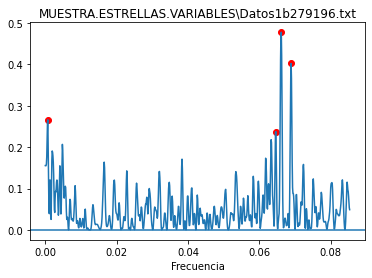

[36.98312407043312]
[12.220310442688232]
[12.312250082382437]
[11.837274792887275]


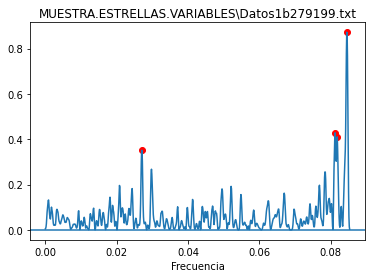

[21.893019934671116]
[17.80420569483227]
[18.301993365703627]
[19.271873288910687]


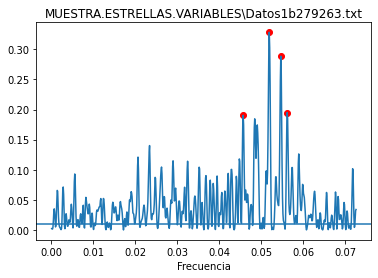

[20.737105471383305]
[25.14473608373879]
[33.569297233162374]
[26.938324940192032]


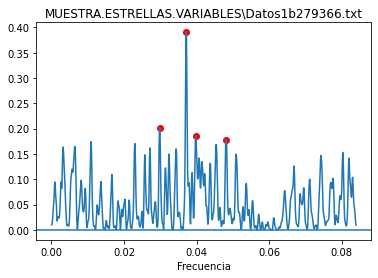

[105.01625070267376]
[14.979434692143393]
[16.29712770240663]
[15.622942626412081]


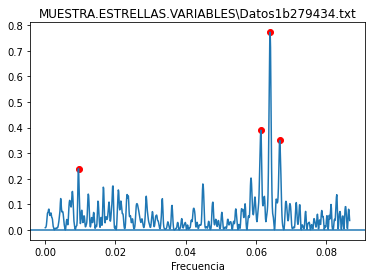

[13.441505052292943]
[19.19651894565004]
[20.22455085623068]
[21.36892152491838]


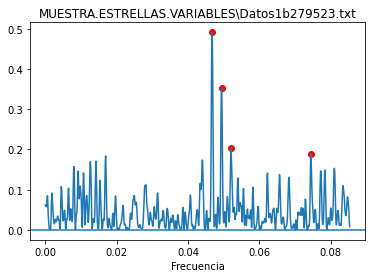

[26.938324940192032]
[13.957383711016337]
[13.295896331347318]
[25.08050942707534]


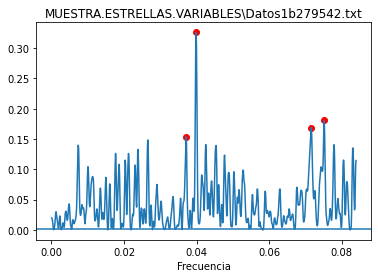

[15.475207944365632]
[13.552821864320212]
[14.776552958164025]
[14.138256934053269]


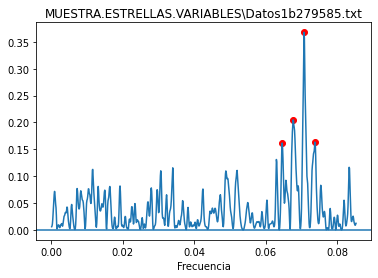

[23.130787846171955]
[15.875536686661267]
[36.03309886495411]
[269.0142312520547]


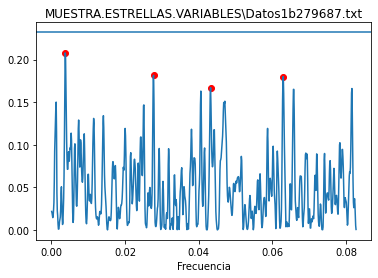

In [17]:
periodos=[]
pre=[]
lombs=[]
for i in range(len(Tiempos)): 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    frequency, power= LombScargle(t, y).autopower()
    fap=LombScargle(Tiempos[i], Intensidad[i], Error[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[i][1])
    powerpeaks=lombs[i][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    for j in range(4):
        indice1=np.where(lombs[i][1]==pp[j])[0]
        plt.scatter(lombs[i][0][indice1],lombs[i][1][indice1],c="r")
        Periodo1=1/lombs[i][0][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        print(Periodo1)
        per.append(Periodo1)
    periodos.append(per)

    plt.plot(lombs[i][0],lombs[i][1])
    plt.axhline(lombs[i][2])
    plt.xlabel("Frecuencia")
    plt.title(archivos[i])
    plt.show()



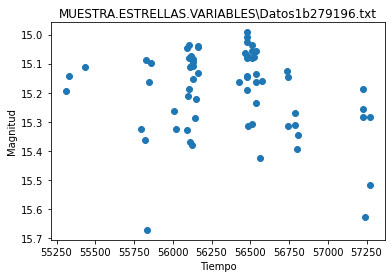

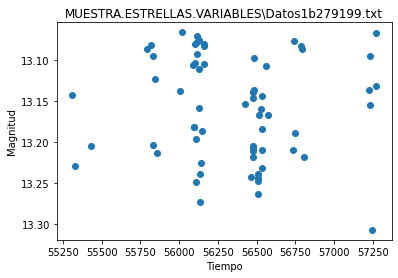

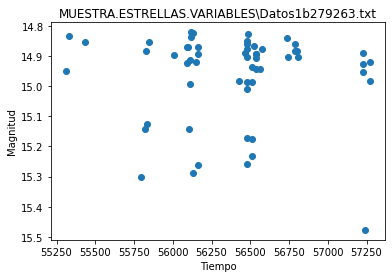

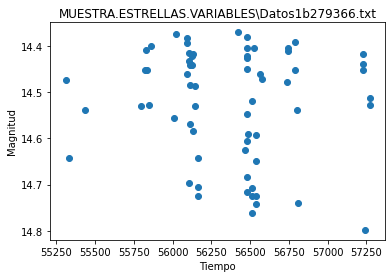

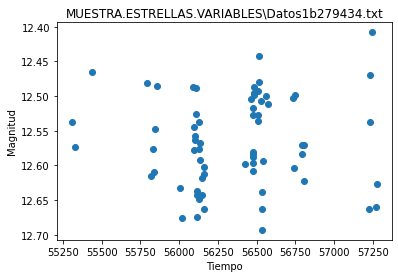

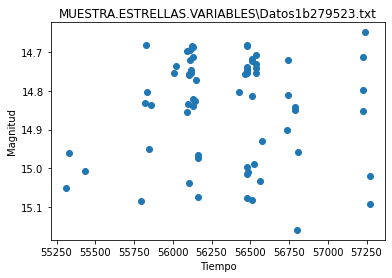

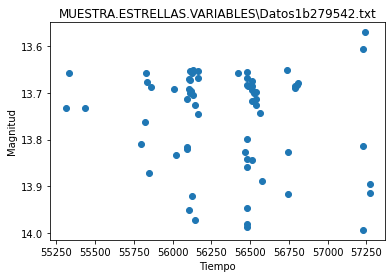

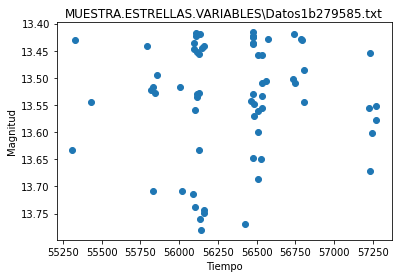

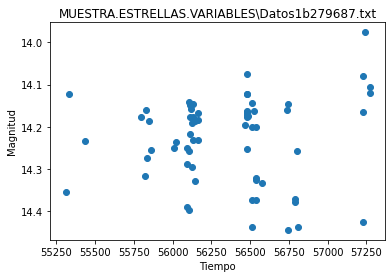

In [18]:
for i in range(len(Tiempos)): 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    #print(1/periodos[i])
    plt.scatter(t, y)
    plt.xlabel("Tiempo")
    plt.ylabel("Magnitud")
    plt.gca().invert_yaxis()
    plt.title(archivos[i])
    plt.show()

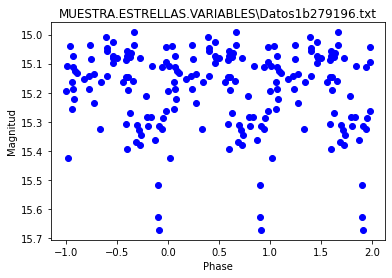

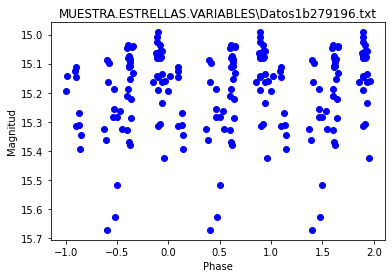

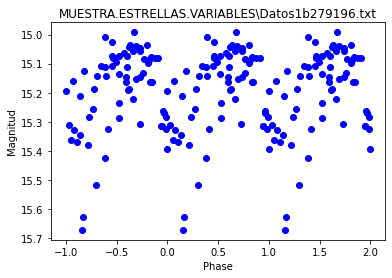

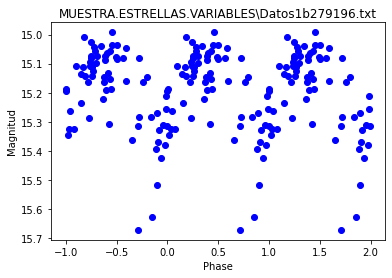

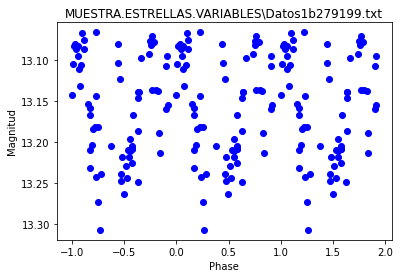

...

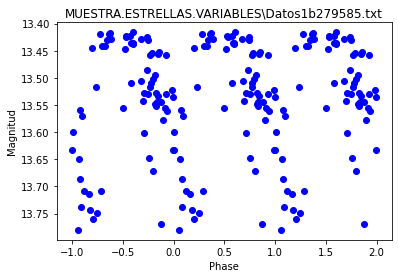

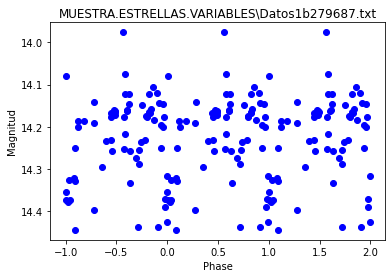

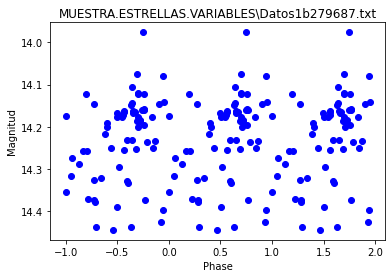

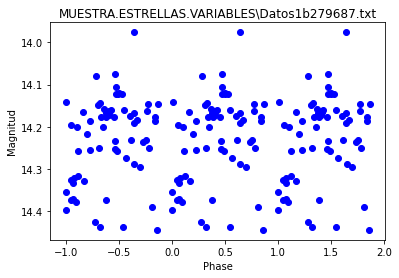

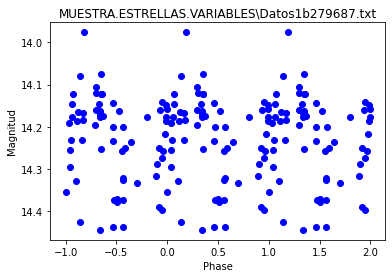

In [43]:
for i in range(len(Tiempos)):
    for j in range(4):
        peri=periodos[i][j][0]
        T,I=Fases(Intensidad[i],peri,Tiempos[i])  

        plt.scatter(T,I,c="b")
        plt.scatter(T-1,I,c="b")
        plt.scatter(T+1,I,c="b")
        plt.title(archivos[i])
        plt.gca().invert_yaxis()
        plt.xlabel('Phase')
        plt.ylabel('Magnitud')
        plt.show()
   

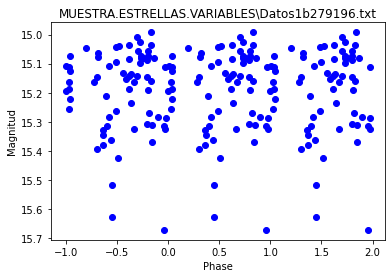

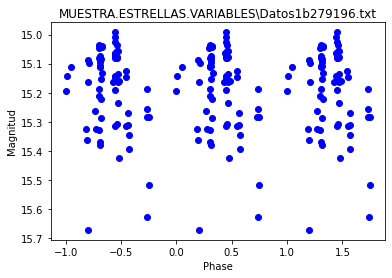

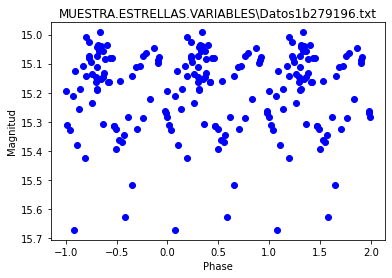

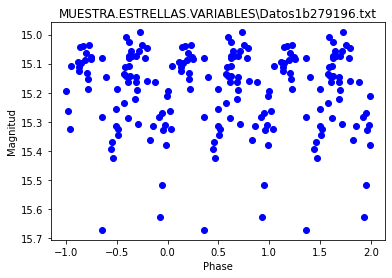

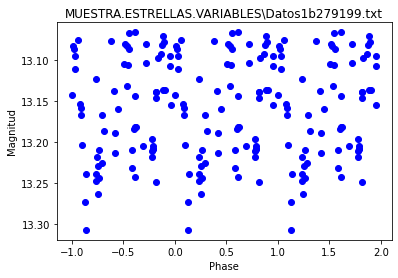

...

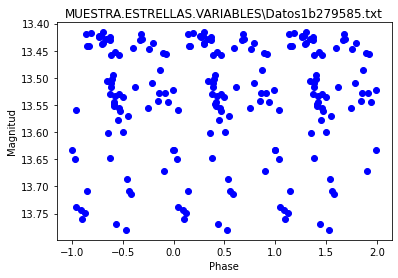

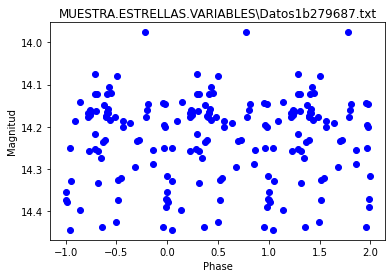

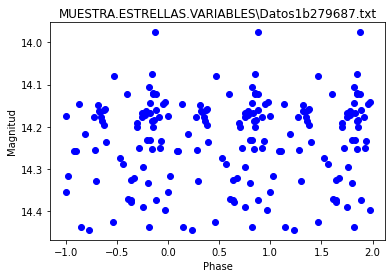

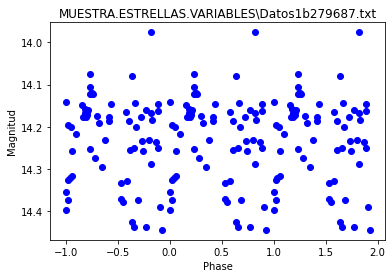

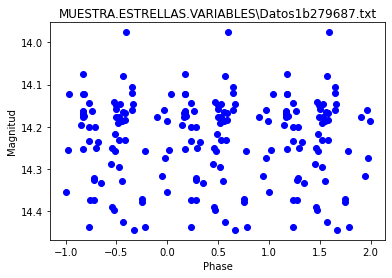

In [42]:
for i in range(len(Tiempos)):
    for j in range(4):
        peri=periodos[i][j][0]
        T,I=Fases(Intensidad[i],peri*2,Tiempos[i])  

        plt.scatter(T,I,c="b")
        plt.scatter(T-1,I,c="b")
        plt.scatter(T+1,I,c="b")
        plt.title(archivos[i])
        plt.gca().invert_yaxis()
        plt.xlabel('Phase')
        plt.ylabel('Magnitud')
        plt.show()
   

In [ ]:
for i in range(len(Tiempos)):
    for j in range(4):
        peri=periodos[i][j][0]
        T,I=Fases(Intensidad[i],peri*1/2,Tiempos[i])  

        plt.scatter(T,I,c="b")
        plt.scatter(T-1,I,c="b")
        plt.scatter(T+1,I,c="b")
        plt.title(archivos[i])
        plt.gca().invert_yaxis()
        plt.xlabel('Phase')
        plt.ylabel('Magnitud')
        plt.show()
   

In [5]:
archivos=glob("Candidatas3/3_10000/*.txt")
Tiempos=[]
Intensidad=[]
Estrellas=[]
Error=[]
n=len(archivos)
i=0
while(i<n):
    Datos=np.loadtxt(archivos[i])
    Estrellas.append(archivos[i])
    Tiempos.append(Datos[:,0])
    Intensidad.append(Datos[:,1])
    Error.append(Datos[:,2])
    i=i+1

In [6]:
len(archivos)

136

[0.11088332786584354] [0.15039149680664413]
[0.18328415513674998] [0.15124799801218594]
[303.0493126772856] [0.1536705446632614]
[0.12002568296838907] [0.17371874595667613]


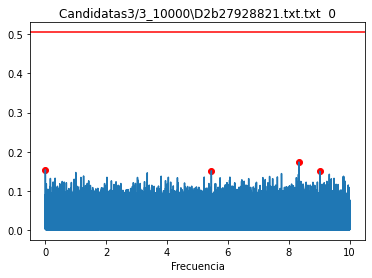

[0.1089351457634312] [0.22416926547476942]
[0.9942239979240397] [0.22428092270955777]
[0.4985493340613025] [0.24472412788214104]
[0.9969992216748045] [0.25243100467012847]


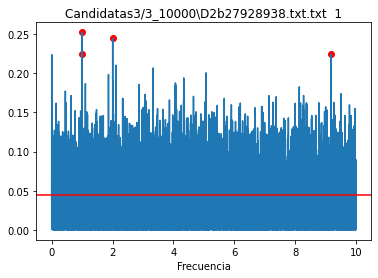

[0.13590025774815243] [0.23365387550733133]
[0.15734086322626822] [0.24432022091134944]
[0.10248713899859967] [0.24670496393135813]
[0.4992711118077011] [0.25353158882168203]


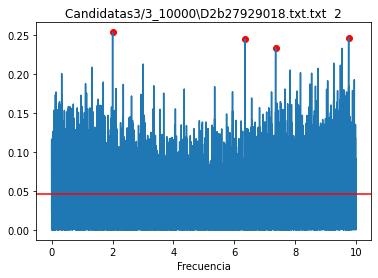

[0.996204720921913] [0.25922821991022915]
[0.5002200590089493] [0.2786782854978727]
[1.0009908106322865] [0.31585974800400857]
[263.17534759231626] [0.3243454644039732]


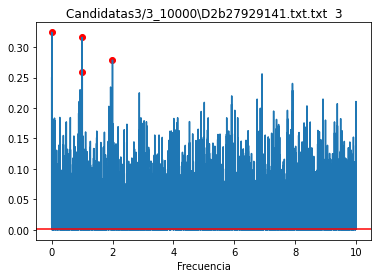

[0.1424893493347167] [0.21978690591026276]
[1.991417422850274] [0.23042454151669814]
[1.9926077498471155] [0.24208115926015575]
[2.0090193414445086] [0.24723799386013198]


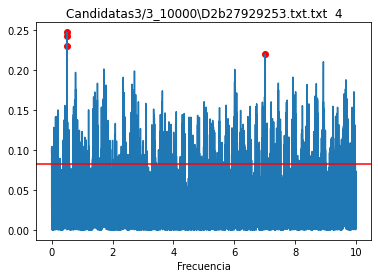

[0.25028529617923084] [0.2318140339549747]
[0.1084696311537589] [0.2327181338332709]
[0.10555373779645938] [0.26208543676071133]
[1.3456537780946556] [0.2822805156995679]


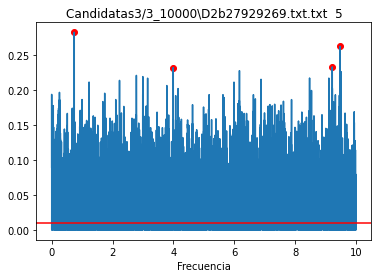

[0.13142132476172802] [0.24898323454668533]
[0.10652741229987689] [0.28079619893394714]
[0.11615582045619935] [0.2933007844314513]
[0.10403732519521934] [0.3236489104082284]


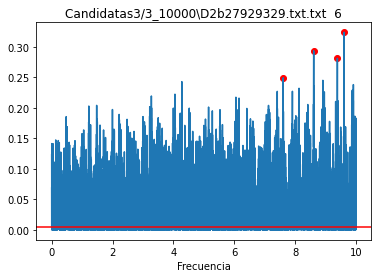

[0.10102327365831915] [0.18266641908712186]
[0.19835577681967012] [0.19748758729288612]
[0.24760218531714362] [0.20463213968015131]
[0.19846205571073358] [0.21458430009625304]


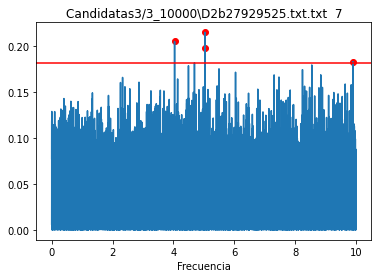

[0.49882286602940407] [0.29058034901824825]
[0.12729459651794572] [0.2932385693150738]
[0.995411485423417] [0.3140301411887409]
[217.40661748879802] [0.35255429229275914]


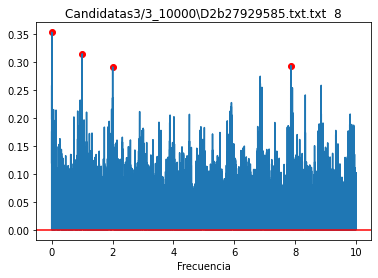

[0.9992904866664286] [0.1581891974728064]
[0.9967011354283704] [0.16475818397922656]
[0.14594740468512052] [0.168434476105681]
[303.0493126772856] [0.18113040080579457]


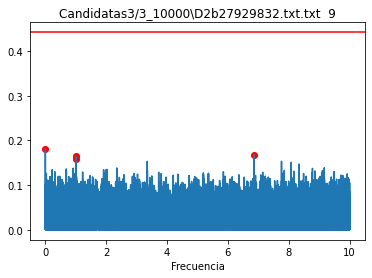

[1.2849670992448867] [0.2528514851711166]
[0.35762201924251724] [0.25285350264583345]
[0.213644226735382] [0.25378395713650137]
[0.2716897540196623] [0.2541690012782179]


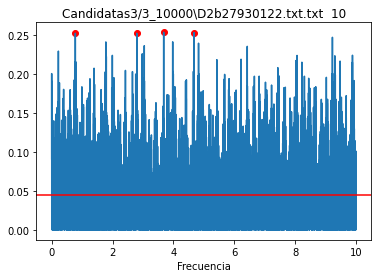

[0.4141502284759201] [0.22568578421039237]
[0.22198570296994333] [0.23397435216207135]
[0.14295168612549478] [0.23616174211264643]
[0.10474998424413544] [0.2408048304492782]


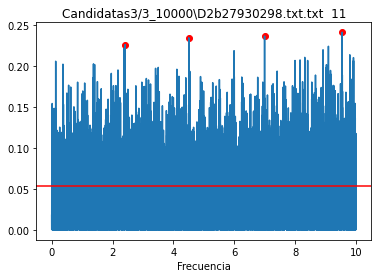

[0.9931379539320211] [0.35579920877936594]
[0.5003451890961225] [0.3650167624271077]
[238.11156590874995] [0.425521389704409]
[1.0042071680020246] [0.47419832231567477]


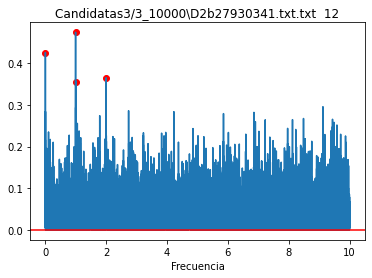

[0.16450742588682102] [0.1572730547093485]
[0.13639884845048156] [0.15992457786237252]
[0.16246040292694836] [0.1656396125639111]
[7.220861798255191] [0.16907554377253148]


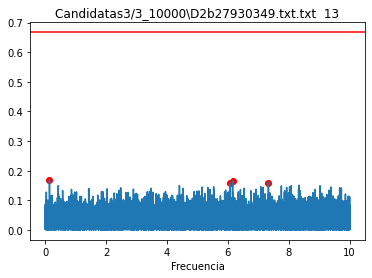

[0.10790319788621995] [0.21860526909693015]
[5.862189222456654] [0.21905092922436875]
[0.9970986233829006] [0.2655068034791328]
[0.10709206940672585] [0.27459005883082555]


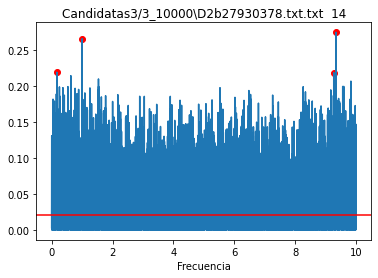

[0.4986736295765569] [0.16952774900045747]
[0.999789982016198] [0.19444446092936327]
[0.9973969474680338] [0.22801542917133447]
[384.636687783432] [0.23506113890262112]


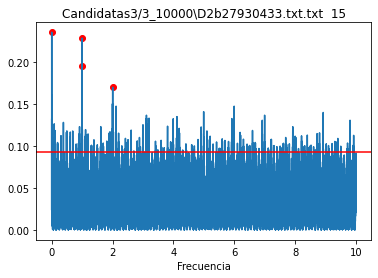

[0.1162652001367139] [0.21325262490544564]
[0.10823719120095442] [0.2156723041816557]
[0.13160810595538702] [0.2173191135863748]
[0.9970986233829006] [0.2249359426078662]


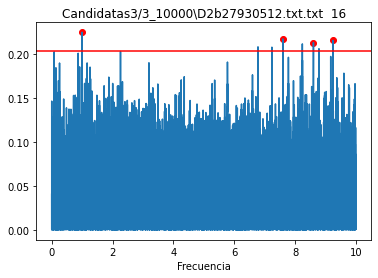

[0.10051963976533065] [0.22051821049911477]
[1.836375034356625] [0.22281984046671066]
[0.5326710844504436] [0.22968026984499862]
[0.17608768256913876] [0.2417067884355442]


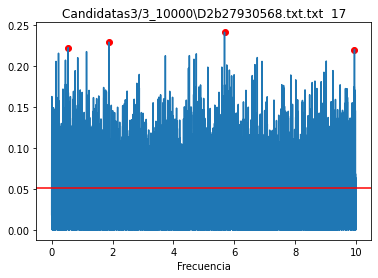

[1.0542799010185742] [0.1607547709693444]
[0.9967011354283704] [0.16790795622550828]
[0.12002568296838907] [0.17112629780995878]
[303.0493126772856] [0.17861796179788414]


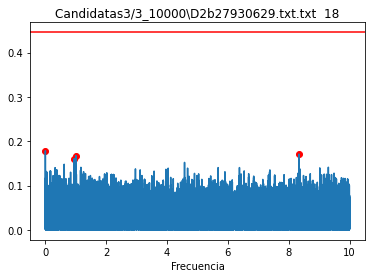

[0.15687686194205028] [0.2458917179132096]
[0.6770172949250269] [0.24777446815693016]
[0.13555028419628007] [0.2489758188454764]
[0.2666479989868768] [0.2636201602368276]


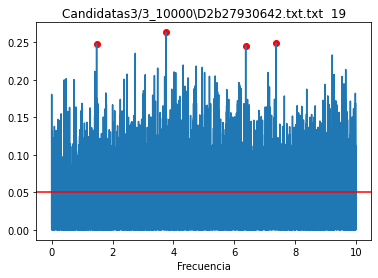

[0.20124964601091086] [0.30263619848483203]
[0.3371392862241538] [0.30381014679341234]
[0.10875863185380287] [0.3045599653860277]
[0.2519562608829186] [0.3173434523784292]


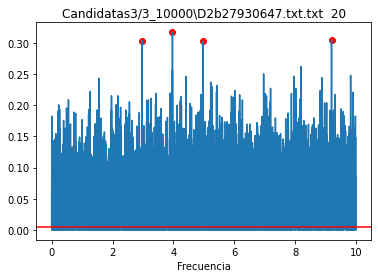

[0.22131270642872478] [0.21089914049383016]
[0.10081857313490539] [0.21121416045469132]
[0.37896550772663634] [0.21126907491726196]
[0.10079215503751135] [0.24579853559280046]


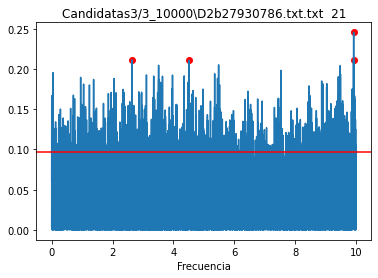

[0.332454617072333] [0.25447178394326464]
[0.4980527710018266] [0.2550726428313298]
[0.994916354406559] [0.2631860837464159]
[0.49872336513803833] [0.2928406714429719]


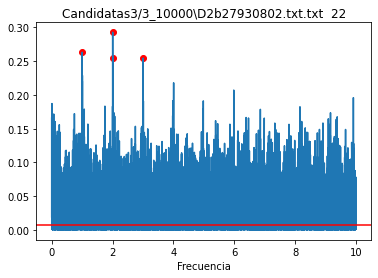

[0.14433395814829625] [0.1756772017397299]
[0.6787173043164124] [0.1855288048447699]
[0.12608454439064487] [0.1922364315708402]
[0.14427565654156096] [0.1936415642570314]


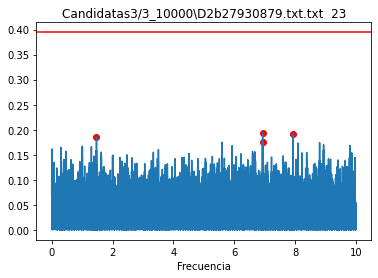

[1.2851322196446067] [0.23190872559623657]
[0.11781288266853739] [0.23692563034581654]
[4.452758718666681] [0.25829140559347774]
[0.5640347178572549] [0.26262030807265013]


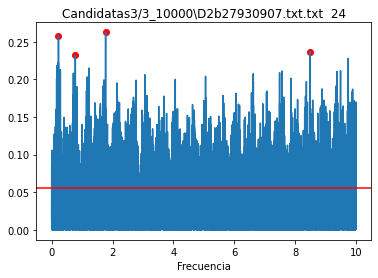

[0.800264012939054] [0.19643184200985941]
[0.19055140458988615] [0.2090012144868041]
[0.1998541178258289] [0.21292077034977366]
[0.23556471270709117] [0.21932794561696653]


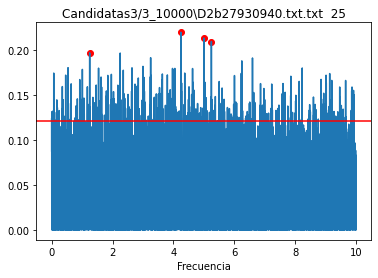

[0.3205108419549529] [0.26673173332515504]
[0.10028076085940188] [0.2712631953751354]
[0.527974850321197] [0.2749958207487067]
[0.1003079175916516] [0.30146805158673207]


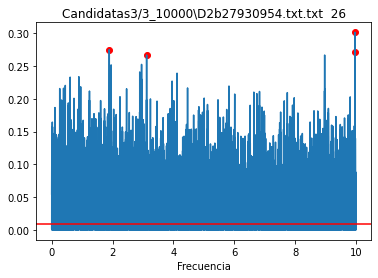

[6.645112364657643] [0.22335419432877385]
[0.1843925719350091] [0.22355986952013995]
[1.6272207330562765] [0.22800089230957837]
[0.1465612491476865] [0.23357874286081387]


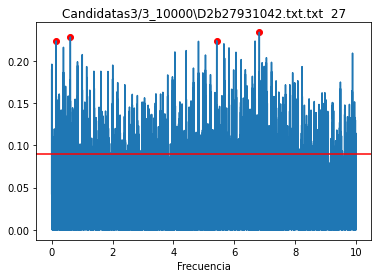

[0.16902834245218243] [0.23721534534007405]
[0.22097041231833978] [0.24979832875685942]
[322.6003135706405] [0.2658945987134229]
[0.9970986233829006] [0.2868580329222748]


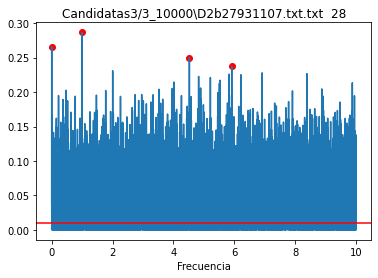

[192.32167275370847] [0.20394691307685717]
[0.1913461890670839] [0.20671921230952922]
[1.06392543961493] [0.22636905562813275]
[1.001993706855473] [0.2325574776040232]


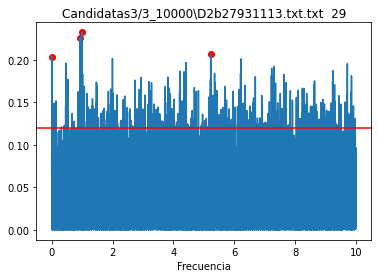

[0.10205416545727444] [0.16127722676349784]
[6.0355429435589] [0.16140718875604124]
[0.8558749952626845] [0.17843779471749047]
[5.9387736012934775] [0.1789139987457089]


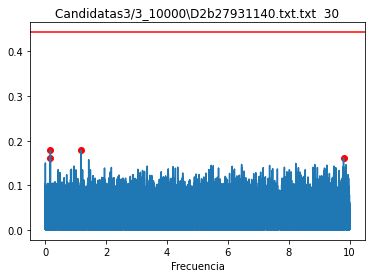

[0.42174755241421347] [0.6223492131102619]
[2.7347272705792474] [0.6451130510694867]
[0.4222283082819184] [0.6982599760359927]
[0.7307927973861678] [0.817330067921526]


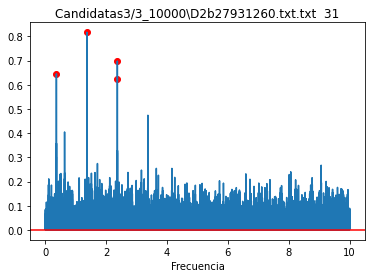

[0.5154040211347656] [0.16673204072286116]
[0.1757967257602722] [0.16728845232030168]
[0.9968998397836341] [0.16760796823311966]
[0.16910551129182988] [0.17198480314934414]


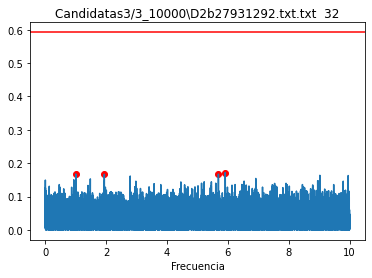

[0.21110970172864854] [0.1974668713649388]
[0.1462996819486259] [0.2075639830812015]
[0.8515752148769294] [0.20964209730525624]
[0.1276276158133315] [0.21927517005083894]


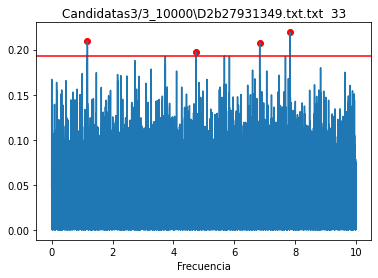

[0.21231079288632157] [0.2019059492498957]
[0.254385202753203] [0.20313371174463765]
[0.4990717920454847] [0.20657378159128806]
[0.10717814613002778] [0.21130441781301887]


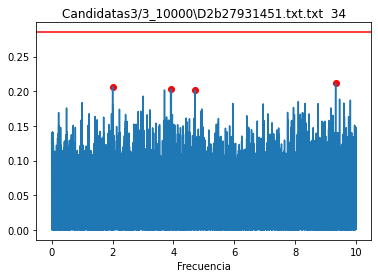

[1.0009908106322865] [0.3803978270032548]
[270.28802179624404] [0.40184809198736465]
[0.9976954501190437] [0.41960561587171197]
[1.0003900359675828] [0.4651689647028471]


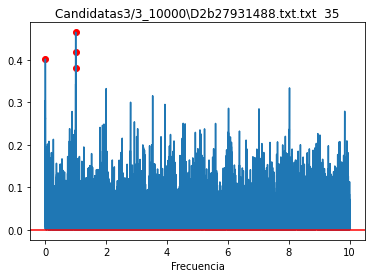

[0.2626355695688791] [0.29829420225471726]
[0.49912160706466185] [0.3540259133642647]
[0.9993903458047102] [0.3874169360746904]
[0.9966018129524333] [0.4246108837793057]


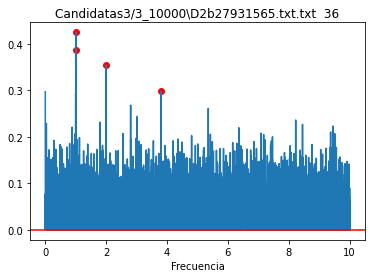

[2.251440356485824] [0.2792494936743236]
[0.6911471643340943] [0.30378326929706034]
[0.11446868403736932] [0.30906373426196526]
[0.12902222819239847] [0.3181454478404986]


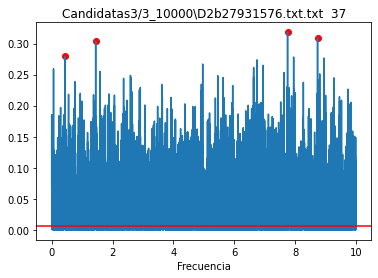

[0.11688346580652105] [0.19873239734335452]
[0.1004207249685843] [0.19888047926840002]
[0.12615452508935443] [0.22415937908828526]
[0.11308246348584455] [0.22419541002372642]


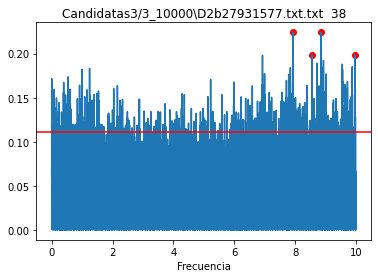

[0.31802397060955906] [0.24720583126583845]
[0.12461559520826064] [0.2526298934698799]
[0.12565996930282228] [0.25418790334307]
[0.14377785388590802] [0.2550188801620116]


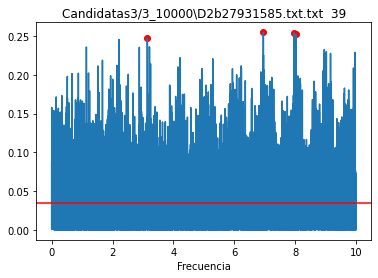

[0.2992310400536812] [0.15252076649237906]
[131.5892322086289] [0.15452574862627114]
[0.13114214492485268] [0.15854626628367605]
[0.15093647586218606] [0.17137883854899044]


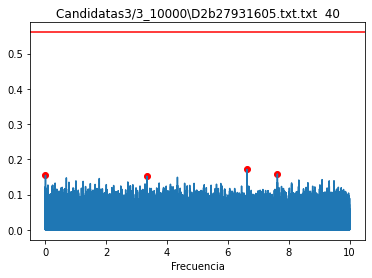

[0.28133509161646497] [0.22461727681762972]
[0.12690209085100113] [0.2288172521199614]
[0.11257710825205403] [0.23548195095575356]
[0.10684151481055522] [0.23730386139083645]


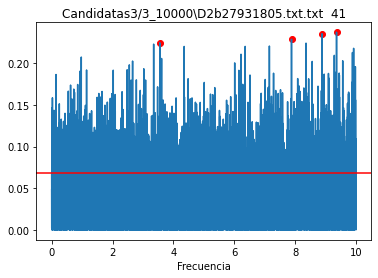

[0.12010496207311001] [0.240507664933187]
[0.4986736295765569] [0.24688293433901196]
[0.11289353955314724] [0.27335533326177763]
[1.8130707864543327] [0.27479687561880467]


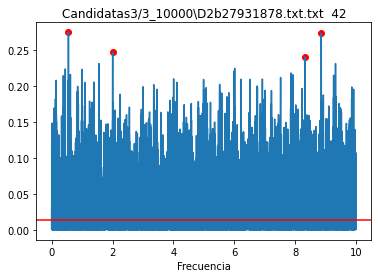

[0.1258513071846009] [0.15925002918749614]
[0.10109680157507563] [0.1623068780843904]
[0.34008568653386173] [0.16622740173003667]
[0.5160689212807947] [0.17452768895176654]


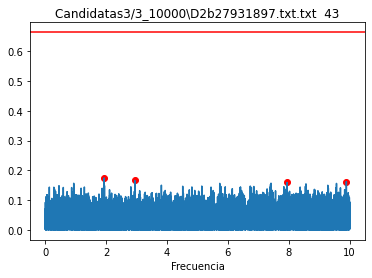

[0.9946195121593153] [0.43891928257845475]
[0.3327089986540123] [0.48083917309267965]
[0.49859904483123857] [0.5179018398620628]
[0.9971980449138503] [0.6026290343495726]


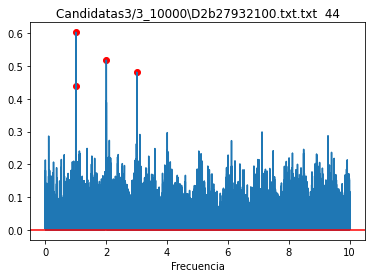

[0.10746491579034304] [0.22888499258848993]
[0.1204042809698211] [0.24329112786954915]
[0.11487365020230159] [0.24573507504042325]
[0.995411485423417] [0.24993459784077884]


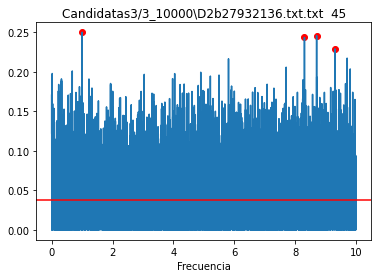

[0.32884715881944493] [0.14739540088709085]
[0.9967011354283704] [0.15223972065326988]
[1.0005902140457974] [0.1550178340017906]
[303.0493126772856] [0.1896306639751336]


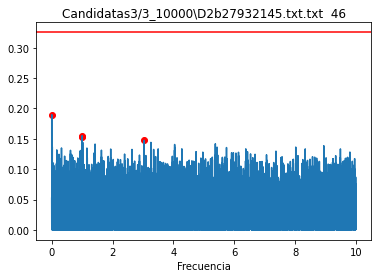

[0.12064539455235282] [0.22014410156567166]
[0.5102760156495055] [0.2217574139832655]
[0.16437223578816287] [0.22502403782163555]
[0.11701475405343804] [0.23532923447129803]


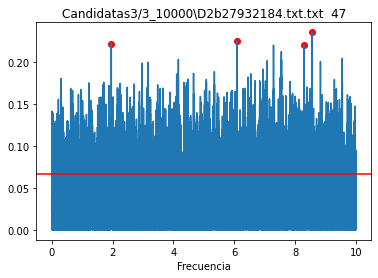

[0.10344224818632064] [0.2177301315220893]
[0.13042553988203126] [0.21993238804171103]
[0.11537724949422117] [0.22094561368430538]
[0.21523048887965798] [0.2325520298303828]


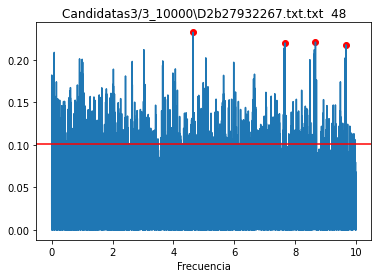

[0.13104934837713644] [0.24320092991960784]
[0.11586514494259331] [0.24586091581196162]
[1.0002899769611908] [0.2801062802351001]
[0.9968998397836341] [0.2937371292488152]


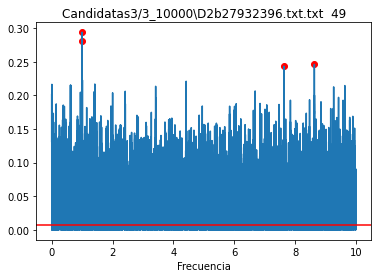

[0.3382110174362071] [0.2503371886938397]
[0.530270393039126] [0.2576566188037738]
[0.19779478485771707] [0.2587633770767828]
[0.16506131379357575] [0.25998837646425305]


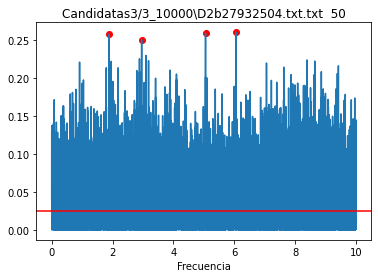

[0.23540945503187866] [0.20761597584537309]
[0.1319397349734345] [0.21534652568727142]
[0.13338623804565905] [0.21545348603595474]
[0.11765072624095946] [0.23472350967277808]


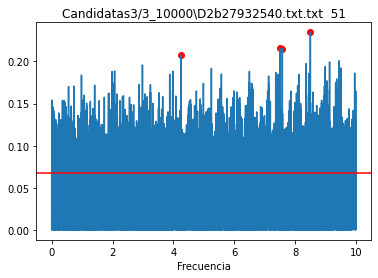

[0.5156431877228007] [0.21406554276949408]
[1.064718314879877] [0.22562422262541226]
[15.749426636389668] [0.23367996528780174]
[0.39965232298137543] [0.23432479452332586]


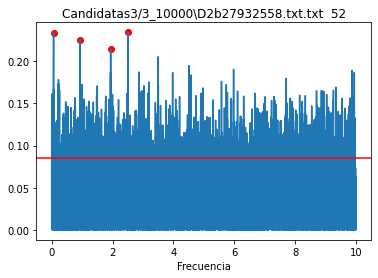

[0.12381335551744173] [0.17138318410300707]
[0.11013964440071153] [0.17312464887678392]
[0.12250600200576427] [0.1894623348513167]
[0.13960912911772483] [0.19357758060285157]


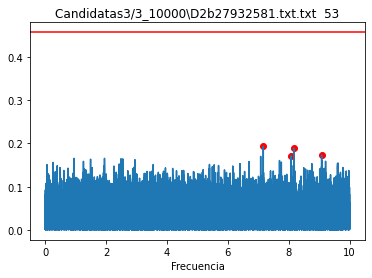

[0.49862390393391864] [0.21599920967677685]
[0.24931817280183988] [0.22136650056805782]
[0.4979535770666183] [0.2310157781620929]
[0.3324214655409593] [0.26339155190351554]


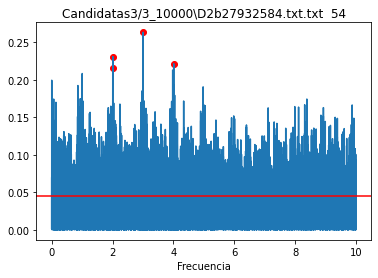

[0.1974823251897068] [0.1709169019768168]
[0.13644909497629454] [0.1735086240525035]
[0.1339310580868196] [0.17388165880244616]
[0.12002568296838907] [0.19990616731001182]


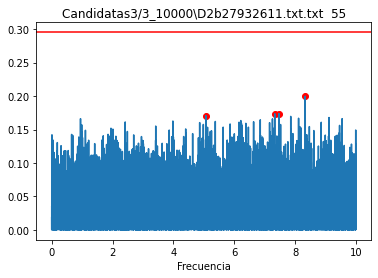

[0.21157865574107568] [0.14129506819323254]
[0.10448732678564267] [0.14213809530064694]
[1.4517199569357486] [0.14638226889493697]
[0.10293439549351346] [0.15249394552604123]


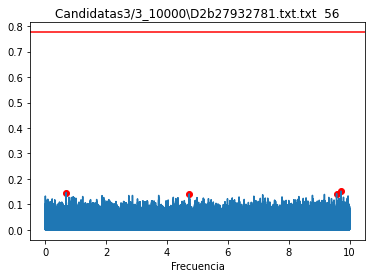

[0.2721407343072694] [0.4539664695516789]
[0.37389336598890827] [0.5026699738931415]
[0.3742851704011474] [0.5373405826072508]
[0.5981757013934463] [0.5983199965648801]


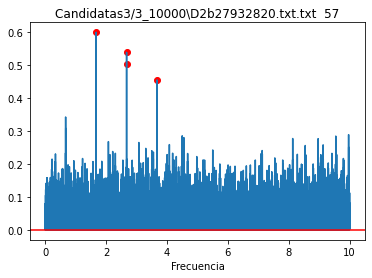

[0.4990717920454847] [0.16949145957260195]
[0.7609297272391202] [0.17876007785783882]
[0.1020406289030931] [0.18368221296965942]
[0.10910628168492426] [0.19443483877443204]


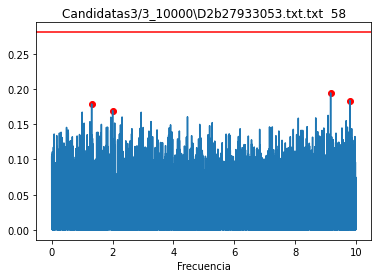

[0.1099012076076443] [0.1776783303750144]
[13.967719996932658] [0.18244685554924708]
[1.6503133010855586] [0.18755663473466622]
[0.3425082976033667] [0.1900155468382648]


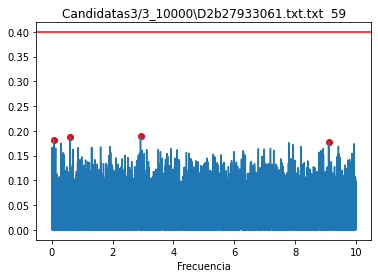

[0.14407404682459685] [0.2544669463484242]
[0.11399505291633737] [0.25680265058631324]
[0.1023298407676394] [0.26016393454180076]
[0.1023005318937123] [0.266378135500137]


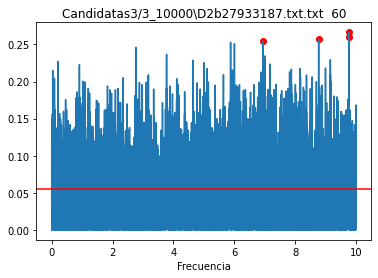

[0.644803321059186] [0.22428076605176062]
[1.815374560901887] [0.22960817257301447]
[0.19816711735670353] [0.24672553972060418]
[0.22405959198689818] [0.2474920644893123]


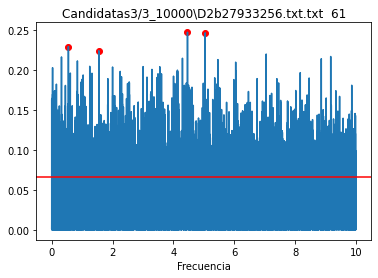

[0.12134952775964646] [0.1575801923532508]
[0.10168890062309185] [0.16025529463711177]
[0.14766706962016576] [0.1712814729673956]
[0.10627271368833012] [0.17618886861524155]


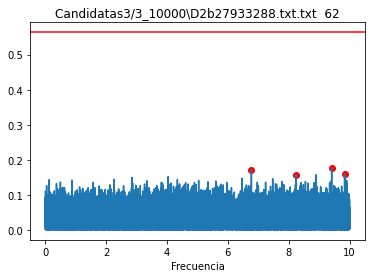

[0.9968004777034637] [0.22110760980001024]
[0.9977949907117328] [0.23259348522906223]
[0.2010877851974885] [0.2348777445204879]
[0.1089351457634312] [0.24020773912999285]


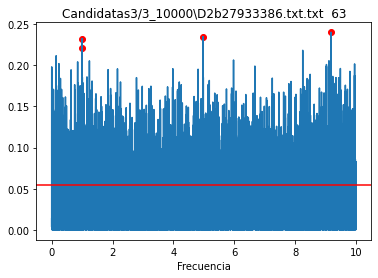

[1.4692079870118364] [0.23230612731918773]
[0.10305425315318562] [0.236715915258926]
[3.133113179801106] [0.2376185449698675]
[0.5939834623371397] [0.25488613397302784]


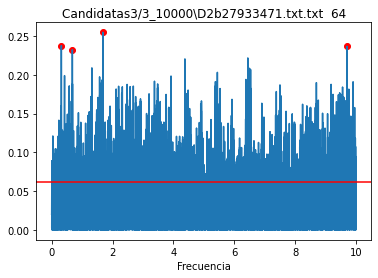

[46.515619636113975] [0.15860048621195402]
[1.1327329335652288] [0.15955267903317064]
[1.6182683872850798] [0.1623100142474284]
[0.13707749618447485] [0.17176932817726712]


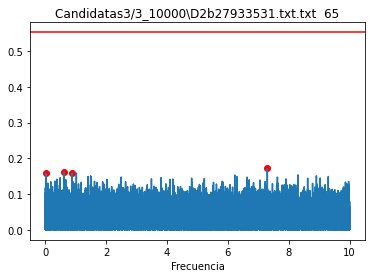

[0.12013093071327749] [0.24848443542382276]
[6.840556725644484] [0.25607583285067675]
[1.167510978186322] [0.2662924165736943]
[0.8724504322363329] [0.2842878010918681]


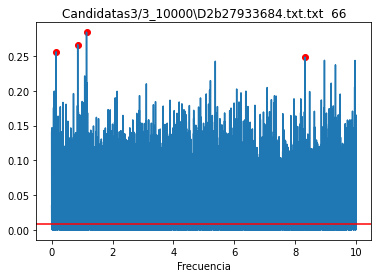

[0.4146653833971653] [0.24282047625614797]
[0.19647747417853456] [0.24295454092879512]
[0.10473023913775352] [0.2454561390747187]
[0.1216314167633117] [0.2850320556365534]


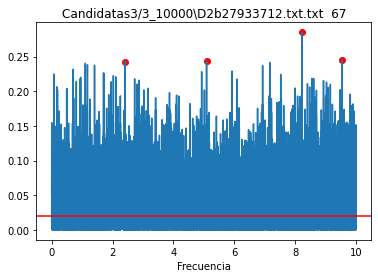

[0.20455502865335262] [0.21472051900182557]
[15.338782643748456] [0.21573800742723612]
[0.16981763120895618] [0.21731371284062262]
[1.0666487979873158] [0.22013215938750952]


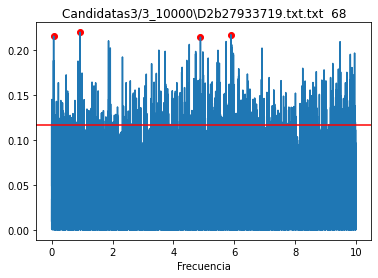

[3.57685868044143] [0.24653458323362407]
[0.4737068806190873] [0.2612168705242611]
[9.234433774872965] [0.3094772990118293]
[0.9000899360855948] [0.33999766762062256]


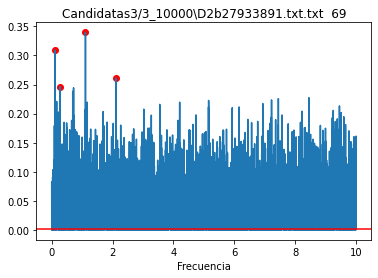

[0.10461192464277044] [0.19802649487005952]
[0.11683430863500283] [0.2039681975538102]
[0.10793464058687535] [0.20637309465728965]
[0.24286407808371913] [0.21337868384963662]


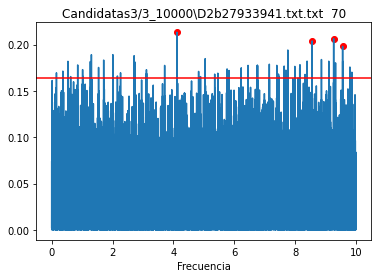

[0.15656250898726712] [0.2342640476197786]
[666.6866674666986] [0.24490038912239873]
[0.10836502716976805] [0.24705662909697282]
[0.12157522982434389] [0.25110394391076835]


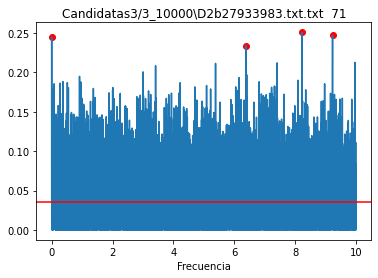

[0.34476350591874017] [0.23903997449760628]
[0.9624578215484875] [0.2419588183119786]
[0.5279191097357625] [0.24431751282233596]
[0.3451799875510283] [0.2656575261394113]


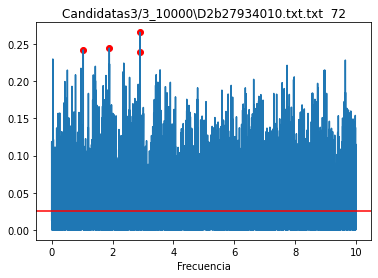

[0.10358474537818915] [0.18280845753153693]
[0.12120833815186749] [0.20403646643055418]
[0.10807344002175516] [0.21658226311709006]
[0.9970986233829006] [0.2714628865328412]


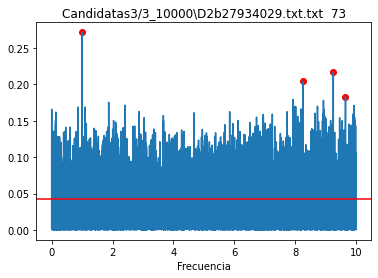

[0.9192002998755511] [0.20716325402308158]
[1.1762995802438838] [0.21397126028191388]
[0.16077583347206414] [0.2212870469588384]
[0.1385070281191082] [0.22526286606398138]


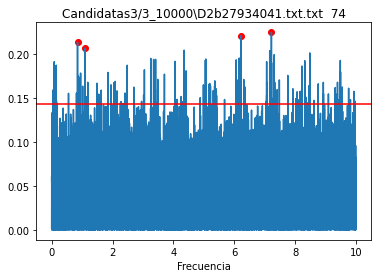

[0.19173872040159692] [0.20923803879860578]
[0.1608896387579447] [0.21573414709854083]
[0.16081978460541138] [0.2262873338528086]
[0.1385396459981001] [0.24268793474045114]


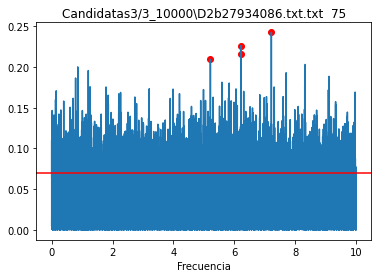

[0.1108255761331561] [0.22728854662003287]
[0.11004632523418395] [0.22927014574824683]
[0.110783835769918] [0.23103225469456015]
[0.20919321232698726] [0.2462080120594864]


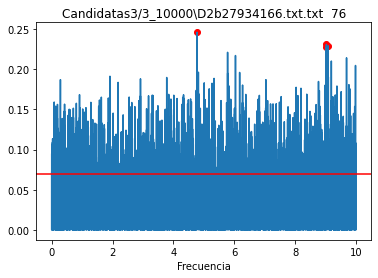

[0.10887466379276489] [0.22085671003729704]
[0.10115508712674924] [0.2272014401355779]
[1.4433394127397339] [0.23011810939268415]
[0.15726910959809792] [0.25165794474164976]


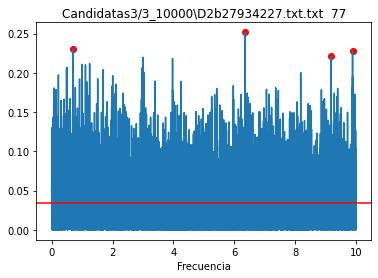

[7.257542494606321] [0.27234646126119877]
[0.11390935894712036] [0.2762147416615956]
[0.5618167285165652] [0.2908967082352698]
[1.2821665302491945] [0.33579344588384]


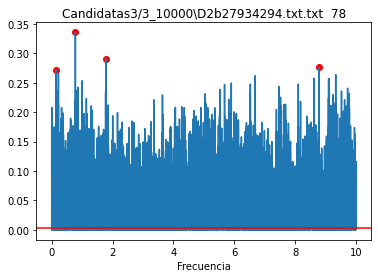

[0.11590274300515838] [0.1830065286927673]
[0.1200645887190269] [0.21736103031911014]
[0.1509387538735026] [0.22784484946142844]
[0.1310974487063091] [0.23253386003619517]


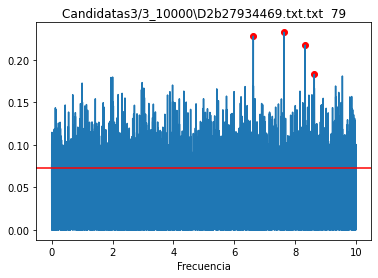

[0.14594527484341652] [0.1520478961719938]
[0.10909199982346557] [0.15564761123831672]
[0.29839180753757955] [0.1586304004492377]
[0.4787180919591992] [0.15953376265801603]


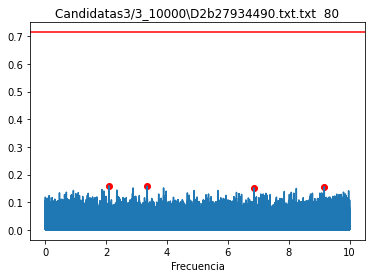

[0.8611813756021915] [0.23600276761182298]
[0.15727652935217284] [0.23738135008142924]
[0.3100765761607346] [0.24125280091046641]
[0.11001243018676132] [0.24631598198284346]


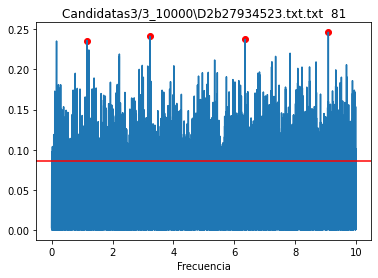

[0.187412625251968] [0.22623530646450676]
[0.33267579637319006] [0.23949797821684665]
[0.9969992216748045] [0.2643077018711802]
[0.4985244823933052] [0.327531521711521]


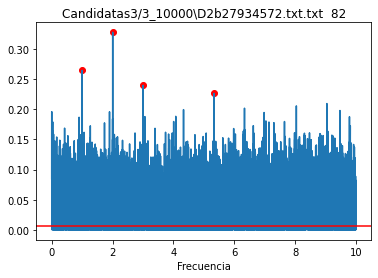

[0.18989651417611403] [0.6461017953733683]
[0.13752234490562018] [0.6568001790455682]
[0.13757342274132384] [0.6853277351685946]
[0.15952179583725495] [0.8656454324059277]


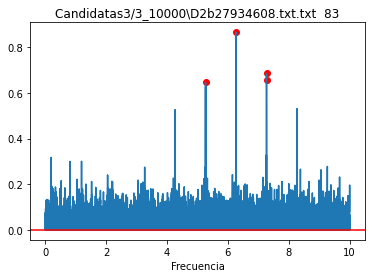

[0.10311269200121968] [0.20771667356812168]
[0.10645824012887743] [0.2134929951441312]
[0.11500310464910944] [0.21753679878935572]
[0.10314034071586785] [0.22610856640137866]


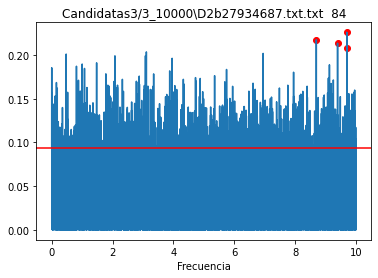

[0.15129039020080526] [0.23133908278431303]
[0.10904917666399441] [0.23713400717914715]
[0.1569556475208699] [0.23764711028654895]
[0.13714328766737102] [0.24879428186123767]


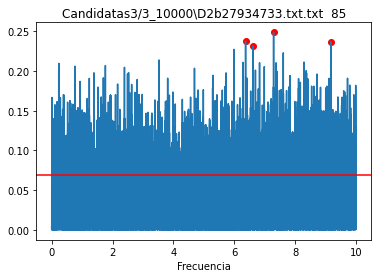

[0.49859904483123857] [0.1883660854910721]
[0.9971980449138503] [0.1967843947607338]
[0.4992711118077011] [0.21753641927725004]
[0.33269793049071583] [0.2693429715632938]


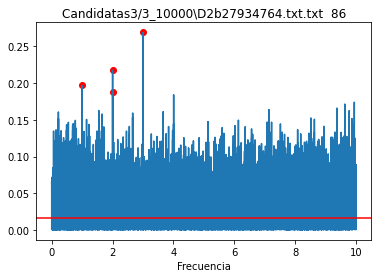

[1.8759891955449013] [0.2606354923159263]
[0.49414000915255274] [0.26436527428758777]
[0.33071758572531107] [0.26538399465884327]
[0.1107691113827928] [0.27799502227991885]


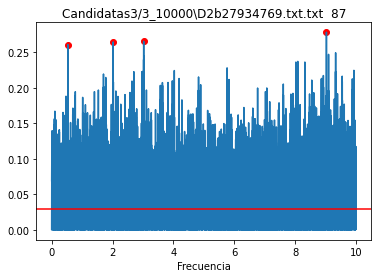

[0.12217525660652447] [0.21474157903390656]
[0.10951729113026547] [0.23170678641118345]
[0.11831184175461605] [0.23877476693859245]
[0.24001967681785796] [0.24060439243070456]


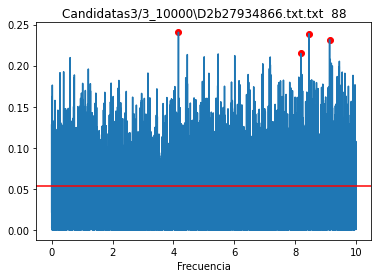

[0.18953662312913824] [0.20989624357913012]
[0.1038320978067523] [0.21750778017875622]
[1.000490114993782] [0.22423193223369361]
[0.4994207061415936] [0.23232011384661153]


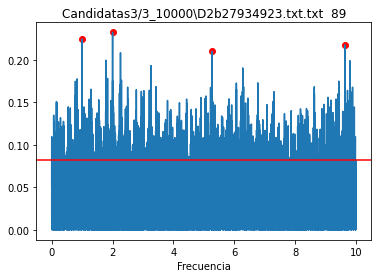

[0.10247978765811687] [0.2802895065123096]
[0.11080592969191734] [0.28211634092099863]
[0.12465908779952385] [0.31319290285466495]
[0.14241224580740705] [0.31332010461908794]


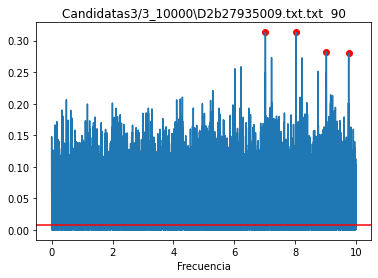

[0.10085619200513665] [0.24941197778191979]
[0.24382328962493827] [0.24950256581565564]
[0.1959193651542518] [0.26174648637334524]
[0.2436569587208139] [0.29159632400658314]


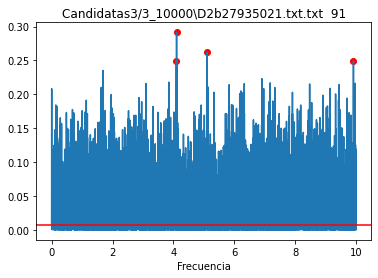

[0.25797456232900856] [0.2834978528920976]
[0.9970986233829006] [0.303211454140529]
[0.19469503601078403] [0.3033705126136122]
[0.16756697785271582] [0.3197023484463714]


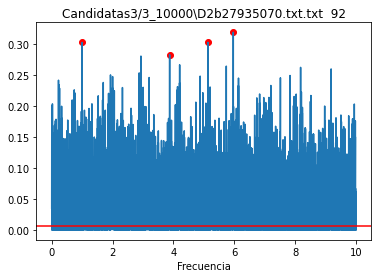

[0.24813665806529556] [0.18631603455949253]
[0.9968004777034637] [0.18847540441659158]
[0.8587411400536391] [0.1967513921121494]
[1.000490114993782] [0.2185131672719572]


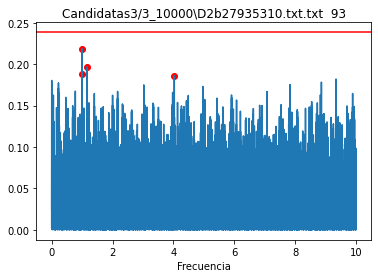

[18.451814541909748] [0.188692433501073]
[0.5131824521807575] [0.1947437395477005]
[0.9967011354283704] [0.21436658763772803]
[1.0541687721263013] [0.2309180169136322]


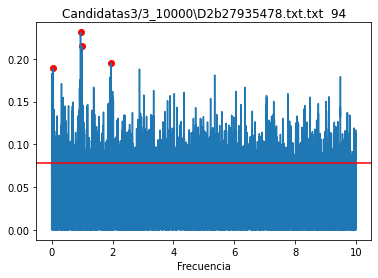

[0.3327089986540123] [0.2641265783243692]
[0.2542041548777993] [0.2788782277989377]
[0.8722221616021759] [0.29452650019678417]
[0.34086229663266027] [0.2962684815662062]


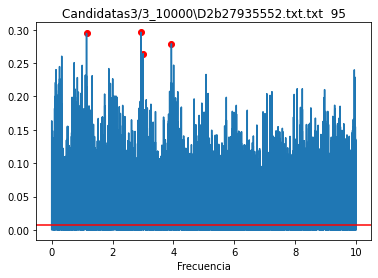

[0.45816839278065824] [0.2152491097565854]
[1.121554231300801] [0.223835050207017]
[0.31420716350479977] [0.22423815912882364]
[0.2389301640096124] [0.2253478473965027]


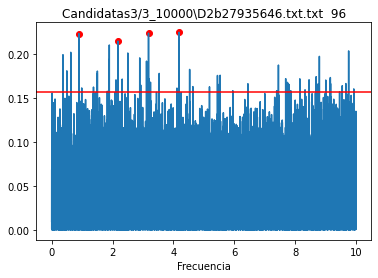

[333.3533347334313] [0.2559136251309403]
[0.3326868630637996] [0.26555400886847813]
[0.4985493340613025] [0.30421134083028484]
[0.9969992216748045] [0.37996393125557526]


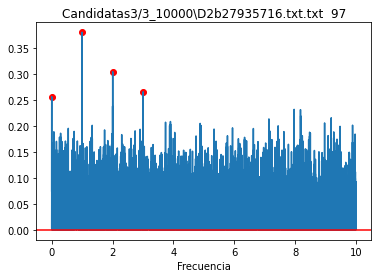

[0.1075157495671284] [0.28656382953276865]
[1.080827744209094] [0.29566043653069335]
[0.28646023808916715] [0.29756565518914513]
[13.370171197395035] [0.3321478805286202]


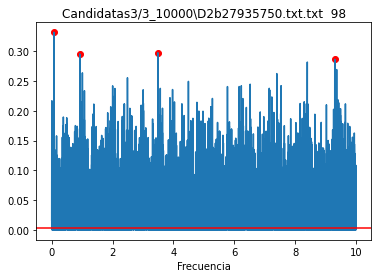

[0.9277272036151218] [0.2151236200581953]
[0.16076807988334524] [0.21701597934017341]
[0.252809723765957] [0.22537935891514677]
[0.16073190635534332] [0.24346910014011466]


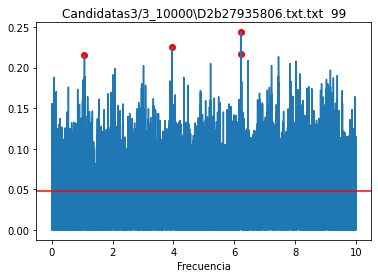

[0.12002568296838907] [0.14651136946137447]
[0.19847781041837553] [0.1471760586523881]
[303.0493126772856] [0.15879433856626454]
[0.2476267082755014] [0.16039390890712263]


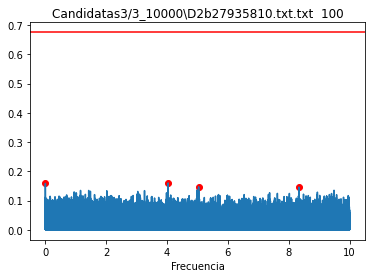

[0.15130641260298666] [0.21355890300653038]
[0.2785610784713653] [0.21649224850401946]
[0.751325926958759] [0.22131341642390856]
[1.0039047567159565] [0.23718132840863781]


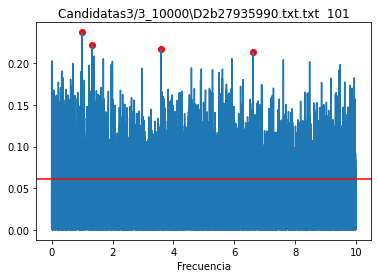

[0.11363496901143406] [0.2450023440883582]
[0.10201148544110368] [0.24896353956911868]
[0.11936099851496484] [0.24930409195716474]
[0.1668012065292276] [0.2584757289353111]


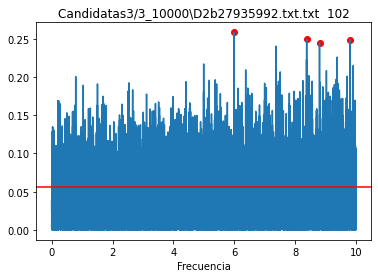

[0.12239655337650794] [0.12065473852249838]
[181.83157136778712] [0.12098637668093969]
[1.0001899379686] [0.12311102526987577]
[0.9970986233829006] [0.14395026885523826]


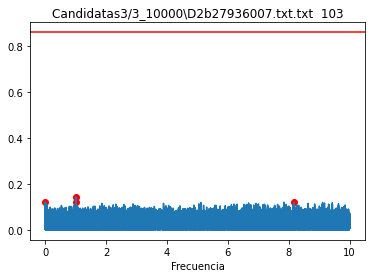

[0.17899343025967465] [0.21983949932430974]
[0.31369467104719306] [0.22559469811541813]
[0.16072932315480284] [0.26161505335599666]
[0.13847059101369358] [0.2817287234442526]


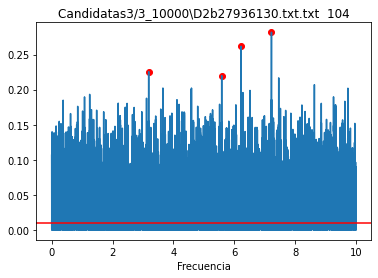

[0.10380515446451759] [0.2606545771956364]
[0.5588031282916628] [0.2786475620910381]
[0.31603412246957957] [0.2798572214739563]
[0.23999087814349224] [0.2843681409858611]


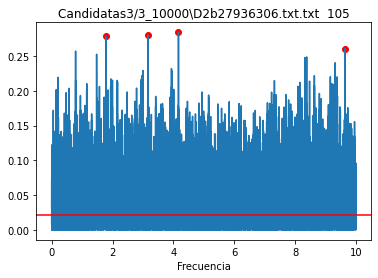

[0.4985493340613025] [0.22298665439647428]
[0.12473216151035595] [0.22378816565094983]
[0.49922126694279073] [0.22941648676809834]
[0.9969992216748045] [0.2857651466628114]


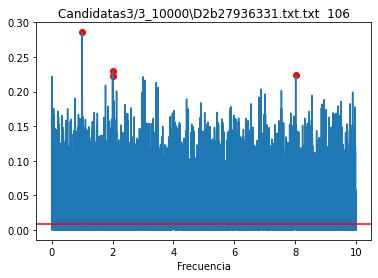

[0.11782676292978521] [0.235297440940726]
[0.15887305512413147] [0.23586532801520677]
[0.13361255804603436] [0.23792064648443842]
[0.13283171696704077] [0.24425413961028347]


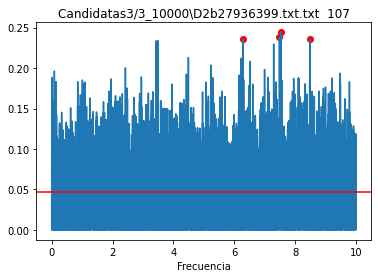

[0.3250950751680321] [0.28202526307666265]
[0.3318809249116047] [0.2965004870801182]
[0.481669299063877] [0.3015101379184367]
[0.9292788750766001] [0.3187700680992208]


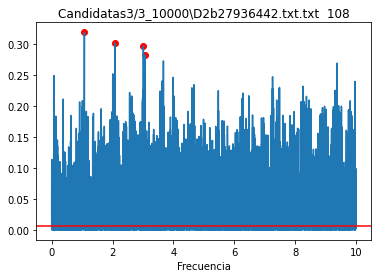

[0.25797456232900856] [0.20323022443143207]
[0.29341058606170056] [0.20777134291877225]
[0.17667249511523048] [0.20908351977669326]
[0.9071933303205142] [0.22697981748213455]


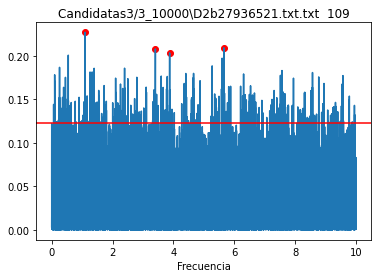

[0.11390416951384376] [0.2218902909424831]
[0.1653287256153521] [0.22639751758442392]
[0.957298672188574] [0.2267133844230255]
[0.3382110174362071] [0.2405952479044261]


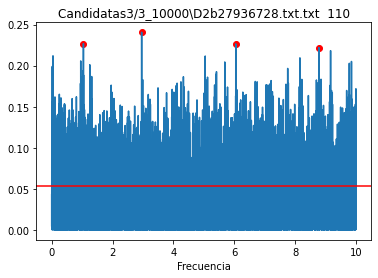

[10.97792558604595] [0.284102368096765]
[0.5318778711519994] [0.2932367676396492]
[0.19507860793548734] [0.29386685568051535]
[0.34688008663541675] [0.29407417566809924]


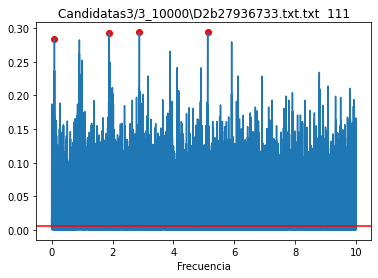

[0.1606699324506643] [0.20850034562255446]
[0.11076543089756387] [0.20990171010979736]
[0.7609876278383535] [0.21093325446619274]
[0.3457049942563998] [0.23817600137953435]


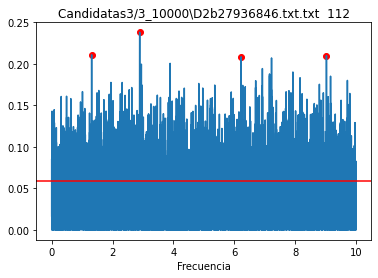

[0.24803819113969003] [0.26198529643623314]
[0.3298558591348342] [0.26243935139670377]
[0.4928979618706984] [0.2709524951560666]
[13.478285658138466] [0.33988465835879855]


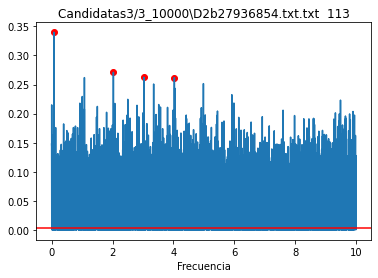

[0.13520759214663292] [0.13544817470705414]
[0.7154742771510769] [0.13620475067788299]
[303.0493126772856] [0.13676037636032773]
[0.1200271234724777] [0.13721500200847014]


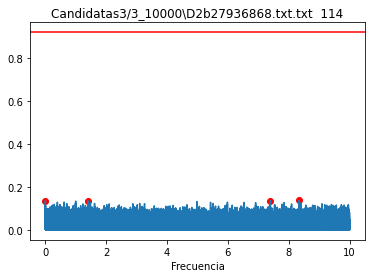

[0.11881928005632661] [0.25505017465878005]
[0.330695714316285] [0.25862857522816873]
[12.971320900976206] [0.2618647430605788]
[1.0834036523505792] [0.2622357215449424]


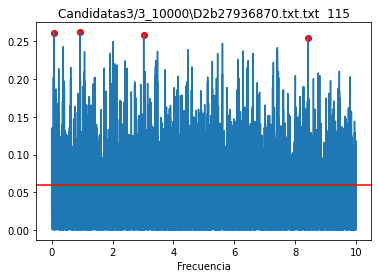

[0.18353642732262243] [0.2423654440341398]
[13.533001230162112] [0.2637549480082109]
[0.9969992216748045] [0.26495049474926163]
[0.25186742547424] [0.2668122898657116]


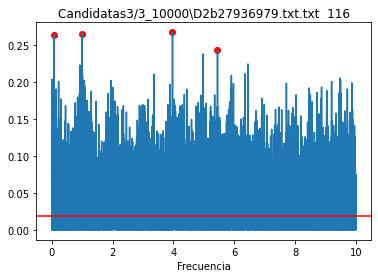

[0.4981768190089675] [0.22654902405799743]
[0.9946195121593153] [0.22736372780988987]
[1.002696930769151] [0.24605580963589285]
[357.16352181040855] [0.24746458202855587]


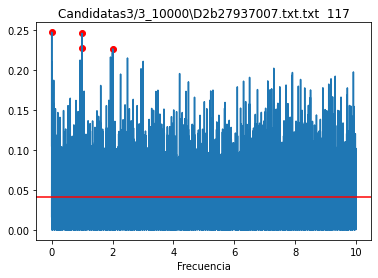

[0.11994794706028106] [0.22444541105521115]
[0.10225137258042434] [0.22516865619021662]
[0.14431729573884447] [0.22712079011127673]
[0.13438457362336453] [0.24666218025597933]


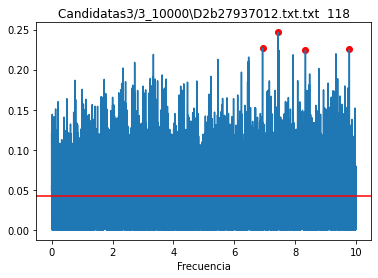

[0.11368922422815904] [0.24630880733737773]
[0.11372283676155845] [0.24837210233443657]
[0.1416317334522134] [0.2669250993855969]
[0.12831701682741806] [0.27507077183230233]


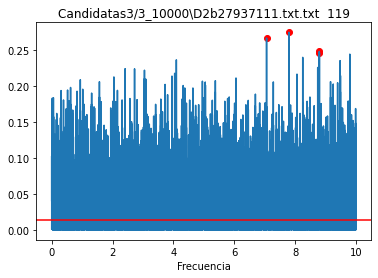

[0.25873541140723466] [0.19059296770799017]
[0.10987343709337323] [0.19165952046007978]
[0.9967011354283704] [0.19248078584546008]
[0.10191896131782364] [0.22167911889297182]


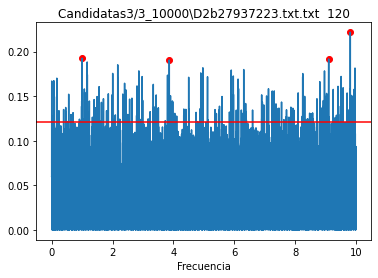

[1.7118963624012646] [0.32920668097055]
[2.404640039821237] [0.34370029109039163]
[2.389129942564981] [0.4301831118444305]
[0.7048843709860179] [0.48797405912966496]


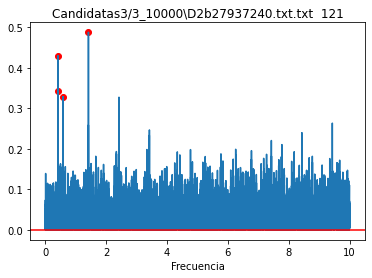

[0.10056815895869642] [0.19522788074560496]
[0.7501424703580302] [0.20246585753742383]
[0.9970986233829006] [0.20758384853156162]
[0.13841118213862677] [0.21059749310542483]


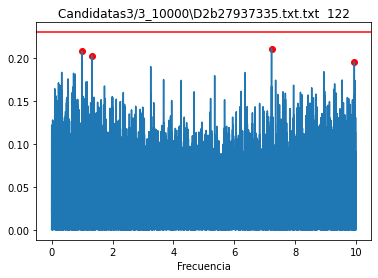

[0.11668027796558533] [0.1846994029048132]
[4.3979314562334375] [0.1847569208514931]
[0.11392363232710771] [0.18502314874082365]
[0.8147372184661646] [0.1931703913089186]


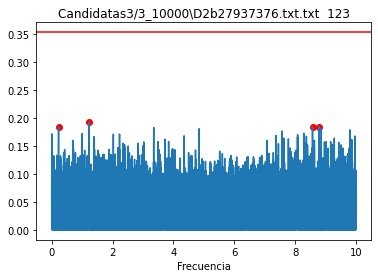

[0.1098324107269147] [0.22319548098152608]
[0.12025371228004372] [0.23928920787275665]
[0.33269793049071583] [0.24986818512966716]
[0.3391630136918561] [0.27412745035446806]


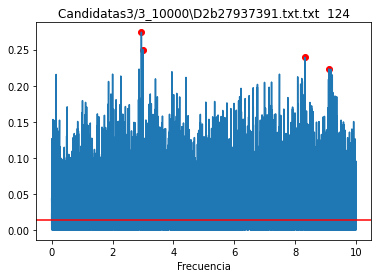

[0.10836385299026742] [0.2619501129666709]
[0.15078627899416172] [0.268733285404094]
[0.21603015283972907] [0.317778736302615]
[0.1775633387814217] [0.3252124144007421]


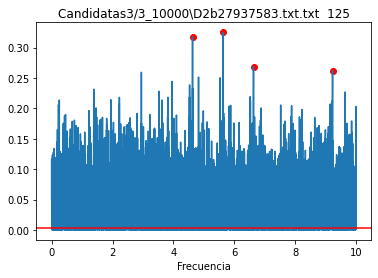

[0.15222996762342195] [0.14479904463076973]
[0.26356999401149805] [0.14820807858125884]
[0.35103193310104125] [0.15961918525100094]
[0.35824974092104844] [0.165632293423816]


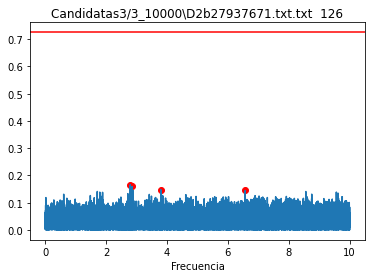

[0.11943369617020068] [0.17147135501188224]
[0.16293948879645465] [0.1721814252543722]
[0.39723942375507487] [0.19162670787030042]
[0.17102279419383848] [0.1994436707377532]


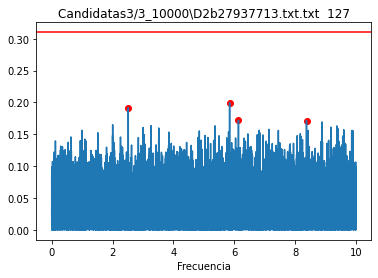

[0.14589630563530948] [0.23720616820674326]
[0.8687369100128204] [0.24537152289135006]
[0.12732052572800504] [0.2516732317612249]
[6.618725435182239] [0.27204071568154986]


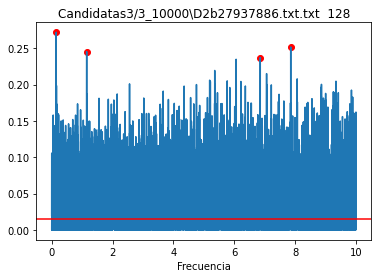

[46.515619636113975] [0.15860048621195402]
[1.1327329335652288] [0.15955267903317064]
[1.6182683872850798] [0.1623100142474284]
[0.13707749618447485] [0.17176932817726712]


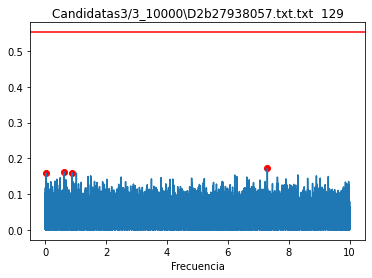

[0.15776280836711687] [0.17736602290289458]
[0.29377257661155715] [0.17922205755464518]
[0.187412625251968] [0.17964983275035223]
[0.1538339658141635] [0.18165660809876322]


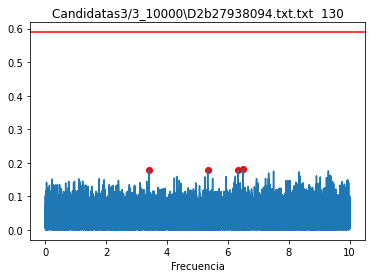

[0.10137965289471848] [0.1733948467459334]
[1.6006559938019418] [0.17760043174992032]
[0.14457181623513] [0.1789393339940654]
[0.10803724781261279] [0.20243745756172726]


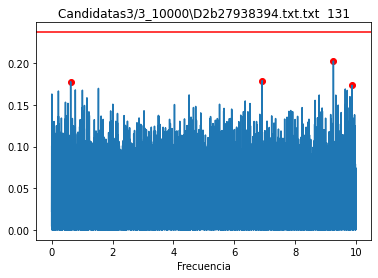

[0.10555373779645938] [0.24075673428510758]
[0.3341318295165641] [0.2550385823292296]
[0.18391444930798193] [0.2654185965069988]
[0.9970986233829006] [0.29094558830810147]


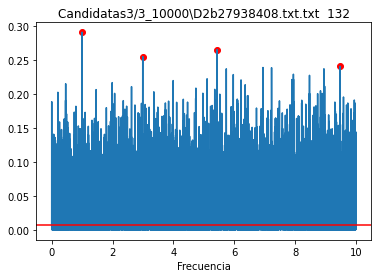

[0.19152574674183867] [0.14702654797569592]
[0.11824609507994929] [0.1521678506486701]
[0.1031243877250515] [0.15879711015013118]
[0.10660576465755146] [0.1600438995278634]


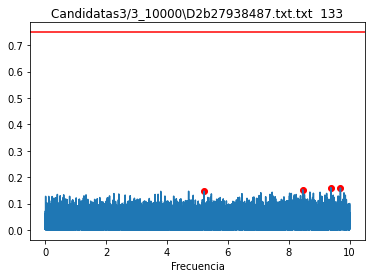

[0.46487703581917095] [0.18099898924758123]
[0.17959773598554138] [0.18471320982469258]
[0.8708550423337756] [0.1914065083586916]
[0.3363795293544498] [0.1934989844178655]


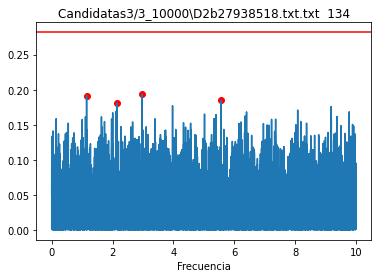

[0.871614023485962] [0.21596796352112194]
[0.11672794314627434] [0.22234912000746102]
[6.794085580652479] [0.22671452945109108]
[0.1954064070755304] [0.242814946730419]


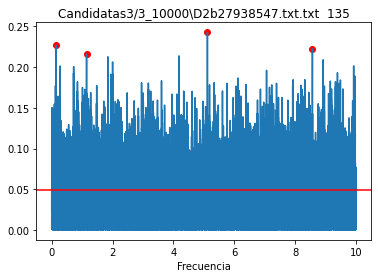

[0, 9, 13, 18, 23, 30, 32, 34, 40, 43, 46, 53, 55, 56, 58, 59, 62, 65, 80, 93, 100, 103, 114, 122, 123, 126, 127, 129, 130, 131, 133, 134]


In [7]:
periodos=[]
poderes=[]
pre=[]
lombs=[]
for i in range(len(Tiempos)):
    frequency=np.linspace(1/(1000),1/(0.1), 100000) 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    power= LombScargle(t, y).power(frequency)
    fap=LombScargle(Tiempos[i], Intensidad[i], Error[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[i][1])
    powerpeaks=lombs[i][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    pod=[]
    for j in range(4):
        indice1=np.where(lombs[i][1]==pp[j])[0]
        plt.scatter(lombs[i][0][indice1],lombs[i][1][indice1],c="r")
        Periodo1=1/lombs[i][0][indice1]
        poder1= lombs[i][1][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        poder1= sorted(poder1, reverse=True)
        print(Periodo1, poder1)
        per.append(Periodo1)
        pod.append(poder1)

    periodos.append(per)
    poderes.append(pod)
    plt.plot(lombs[i][0],lombs[i][1])
    plt.axhline(lombs[i][2], c="r")
    plt.xlabel("Frecuencia")
    plt.title(archivos[i]+ "  "+ str(i))
    plt.show()

eliminar=[]
for i in range(len(Tiempos)):
    if poderes[i][0][0]<lombs[i][2]:
        eliminar.append(i)

mask = np.ones(len(Tiempos), dtype=bool)
mask[eliminar] = False
Tiempos = [Tiempos[i] for i in range(len(Tiempos)) if mask[i]]

mask = np.ones(len(Intensidad), dtype=bool)
mask[eliminar] = False
Intensidad = [Intensidad[i] for i in range(len(Intensidad)) if mask[i]]

mask = np.ones(len(archivos), dtype=bool)
mask[eliminar] = False
archivos = [archivos[i] for i in range(len(archivos)) if mask[i]]

print(eliminar)

In [8]:
len(archivos)

104

In [9]:
colores=["b","r","g","black"]
multiplos=[0.25,0.5,1,2,4]

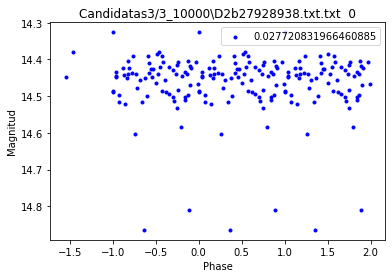

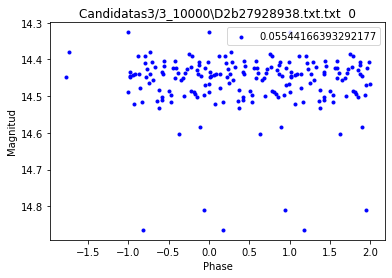

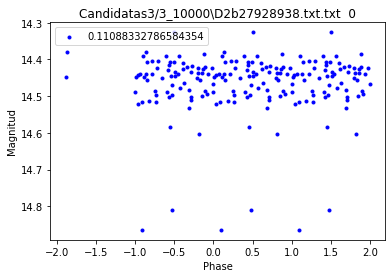

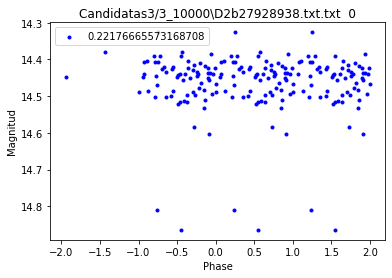

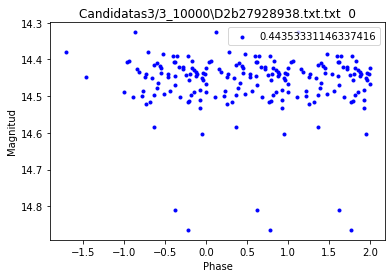

...

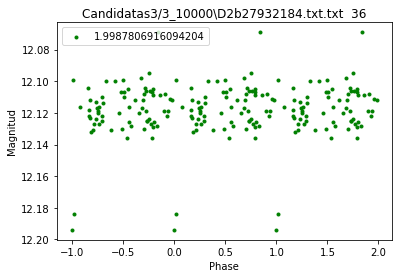

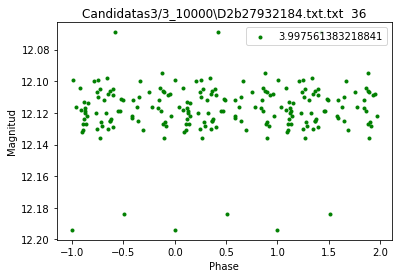

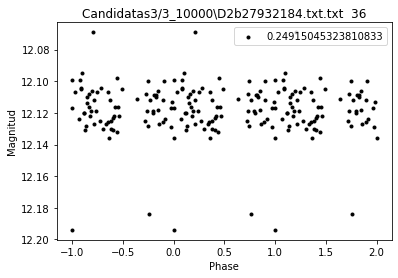

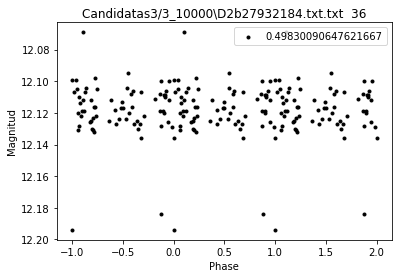

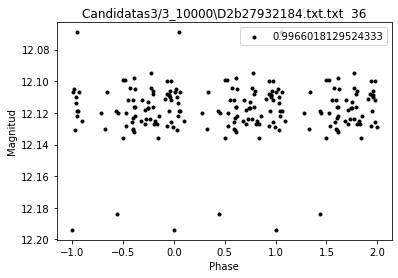

KeyboardInterrupt: 

In [24]:
for i in range(len(Tiempos)):
    for j in range(4):
        for g in range(5):
            peri=periodos[i][j][0]
            T,I=Fases(Intensidad[i],peri*multiplos[g],Tiempos[i])  

            plt.scatter(T,I,c=colores[j], label=peri*multiplos[g],marker=".")
            plt.scatter(T-1,I,c=colores[j],marker=".")
            plt.scatter(T+1,I,c=colores[j],marker=".")
            plt.title(archivos[i] + "  "+ str(i))
            plt.gca().invert_yaxis()
            plt.xlabel('Phase')
            plt.ylabel('Magnitud')
            plt.legend()
            plt.show()

In [10]:
def evaluar_estrella(i,f_men,f_max,p,g):
    fig,ax = plt.subplots(ncols=2, figsize=(16,4))

    periodos=[]
    poderes=[]
    pre=[]
    lombs=[]
    frequency=np.linspace(f_men,f_max, 100000) 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    power= LombScargle(t, y).power(frequency)
    fap=LombScargle(Tiempos[i], Intensidad[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[0][1])
    powerpeaks=lombs[0][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    pod=[]
    for j in range(4):
        indice1=np.where(lombs[0][1]==pp[j])[0]
        plt.sca(ax[0])
        plt.scatter(lombs[0][0][indice1],lombs[0][1][indice1],c="r")
        Periodo1=1/lombs[0][0][indice1]
        poder1= lombs[0][1][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        poder1= sorted(poder1, reverse=True)
        print(Periodo1, poder1)
        per.append(Periodo1)
        pod.append(poder1)

    periodos.append(per)
    poderes.append(pod)
    plt.plot(frequency,power)
    #plt.axhline(lombs[0][2], c="r")
    plt.xlabel("Frecuencia")
    plt.title(archivos[i]+ "  "+ str(i))

    peri=periodos[0][p][0]
    T,I=Fases(Intensidad[i],peri*g,Tiempos[i])  
    plt.sca(ax[1])
    plt.scatter(T,I,c=colores[j], label="P: "+str(peri*g),marker=".")
    plt.scatter(T-1,I,c=colores[j],marker=".",label="f: "+str(1/(peri*g)))
    plt.scatter(T+1,I,c=colores[j],marker=".")
    plt.title(archivos[i] + "  "+ str(i))
    plt.gca().invert_yaxis()
    plt.xlabel('Phase')
    plt.ylabel('Magnitud')
    plt.legend()
    plt.show()
    return archivos[i],peri*g


In [11]:
candidatas=[]

[0.871614023485962] [0.21596796352112194]
[0.11672794314627434] [0.22234912000746102]
[6.794085580652479] [0.22671452945109108]
[0.1954064070755304] [0.242814946730419]


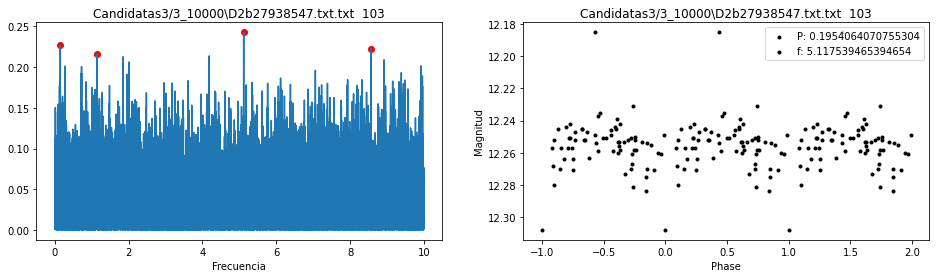

In [182]:
estrella=103
frecuencia_menor=1/1000
frecuencia_mayor=1/0.1
periodo=3
multiplo=1
can=evaluar_estrella(estrella,frecuencia_menor,frecuencia_mayor,periodo,multiplo)
#candidatas.append(can)

In [319]:
candidatas_3=candidatas
candidatas_3

[('Candidatas3/3_10000\\D2b27930802.txt.txt', 0.49872574298410544),
 ('Candidatas3/3_10000\\D2b27931260.txt.txt', 1.4615847295900533),
 ('Candidatas3/3_10000\\D2b27932820.txt.txt', 0.5981757013934463),
 ('Candidatas3/3_10000\\D2b27934608.txt.txt', 0.3190435916745099),
 ('Candidatas3/3_10000\\D2b27936130.txt.txt', 0.1384707415320833),
 ('Candidatas3/3_10000\\D2b27936854.txt.txt', 13.477549950995137),
 ('Candidatas3/3_10000\\D2b27937240.txt.txt', 1.4097760956411818)]

In [184]:
list_of_strings=archivos
list_of_tuples = [('Candidatas3/3_10000\\D2b27930802.txt.txt', 0.49872574298410544),
 ('Candidatas3/3_10000\\D2b27931260.txt.txt', 0.7307927973861678),
 ('Candidatas3/3_10000\\D2b27932820.txt.txt', 0.5981757013934463),
 ('Candidatas3/3_10000\\D2b27934608.txt.txt', 0.15952179583725495),
 ('Candidatas3/3_10000\\D2b27936130.txt.txt', 0.1384707415320833),
 ('Candidatas3/3_10000\\D2b27936854.txt.txt', 13.477549950995137),
 ('Candidatas3/3_10000\\D2b27937240.txt.txt', 1.4097760956411818)]

result = find_matching_indices(list_of_strings, list_of_tuples)
print("Indices of matching strings:", result)

Indices of matching strings: [18, 25, 43, 64, 82, 91, 98]


In [186]:
for i in range(len(list_of_tuples)):
    dat=np.loadtxt(archivos[result[i]])
    export_csv(dat, list_of_tuples[i][0])

In [187]:
archivos=glob("Candidatas3/6_10000/*.txt")
Tiempos=[]
Intensidad=[]
Estrellas=[]
Error=[]
n=len(archivos)
i=0
while(i<n):
    Datos=np.loadtxt(archivos[i])
    Estrellas.append(archivos[i])
    Tiempos.append(Datos[:,0])
    Intensidad.append(Datos[:,1])
    Error.append(Datos[:,2])
    i=i+1
print(len(archivos))

123


[0.5001700244966721] [0.2035219079781439]
[0.5081499737121227] [0.20629649986868434]
[0.4995204855099947] [0.21437185265566125]
[1.0005902140457974] [0.2343003757556352]


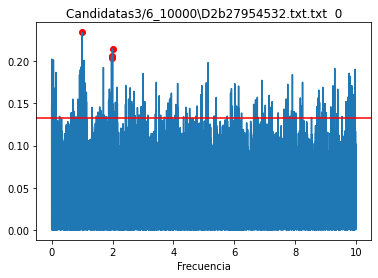

[0.32381090492310316] [0.33415020324550554]
[0.4795214642499292] [0.3606275842894165]
[0.47887855099479043] [0.36861575735211305]
[0.9212324300678791] [0.38957434427386955]


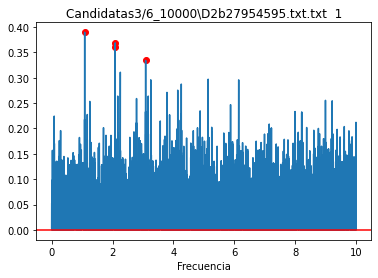

[3.9764996066804907] [0.24813112192751569]
[0.13421684765345318] [0.25447346157556683]
[0.1200818882609444] [0.25865576206357976]
[0.9785615664594436] [0.27669020257474297]


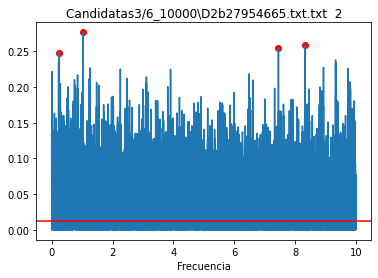

[0.1186768717596907] [0.2364358558297428]
[1.285462587786243] [0.24015614198492755]
[0.3441347434794658] [0.26141870542357953]
[0.10608670741289915] [0.27977883729611314]


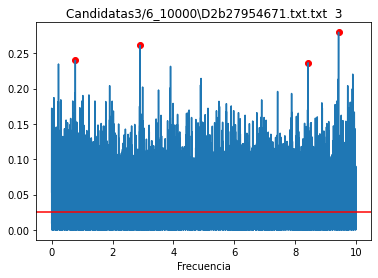

[0.29839180753757955] [0.19461233201348255]
[0.42529873303006] [0.20226795738481868]
[0.15726910959809792] [0.2026403792143131]
[1.4431311386812526] [0.20719564779789484]


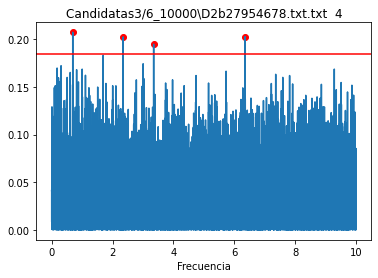

[1.4342318656347666] [0.5466781156074544]
[0.37036254329701795] [0.6149203011664001]
[0.36997890410989925] [0.6566917348301397]
[0.588219007208502] [0.7874567313946829]


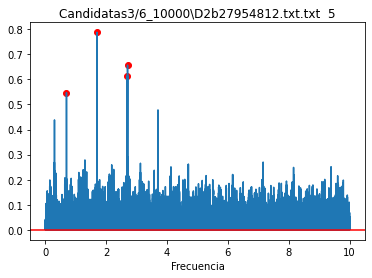

[1.0711041154459555] [0.1495624075499787]
[1.0005902140457974] [0.15348837868113532]
[0.9967011354283704] [0.16381785542373264]
[303.0493126772856] [0.17492986920550338]


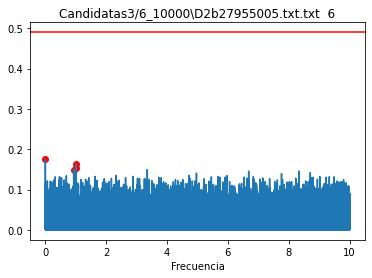

[0.480166106098343] [0.17207536899815434]
[1.6032219696962047] [0.1788087772634135]
[1.6099321701424887] [0.18401670506695927]
[2.6387592915272102] [0.19038657159769612]


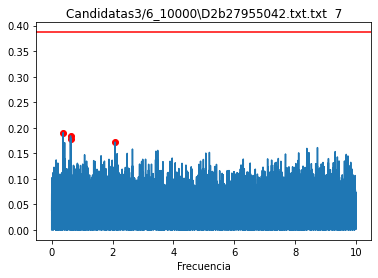

[0.9969992216748045] [0.18249660378224233]
[0.1091574890771285] [0.18270385215306445]
[0.12369390959621716] [0.18786567145049304]
[0.49922126694279073] [0.1914679411343206]


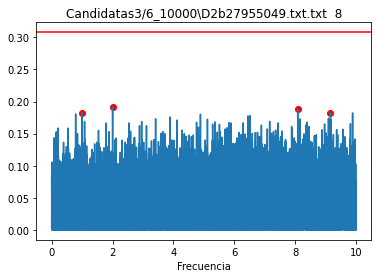

[0.23227117265355315] [0.21069520277238485]
[0.12129507199224412] [0.2126448404654271]
[0.35247946190906] [0.21315016523443706]
[0.3025441619582534] [0.2206928242180343]


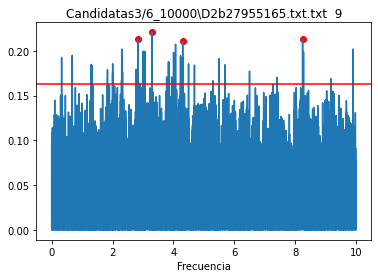

[0.28128761424382154] [0.21725584828191763]
[0.13637094970086822] [0.21767351140549013]
[0.11210514504096268] [0.21939001746297326]
[0.19695728209090177] [0.2366084933154373]


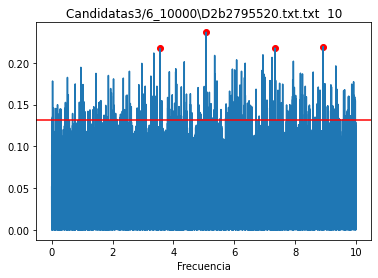

[0.4563495176478832] [0.6159940401139332]
[0.23859385139929998] [0.6247545188837533]
[0.4569333247465564] [0.6248703208178057]
[0.3133506644932071] [0.8536297573174237]


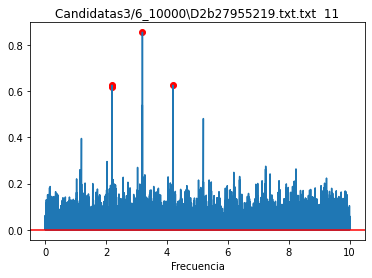

[0.29262076328009995] [0.21060120549592848]
[0.4136705707175817] [0.21082401420876376]
[0.10668537042075661] [0.2246036032341692]
[1.367363803562825] [0.23309114655881938]


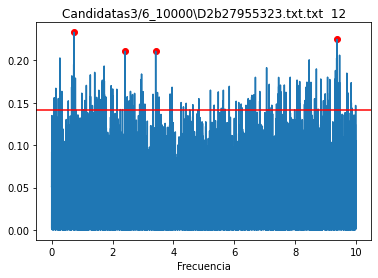

[0.3941241274980024] [0.3481921652196268]
[1.8616713355058139] [0.3772344940852859]
[0.39370520965431366] [0.44459825294576744]
[0.6505073178414117] [0.5660801578881485]


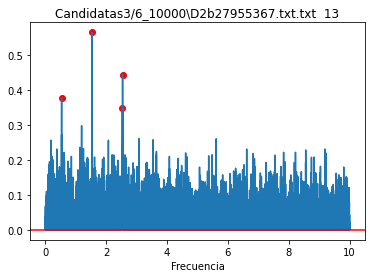

[0.48146060353606407] [0.25154794579119016]
[0.2529056206345129] [0.251627906526913]
[0.9285023910754132] [0.2717945280111743]
[13.460145322566184] [0.30106566816199376]


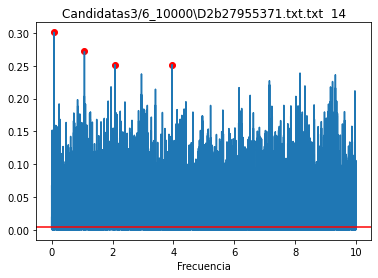

[0.35103193310104125] [0.17296336860013636]
[0.14676988491198845] [0.17334372315529623]
[0.5851559044711262] [0.18216656391458938]
[0.17209698401545676] [0.18492543624973914]


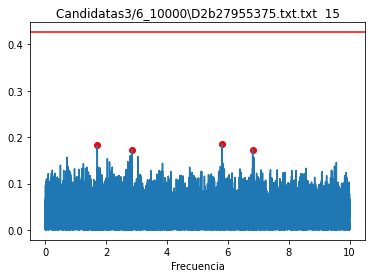

[0.2716749930858702] [0.5112485434562363]
[0.3730147981896277] [0.5687133075331539]
[0.37339082115903727] [0.6501950425665619]
[0.5958946287106119] [0.7199051600651151]


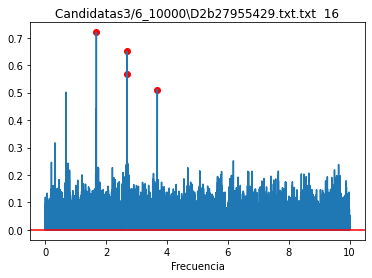

[0.1081868434204639] [0.15390461915259043]
[0.10902183501988966] [0.15756288912809946]
[0.17101986962747912] [0.16014438775863982]
[0.14402839927373703] [0.1645552621131313]


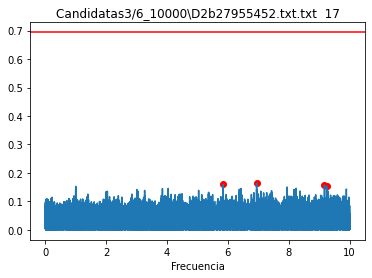

[0.81380904528502] [0.21013458495647844]
[4.4193089316098915] [0.21180294855381301]
[1.085873953596602] [0.21218623396117417]
[4.3710210470702044] [0.2168173040351864]


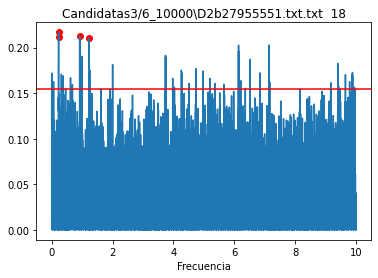

[0.11881222210026027] [0.2238140070937315]
[0.25651225656932597] [0.22463662383942018]
[0.4994705908425566] [0.22566813243043055]
[0.49597796288356444] [0.22947589184223188]


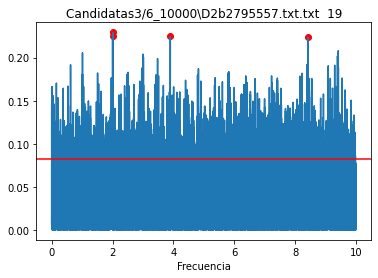

[0.12261564655105725] [0.2699490515637145]
[0.11000879981290484] [0.2762627126312517]
[3.0425608005568674] [0.27652062390393756]
[3.047196022930623] [0.2784938555812078]


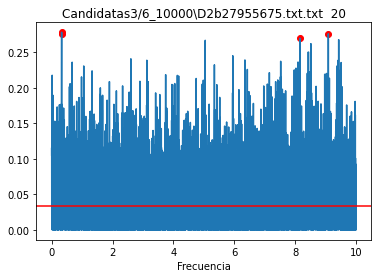

[0.10109680157507563] [0.1883215746006479]
[0.13559990736589533] [0.18880586136260802]
[0.22246963317538607] [0.1916183046750263]
[0.2621261723605444] [0.1990586276440072]


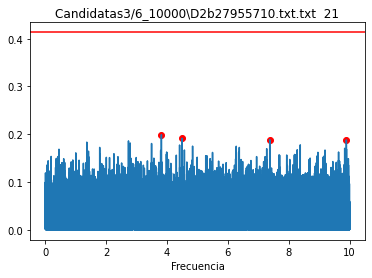

[0.16625494464814616] [0.2805695137725631]
[0.16205499561105308] [0.29726028788690734]
[0.195246181606924] [0.3206655044429821]
[0.2427756438192229] [0.32926002759688505]


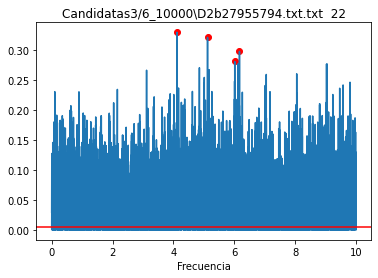

[8.039302937228896] [0.19643092316396896]
[0.13034054884972793] [0.20159161961352756]
[0.12220511480153719] [0.20182774335343193]
[0.8893640986661859] [0.2132711287374584]


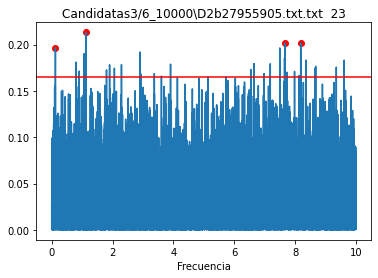

[0.2604740162927189] [0.5202031399072442]
[0.3522187706198635] [0.5864837918609587]
[0.35256644478133914] [0.664095144499699]
[0.5445926595418531] [0.7491007969322888]


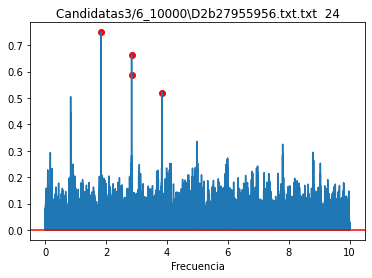

[0.23009087502373177] [0.6019900535372158]
[0.15757637745877506] [0.6561187104235338]
[0.23023919429916895] [0.6915609219129057]
[0.18705158271884448] [0.8890001662482353]


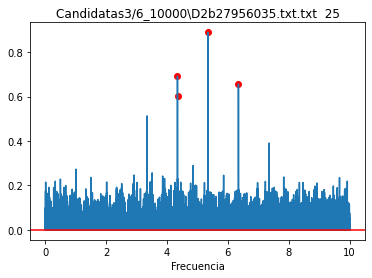

[0.11151637459031707] [0.2797261382071336]
[0.13840735105844312] [0.28091817037148265]
[0.10172820667729081] [0.2927020628746328]
[0.12157966374791947] [0.3136725562462376]


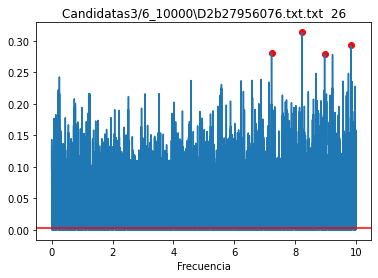

[0.157603693081056] [0.140946654129794]
[0.14082601052231772] [0.14371925357837215]
[0.23622684895558327] [0.15189336472665949]
[0.18718462082664505] [0.1559078010706078]


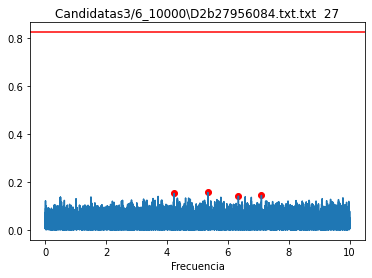

[0.17959773598554138] [0.28594279587554206]
[0.11079488162946476] [0.2901338312377111]
[0.11422942042000937] [0.3020520008248412]
[0.10042576692892274] [0.3094168879478573]


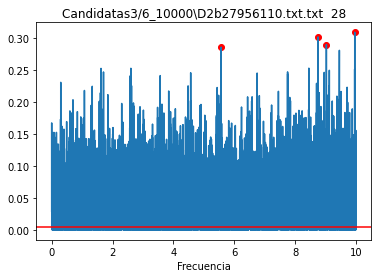

[0.32114896120696285] [0.23562400899724395]
[0.1842702619009301] [0.24201762018875148]
[0.10118271953597173] [0.24882684751499246]
[0.4730570769696349] [0.24950639448494408]


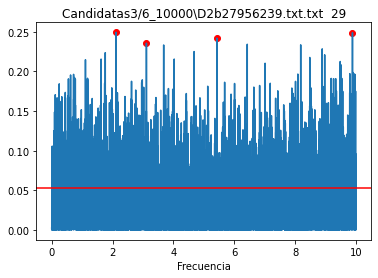

[1.0018933268097403] [0.25245023596298843]
[0.11611266542240484] [0.25641047997287125]
[0.13141441712076155] [0.2598172458556507]
[0.15129496768372988] [0.26887447901679773]


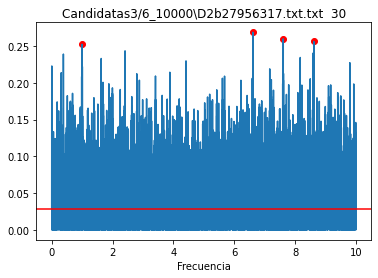

[0.2813034382541232] [0.25207438064357923]
[0.10326600992359311] [0.26483232583028404]
[0.1440678204548531] [0.26543316878152745]
[0.12587982047006635] [0.27751466385690604]


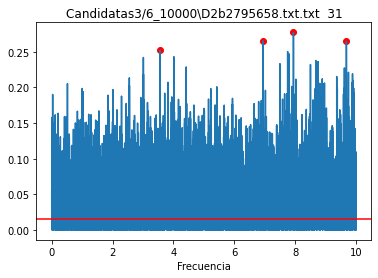

[0.9968998397836341] [0.24490254748068052]
[0.10514866678616512] [0.24623815724533302]
[0.49924618813111504] [0.2531096782657209]
[0.33269793049071583] [0.29932558453635155]


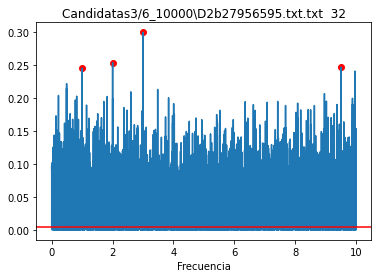

[0.4986736295765569] [0.3709931944581192]
[0.3327311371900399] [0.37778079890579785]
[0.9973969474680338] [0.40431436082131705]
[0.49932096662715] [0.41521725400940956]


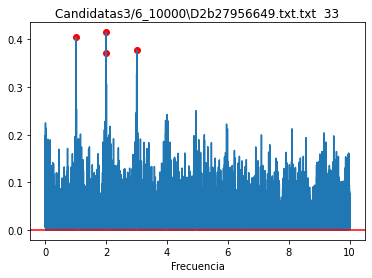

[0.11210891509747987] [0.26143211422434065]
[0.7215656162002164] [0.2648865120060701]
[0.10077895118000398] [0.27685108196945285]
[0.5043572361713697] [0.30029215862229935]


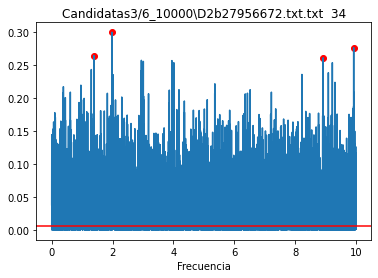

[0.11667891667527067] [0.16383621315691088]
[0.10794279538964674] [0.1683436790997377]
[0.35935680081047555] [0.16955962544680026]
[0.29839180753757955] [0.17148297391917564]


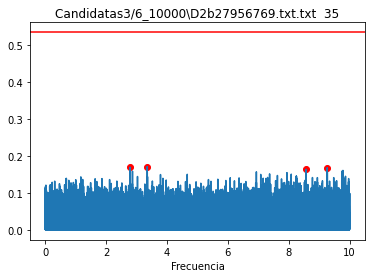

[0.2508440107408466] [0.2642426868741556]
[0.2904620786084338] [0.2706450513995644]
[0.3213346978369325] [0.27231295509000975]
[0.33484781828157584] [0.2735364136323194]


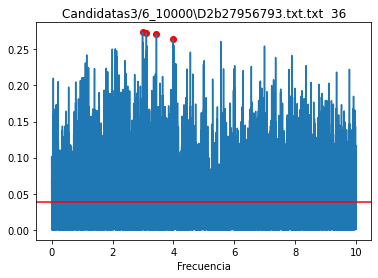

[217.40661748879802] [0.21736882686202405]
[0.40157804884968723] [0.22989728973187612]
[1.0003900359675828] [0.2330570649669288]
[0.28630442393029826] [0.23561168833787471]


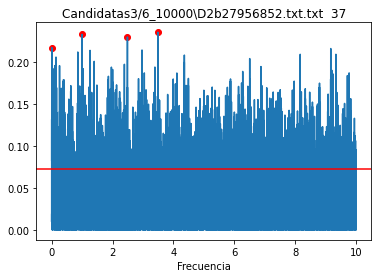

[0.21856068650912866] [0.19638967051305606]
[0.10205312405636911] [0.19958646437324606]
[0.11947792822971283] [0.21363479021107756]
[0.10703590724746669] [0.21569697274432068]


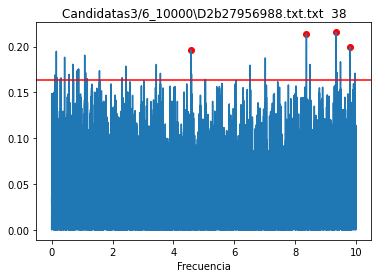

[0.2914354769696596] [0.18742124968745788]
[0.2916649604095857] [0.19207905344300158]
[0.22566734857702628] [0.19553834870658734]
[0.22580491954762358] [0.22720828415274077]


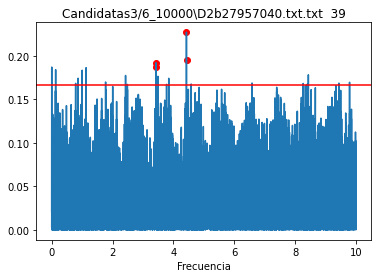

[0.3067290235830477] [0.18373031492650502]
[1.0011912292368383] [0.18427900859941074]
[0.4424589519867327] [0.18944534499150786]
[0.10739106150105643] [0.21308551900595235]


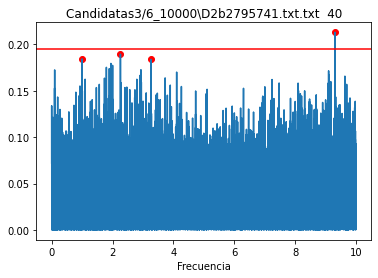

[0.19142676513489934] [0.22566517011673]
[0.1089351457634312] [0.2290944192899609]
[0.21152048179229557] [0.2298534402352595]
[0.9968998397836341] [0.2453350794896903]


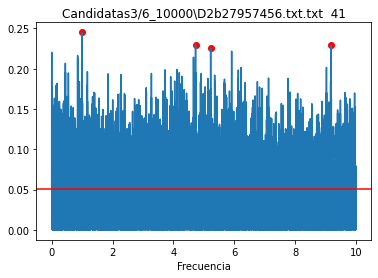

[0.4420873349876495] [0.20292610779421055]
[0.3065597834067254] [0.21590848419985298]
[0.19475569929916342] [0.23231175084703815]
[0.1629368341509504] [0.260224458125532]


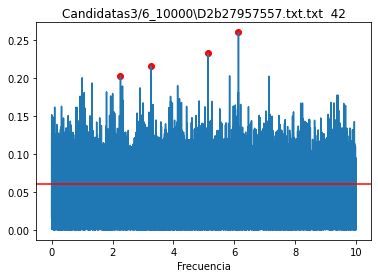

[0.10022046517954446] [0.16755235719792985]
[0.3582369082481477] [0.1710105978232393]
[0.21984831594033252] [0.17394427043861943]
[0.2066216252227375] [0.17613753652522893]


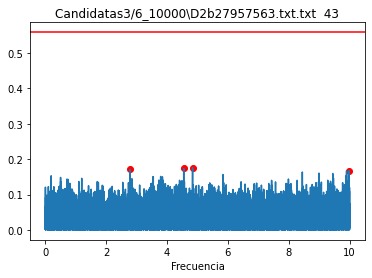

[0.1945851800697491] [0.1527828335319979]
[0.10989999990207813] [0.1536856420449778]
[0.19846205571073358] [0.1555268632658597]
[0.24160264464765116] [0.1583677171451255]


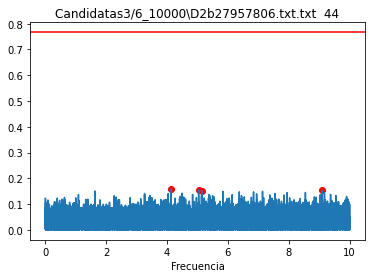

[0.332930516673044] [0.25934611839607613]
[0.1062919150414683] [0.2610634539160736]
[0.11927558508533685] [0.2651032904041752]
[0.1341898342800836] [0.28284880554331393]


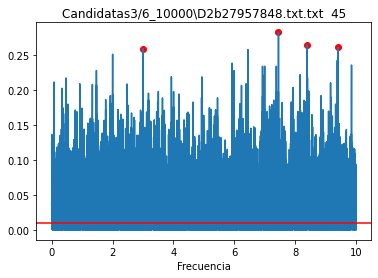

[2.404062001475195] [0.5542715734430755]
[0.41343115824240373] [0.5544311254734289]
[0.41297021589373734] [0.5794945932632971]
[0.7048346927615996] [0.7911401102282521]


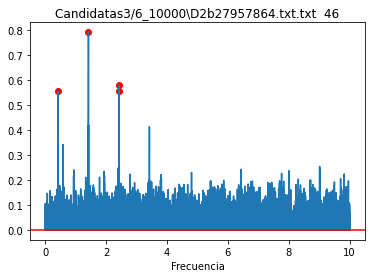

[0.1200645887190269] [0.16388291802113408]
[0.4932869510706494] [0.16469854491277408]
[0.20635729416203494] [0.16521502352477857]
[0.13209309045070505] [0.16563940530187615]


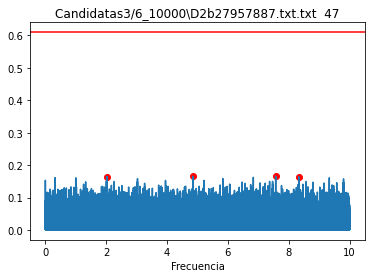

[0.3306519801756416] [0.19460523242715896]
[0.513024501294797] [0.2069225558828976]
[0.1528675361868249] [0.2086242833721972]
[0.41526801960845433] [0.22695924229981476]


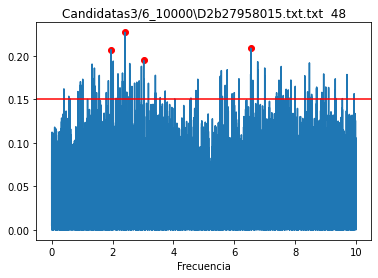

[2.0439195279577875] [0.3431183515522035]
[0.659515925638704] [0.3828976234253559]
[2.0552606329818] [0.40120788722384654]
[1.9472154083605657] [0.5440597202823668]


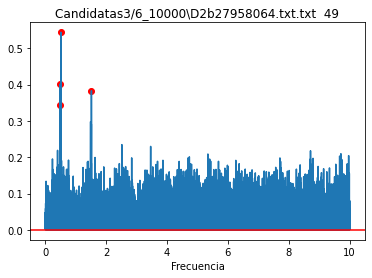

[256.42741749365337] [0.43348947415251743]
[0.9978945511688373] [0.43552639350064554]
[0.4995454365820752] [0.5041570291969864]
[1.0009908106322865] [0.569243692456546]


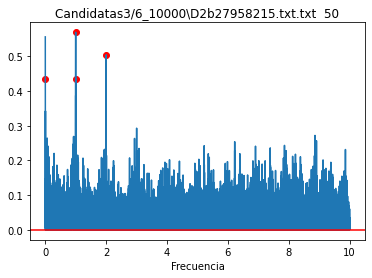

[0.29874835168803304] [0.15898397600865505]
[1.1471552027375618] [0.17382472905855426]
[0.994817387305661] [0.175606136730894]
[0.25167094125226486] [0.18349358621704273]


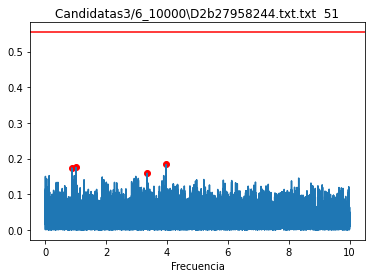

[1.4091727239152756] [0.2566896743218814]
[0.1239422478429771] [0.25718152599323724]
[0.11024284302589944] [0.2696156001654221]
[0.11511959834232338] [0.28862368990127824]


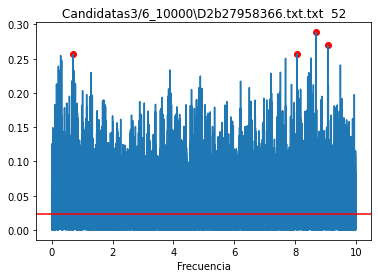

[0.2426813848962366] [0.17472141287595733]
[0.10642765161079223] [0.1801828185682876]
[303.0493126772856] [0.1808575739815753]
[0.11910370596899945] [0.1968955365960972]


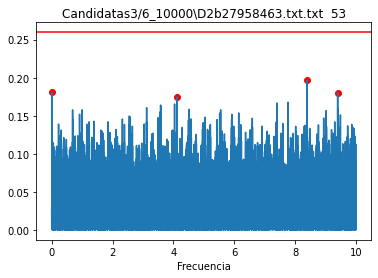

[0.12619432146905682] [0.29344681709694415]
[0.14338618972513223] [0.30886285381666573]
[0.29163944440415407] [0.3318874256083514]
[0.412170281858665] [0.3476483462845429]


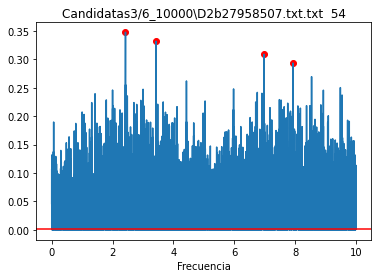

[0.29839180753757955] [0.15302323199578363]
[0.12120686915577208] [0.1535528340622056]
[0.5374227312741238] [0.16193599571516812]
[0.10540910858407533] [0.16830369406647616]


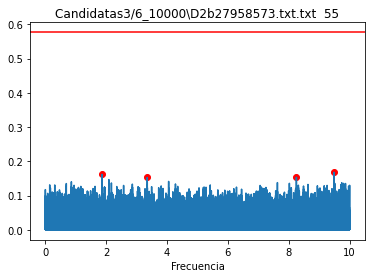

[0.12266226732573614] [0.2725181793571004]
[0.10863222602409486] [0.2757614936814997]
[0.12011794498963523] [0.2867882151092865]
[0.16038135166302658] [0.2957880999090167]


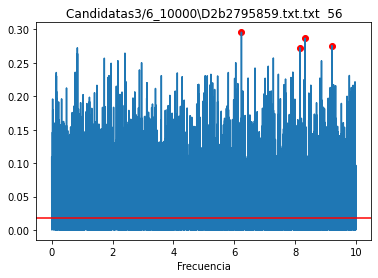

[0.10345829968021042] [0.1594458557913277]
[0.6131007563856753] [0.1638106748142553]
[0.15298211727030003] [0.16900077075572723]
[0.12648319791780263] [0.1765971011053604]


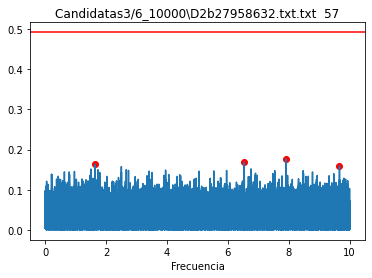

[0.23481802955275036] [0.27355135470272823]
[0.10622643307163958] [0.2827346034986665]
[0.2329094734476702] [0.28406719516917317]
[1.716597759168642] [0.32931944921075557]


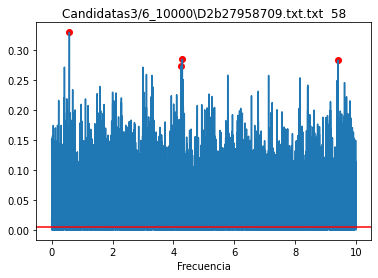

[0.41549230228618744] [0.20969172648342743]
[0.900657355848011] [0.2138930578687303]
[0.337856821928565] [0.22811075730230754]
[0.1091574890771285] [0.24129357100407237]


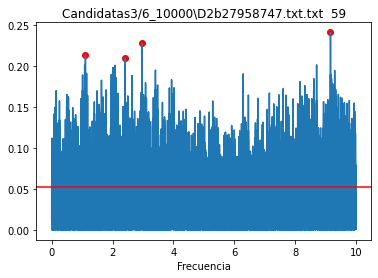

[0.10698895966568218] [0.256391935193896]
[0.11984732803019425] [0.2658414379824048]
[0.11988611822225731] [0.29382191442530886]
[0.1070210169685863] [0.3169015217946692]


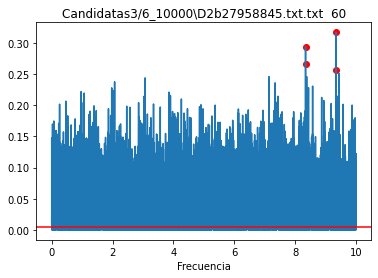

[0.9004951629283543] [0.6289912566370442]
[1.120800076340698] [0.6700916674734608]
[1.1242017848613093] [0.6957834677227773]
[9.042397785747827] [0.8186840628722313]


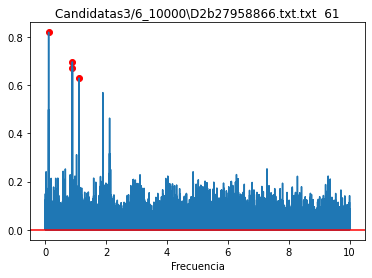

[833.3458336458411] [0.43603975801966116]
[256.42741749365337] [0.5062661767113259]
[1.0011912292368383] [0.5368585413850674]
[0.9961054973530274] [0.5788586898536953]


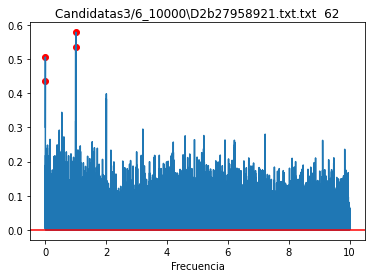

[0.13211577546425152] [0.15562037104820234]
[0.5311716386183725] [0.15813117419821116]
[0.15222996762342195] [0.16196890648940263]
[0.35103193310104125] [0.16503669387369976]


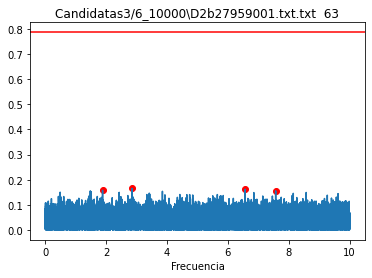

[0.4838364612729868] [0.49124851581948376]
[0.9373792526275473] [0.5679824647478883]
[0.9398458081066798] [0.5806607290545045]
[15.6263844138383] [0.7717566097735812]


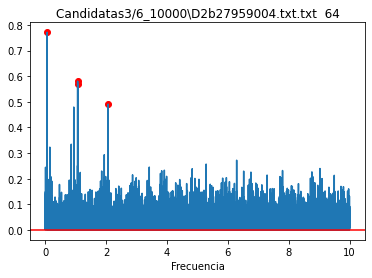

[0.49899708815820315] [0.23810359884392746]
[0.33288618947446885] [0.23980478624725557]
[0.13811299340838926] [0.24078608386397637]
[0.16031450789015458] [0.27427388220190196]


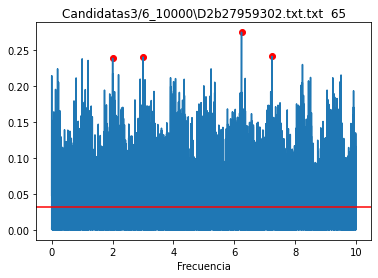

[0.15009605215231944] [0.3007799120035623]
[0.19814356015418066] [0.3018147536340801]
[0.11540387706133308] [0.3064095630091657]
[0.13046126917715198] [0.32162840355552896]


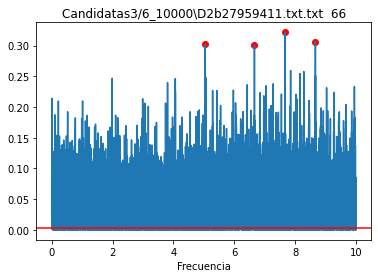

[0.1479248011605633] [0.17954446286769143]
[303.0493126772856] [0.18952647729514982]
[0.9967011354283704] [0.19737819779109714]
[0.12002568296838907] [0.2275266911172004]


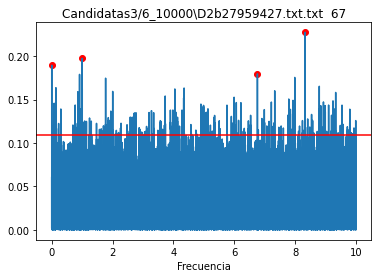

[0.22626470331109505] [0.20847677684543073]
[0.1344749222666326] [0.2120805049731034]
[0.1533692177641225] [0.21894729806287708]
[0.14439856134274676] [0.23836488202367084]


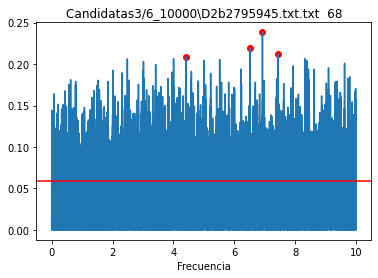

[0.2494736545963943] [0.19119272413860697]
[0.49859904483123857] [0.2349323352977047]
[0.9971980449138503] [0.2404565965978087]
[0.33269793049071583] [0.2604316519535587]


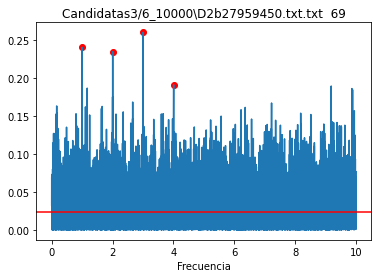

[3.4051402877345076] [0.1674381640910704]
[0.541731195623323] [0.16808707802105724]
[384.636687783432] [0.1696530311446048]
[0.5006457568773908] [0.17339246257433977]


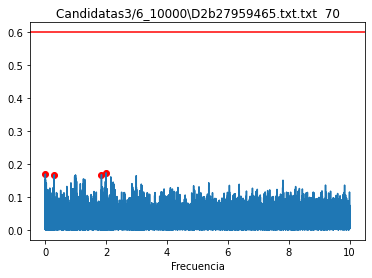

[0.3210458669397074] [0.21706112797084615]
[0.7867909198195543] [0.2190751812388796]
[0.15347984149818647] [0.22878106012043858]
[0.24286407808371913] [0.242750418240685]


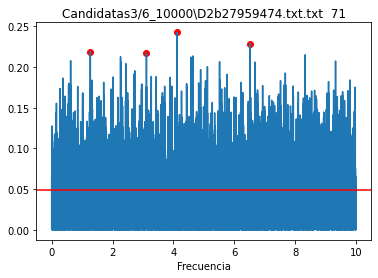

[0.41774852606506796] [0.22936706678704286]
[0.13235181200958746] [0.22951831542146686]
[0.11688209977098535] [0.23357725110751046]
[0.12009198196279175] [0.2706051273779591]


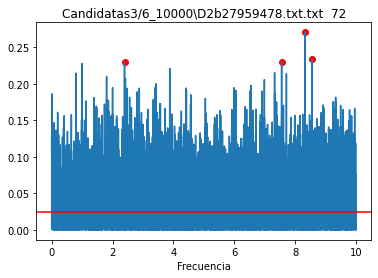

[0.22626470331109505] [0.20847677684543073]
[0.1344749222666326] [0.2120805049731034]
[0.1533692177641225] [0.21894729806287708]
[0.14439856134274676] [0.23836488202367084]


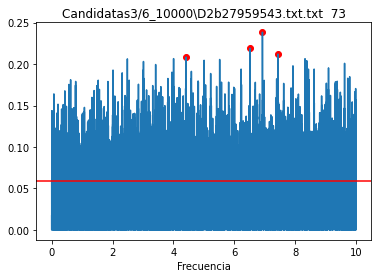

[0.1575937590318379] [0.1971463036512604]
[1.0996040791936619] [0.20181987319962558]
[0.31027859924082696] [0.20298691892998816]
[0.12072258010849345] [0.21954071898771657]


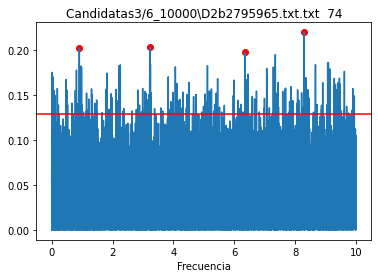

[0.39635778904769003] [0.2546571925823978]
[0.10661712963523154] [0.28068059399517653]
[0.17737753060113612] [0.2849398092901694]
[0.21399165288107952] [0.2906012040874256]


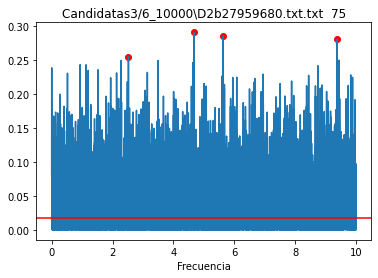

[0.2620437535476493] [0.2160362791665654]
[0.2873243839282671] [0.21648461021163395]
[0.25651225656932597] [0.22128714417433493]
[0.3453349371262595] [0.24928552872980714]


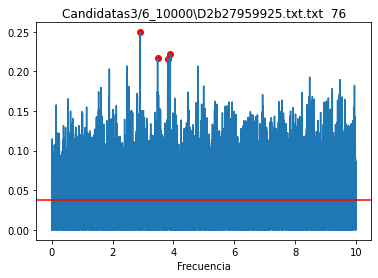

[4.003561443732323] [0.41096834508871893]
[1.332742389448413] [0.49362668987144637]
[1.327964266992648] [0.5276088641128461]
[0.5704368912026269] [0.6556227137452068]


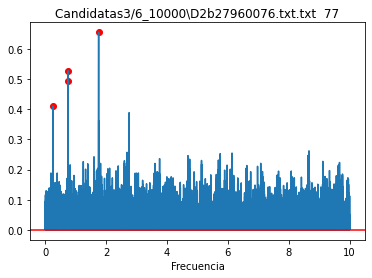

[15.129934147816092] [0.18129314917380313]
[0.9357128787222294] [0.21041096567348241]
[0.4833921240713702] [0.21956153163691944]
[0.9379946769582971] [0.23908536900697333]


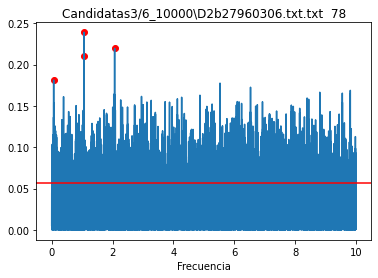

[0.2476267082755014] [0.1359610617926669]
[1.2872826530233936] [0.1411989798704065]
[0.10205416545727444] [0.1435425980294999]
[0.10540910858407533] [0.15206268549112975]


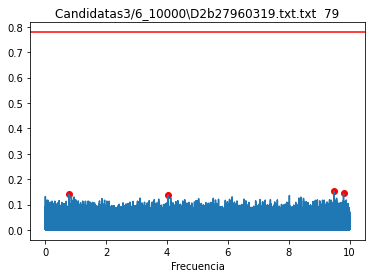

[0.13238334728773674] [0.13880644953980417]
[131.5892322086289] [0.14839415362400774]
[303.0493126772856] [0.14886585113199968]
[0.1200271234724777] [0.15958422765783783]


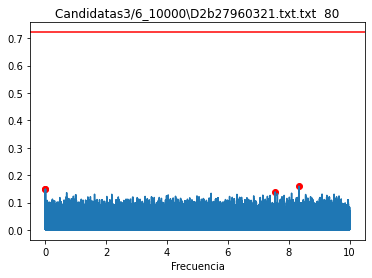

[0.14222794189076526] [0.26533207510056217]
[0.9970986233829006] [0.279816583025749]
[0.33269793049071583] [0.2815125659637631]
[0.12451784775242764] [0.29052031274414014]


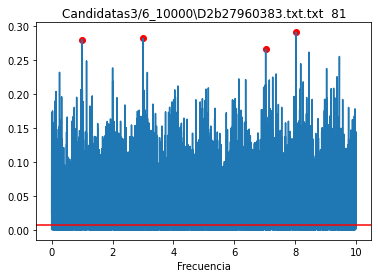

[0.403734194284118] [0.2599085162055533]
[0.30519392765439884] [0.26035921843880466]
[0.5165753938556121] [0.2641893986219742]
[0.1663877140426094] [0.2849567940198355]


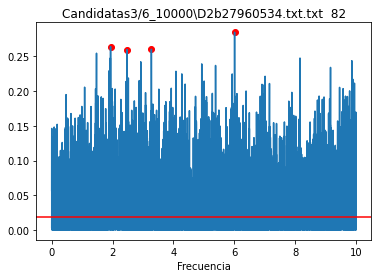

[3.935811313429579] [0.2569806334202852]
[0.1445864471059027] [0.2716010926666066]
[0.10380623192973001] [0.2724612175795175]
[0.1691026519301566] [0.3087871189962425]


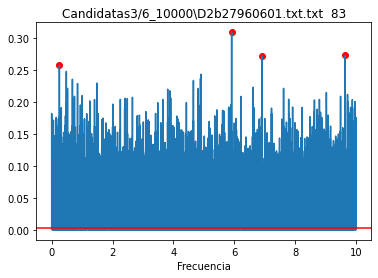

[0.11054138286444212] [0.17934859260308836]
[0.13208611201373058] [0.1798746744833876]
[0.11964087021714596] [0.1800559746121947]
[0.7941633745088924] [0.1826140892817567]


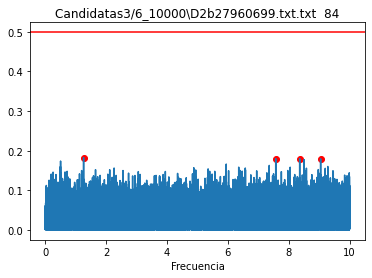

[0.13841118213862677] [0.19706148858586728]
[0.49787920754084236] [0.19940395447081474]
[0.2025950066375346] [0.20326644508361164]
[0.3320903135015052] [0.20699159870071238]


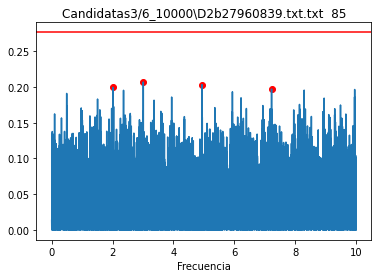

[0.16756136280788625] [0.2549465160091876]
[0.1125720394944173] [0.2578168350300451]
[0.33639084383541756] [0.27267671097295193]
[0.10115406399402474] [0.28427547959104366]


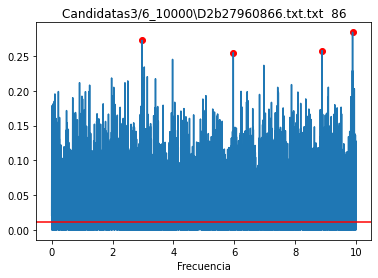

[4.072026231603775] [0.31429369973842497]
[4.118985330540139] [0.3302639953906058]
[0.8028336973096581] [0.35333075915688406]
[1.3207737587419093] [0.3931540632810351]


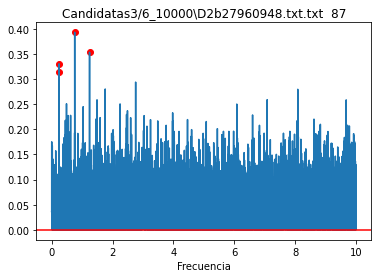

[0.7511002188472549] [0.24291549779439858]
[0.15623720843888472] [0.2616921267512701]
[0.19815141193269192] [0.28573181379874524]
[0.1350761081109732] [0.28576303337084413]


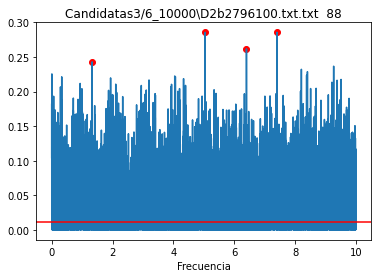

[0.34766390103178046] [0.2547013649458573]
[0.2577817264146367] [0.26913094472549953]
[0.34083906288675503] [0.2803209968058552]
[0.10079215503751135] [0.2954738462566438]


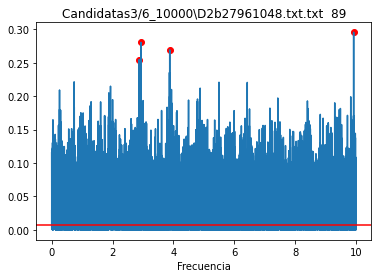

[0.5209073191908707] [0.16273946761655178]
[0.12002568296838907] [0.1647400970648097]
[1.0904916703160334] [0.16494185850914192]
[0.10293439549351346] [0.1753193536942375]


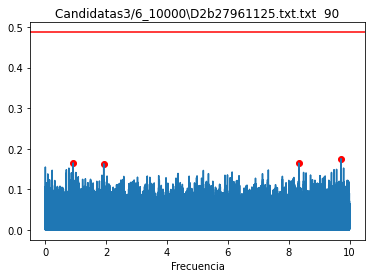

[0.49924618813111504] [0.20976278421398267]
[0.49857418820715665] [0.22078008079037542]
[0.33269793049071583] [0.2507401684216852]
[0.9969992216748045] [0.2647346333672332]


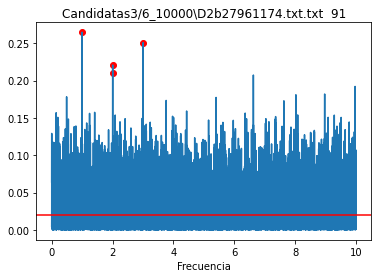

[0.2044379465237729] [0.2150378578609802]
[0.1696620625198974] [0.21807244212482335]
[0.12221855575110355] [0.23137175766035165]
[0.6384232055774435] [0.23280432823001773]


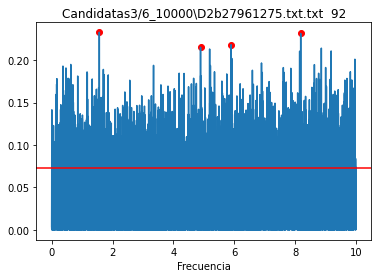

[0.11080592969191734] [0.2279350560441817]
[0.12362663146180164] [0.22837850187891295]
[0.9236999407588357] [0.23582970661076774]
[0.10211877384864207] [0.24743001291737013]


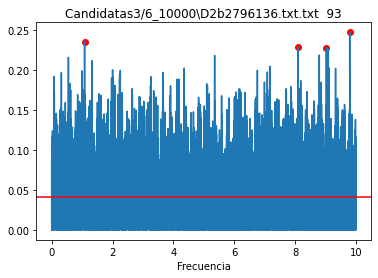

[1.0410012650165674] [0.49380091262181897]
[0.3374464279878815] [0.5000573771572253]
[0.3371279213404189] [0.5266678483582057]
[0.509340444693494] [0.7197853592252428]


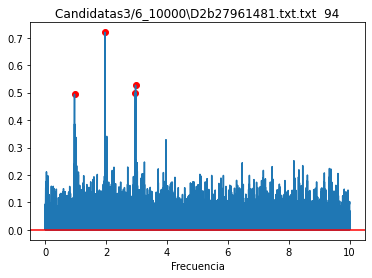

[0.11667891667527067] [0.1624851359234021]
[0.12159001082743123] [0.16275722786594482]
[0.12155158769281367] [0.16412731892800136]
[0.29839180753757955] [0.1784250315235801]


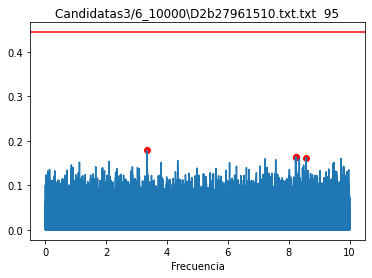

[0.15013661134439044] [0.2295903178861077]
[0.18552824270507157] [0.2298691428639929]
[0.11732361962890574] [0.23274936292658055]
[0.11489344576477178] [0.24740812807268664]


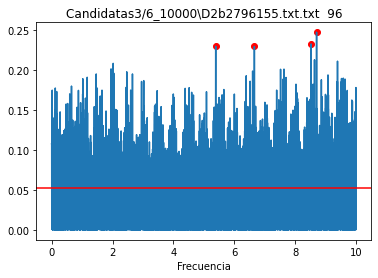

[0.1035643646048003] [0.1444513451350279]
[0.12124654455259441] [0.1449916068800809]
[0.10538023028942509] [0.14804665199347256]
[0.13538513561865698] [0.15824783471980863]


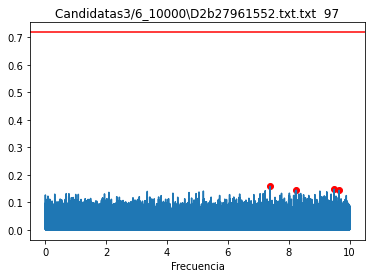

[1.184940642589546] [0.2701478113172401]
[6.050148000200383] [0.2711421369133085]
[1.754235837754578] [0.28308769370088305]
[0.11350728637402084] [0.2895243636712599]


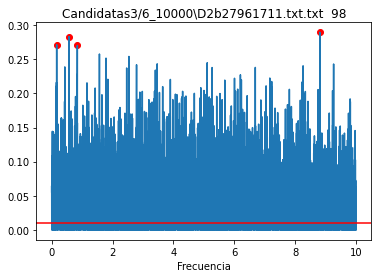

[0.11006206932123382] [0.2191311068831969]
[0.13569005709155182] [0.22180530945035687]
[0.12068615952527056] [0.23063189200203377]
[0.11943940169233734] [0.241669236935733]


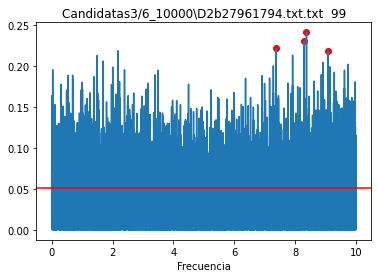

[0.11349569308819708] [0.2421250625324987]
[1.1881785696259168] [0.24507879132937307]
[5.450079119589774] [0.24729593342188524]
[0.8474620224741042] [0.26303221374506974]


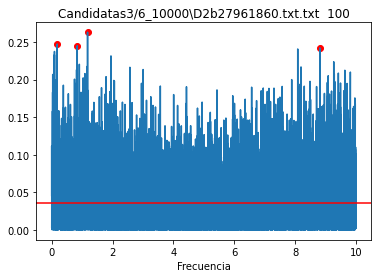

[1.4431311386812526] [0.19316368968199668]
[0.12221855575110355] [0.1949493013757999]
[0.23031872973841397] [0.20888751565039645]
[0.10794279538964674] [0.21217248185473905]


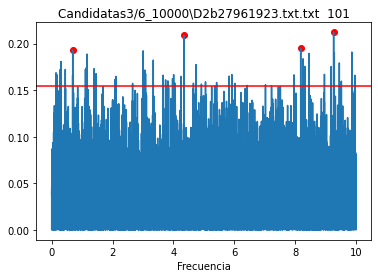

[0.29308383864862897] [0.2271738697636185]
[0.19533389156411093] [0.2279957442617531]
[0.9970986233829006] [0.24167360354735593]
[0.10457473279254584] [0.24473123975792524]


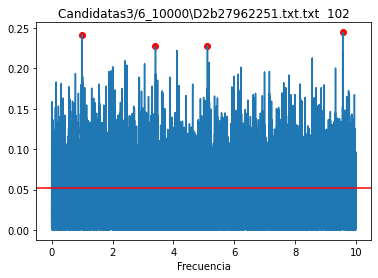

[0.12002568296838907] [0.14429618328783028]
[0.12026528111595443] [0.14479448534326897]
[0.29839180753757955] [0.14785101299448491]
[0.1200645887190269] [0.15189062622399788]


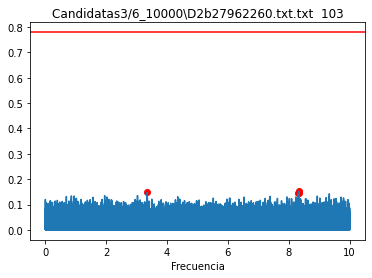

[0.9945206041021224] [0.2092240249976438]
[0.16098546343717454] [0.21242827148999008]
[0.10510004619161692] [0.21292208732843373]
[0.10738990833322687] [0.27889273573894957]


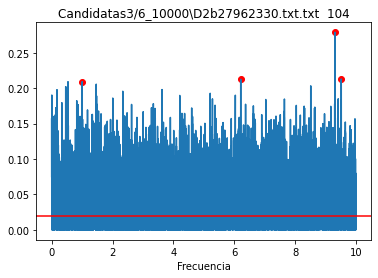

[0.2051845449482867] [0.19597902722516022]
[0.9968998397836341] [0.20592990013407894]
[0.4985244823933052] [0.22202111609906172]
[0.33267579637319006] [0.2221550256768766]


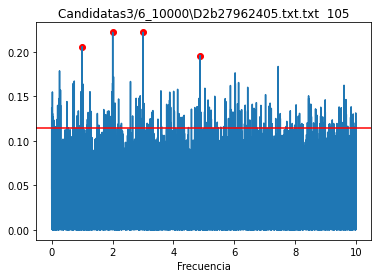

[0.18672329951346572] [0.23611226931150997]
[0.10014519746724855] [0.23853421892974908]
[0.15727652935217284] [0.24828253488881355]
[0.9970986233829006] [0.2891592047181464]


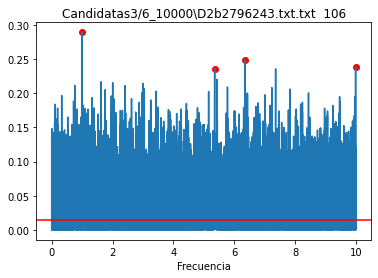

[0.15347277564099332] [0.30750491600193447]
[18.417833355987494] [0.31615211642396973]
[0.30419137440184274] [0.3271483660440582]
[0.2330886095233364] [0.330218234979381]


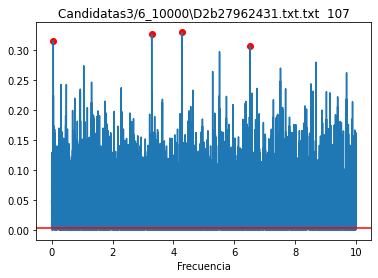

[0.996204720921913] [0.5327941396993575]
[294.1363335539378] [0.5680171011350347]
[0.9978945511688373] [0.5706452190348743]
[1.0005902140457974] [0.6047203063217479]


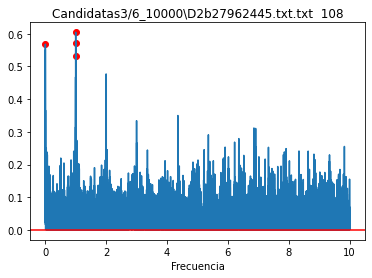

[0.300029994898599] [0.1969020391474642]
[0.8528824255788888] [0.19693665356157178]
[0.187412625251968] [0.20526329833082987]
[0.23064274076727412] [0.21975084963241387]


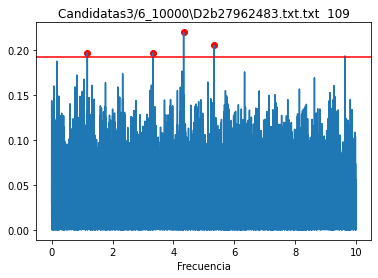

[0.21607682774869083] [0.14773099881072563]
[0.11423072515352446] [0.16107265513331223]
[0.5851216688127095] [0.16387605994271204]
[0.35824974092104844] [0.1671412281658941]


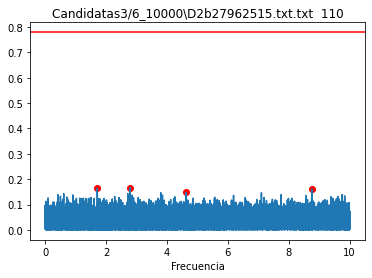

[0.10056815895869642] [0.2352982590500597]
[0.10478181146939013] [0.24265241099080964]
[0.4992711118077011] [0.24782234440791548]
[0.33269793049071583] [0.25829256468478723]


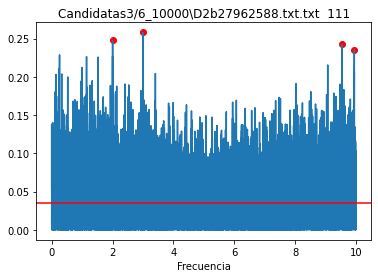

[8.170663999735268] [0.25682267005633225]
[0.24339603959528477] [0.2601372888057484]
[1.5229021957149307] [0.279308393060989]
[1.1395737311178296] [0.32536660663397976]


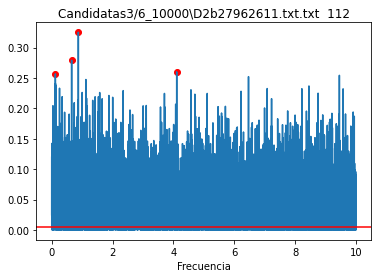

[0.41549230228618744] [0.20969172648342743]
[0.900657355848011] [0.2138930578687303]
[0.337856821928565] [0.22811075730230754]
[0.1091574890771285] [0.24129357100407237]


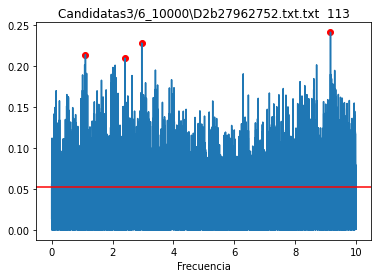

[0.4358450142817597] [0.26312000718165834]
[0.15228328160644922] [0.2647715750810256]
[0.7743031428512294] [0.2764208133125755]
[0.1508272121231685] [0.2839578066460984]


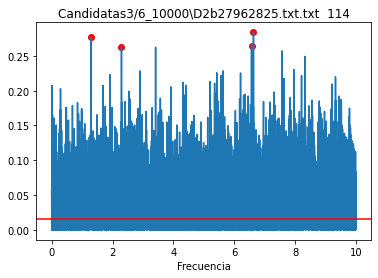

[322.6003135706405] [0.24979507433811454]
[13.055989997967162] [0.25265300069316776]
[0.16320805429618063] [0.2694940561635982]
[0.19504056311831924] [0.327506082572882]


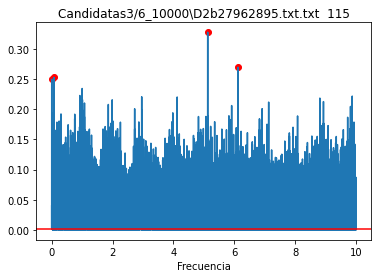

[185.1987665638803] [0.3063393410696042]
[1.001993706855473] [0.33301675533095104]
[1.0055197250101289] [0.3382103360720951]
[0.500670820493627] [0.3507652558237664]


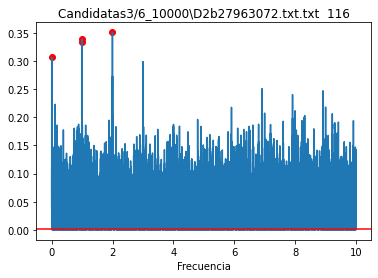

[0.1380386468704181] [0.24678170827094317]
[0.2708656044148631] [0.25062362501519614]
[0.2131342816565216] [0.2577032929590997]
[2.725040228127389] [0.2692231250044655]


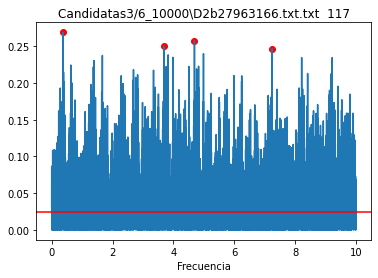

[0.12173653691249343] [0.20668502333823352]
[0.20020218420564947] [0.21921824128830303]
[0.138610690984836] [0.23369423119274843]
[0.10583074947620398] [0.23643592062124622]


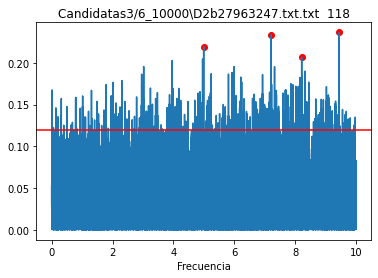

[0.9970986233829006] [0.20344391348924173]
[0.49857418820715665] [0.21163459234715595]
[0.4992711118077011] [0.2201009984023218]
[0.33269793049071583] [0.2897034052414392]


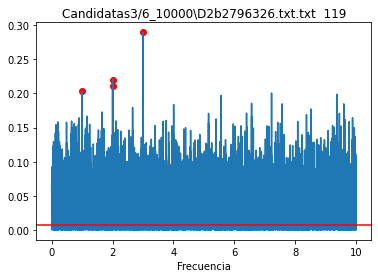

[0.15676128891499178] [0.2230079312240903]
[0.13551538595418577] [0.2284960173468338]
[0.1119783676055401] [0.24458808065128093]
[0.3300626994363981] [0.2556861758053191]


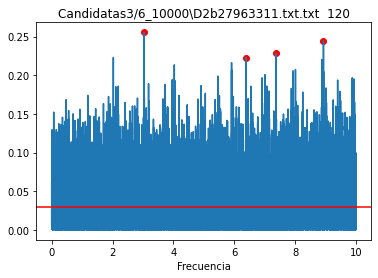

[0.49924618813111504] [0.24827069711871083]
[0.10125237920536939] [0.253415504348762]
[416.6885430339396] [0.3195264159446749]
[0.9996900430025972] [0.32736760676223375]


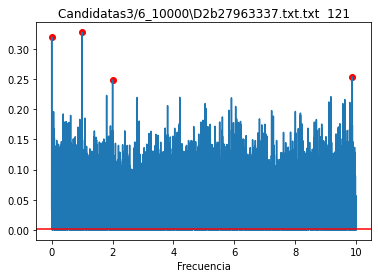

[0.10036328238354404] [0.2275938422702243]
[1.280524831936158] [0.2310693026600788]
[0.1128311294333096] [0.23537611020855906]
[0.11073599581828349] [0.2581287369730734]


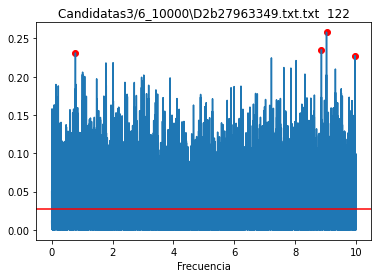

[6, 7, 8, 15, 17, 21, 27, 35, 40, 43, 44, 47, 51, 53, 55, 57, 63, 70, 79, 80, 84, 85, 90, 95, 97, 103, 110]


In [188]:
periodos=[]
poderes=[]
pre=[]
lombs=[]
for i in range(len(Tiempos)):
    frequency=np.linspace(1/(1000),1/(0.1), 100000) 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    power= LombScargle(t, y).power(frequency)
    fap=LombScargle(Tiempos[i], Intensidad[i], Error[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[i][1])
    powerpeaks=lombs[i][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    pod=[]
    for j in range(4):
        indice1=np.where(lombs[i][1]==pp[j])[0]
        plt.scatter(lombs[i][0][indice1],lombs[i][1][indice1],c="r")
        Periodo1=1/lombs[i][0][indice1]
        poder1= lombs[i][1][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        poder1= sorted(poder1, reverse=True)
        print(Periodo1, poder1)
        per.append(Periodo1)
        pod.append(poder1)

    periodos.append(per)
    poderes.append(pod)
    plt.plot(lombs[i][0],lombs[i][1])
    plt.axhline(lombs[i][2], c="r")
    plt.xlabel("Frecuencia")
    plt.title(archivos[i]+ "  "+ str(i))
    plt.show()

eliminar=[]
for i in range(len(Tiempos)):
    if poderes[i][0][0]<lombs[i][2]:
        eliminar.append(i)

mask = np.ones(len(Tiempos), dtype=bool)
mask[eliminar] = False
Tiempos = [Tiempos[i] for i in range(len(Tiempos)) if mask[i]]

mask = np.ones(len(Intensidad), dtype=bool)
mask[eliminar] = False
Intensidad = [Intensidad[i] for i in range(len(Intensidad)) if mask[i]]

mask = np.ones(len(archivos), dtype=bool)
mask[eliminar] = False
archivos = [archivos[i] for i in range(len(archivos)) if mask[i]]

print(eliminar)

In [189]:
len(archivos)

96

In [ ]:
for i in range(len(Tiempos)):
    for j in range(4):
        for g in range(5):
            peri=periodos[i][j][0]
            T,I=Fases(Intensidad[i],peri*multiplos[g],Tiempos[i])  

            plt.scatter(T,I,c=colores[j], label=peri*multiplos[g],marker=".")
            plt.scatter(T-1,I,c=colores[j],marker=".")
            plt.scatter(T+1,I,c=colores[j],marker=".")
            plt.title(archivos[i] + "  "+ str(i))
            plt.gca().invert_yaxis()
            plt.xlabel('Phase')
            plt.ylabel('Magnitud')
            plt.legend()
            plt.show()

[0.10036328238354404] [0.2275938422702243]
[1.280524831936158] [0.2310693026600788]
[0.1128311294333096] [0.23537611020855906]
[0.11073599581828349] [0.2581287369730734]


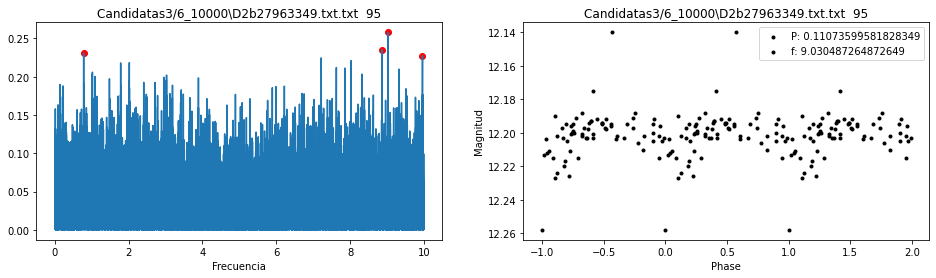

In [325]:
estrella=95
frecuencia_menor=1/1000
frecuencia_mayor=1/0.1
periodo=3
multiplo=1
can=evaluar_estrella(estrella,frecuencia_menor,frecuencia_mayor,periodo,multiplo)
#candidatas.append(can)

In [608]:
candidatas_6=candidatas
candidatas_6

[('Candidatas3/6_10000\\D2b27954595.txt.txt', 0.9212686870051477),
 ('Candidatas3/6_10000\\D2b27954812.txt.txt', 0.5882103399094495),
 ('Candidatas3/6_10000\\D2b27955219.txt.txt', 0.6267013289864142),
 ('Candidatas3/6_10000\\D2b27955367.txt.txt', 0.6505109613038774),
 ('Candidatas3/6_10000\\D2b27955429.txt.txt', 1.1918050664140014),
 ('Candidatas3/6_10000\\D2b27955956.txt.txt', 0.5445773621621023),
 ('Candidatas3/6_10000\\D2b27956035.txt.txt', 0.18705352215951707),
 ('Candidatas3/6_10000\\D2b27957864.txt.txt', 1.4096802654595455),
 ('Candidatas3/6_10000\\D2b27958064.txt.txt', 1.9473865042545657),
 ('Candidatas3/6_10000\\D2b27958866.txt.txt', 18.091967637850185),
 ('Candidatas3/6_10000\\D2b27959004.txt.txt', 15.631000898947848),
 ('Candidatas3/6_10000\\D2b27960076.txt.txt', 0.5704398133230735),
 ('Candidatas3/6_10000\\D2b27961481.txt.txt', 1.0186646700639472)]

In [326]:
list_of_strings=archivos
list_of_tuples = [('Candidatas3/6_10000\\D2b27954595.txt.txt', 0.9212686870051477),
 ('Candidatas3/6_10000\\D2b27954812.txt.txt', 0.5882103399094495),
 ('Candidatas3/6_10000\\D2b27955219.txt.txt', 0.6267013289864142),
 ('Candidatas3/6_10000\\D2b27955367.txt.txt', 0.6505109613038774),
 ('Candidatas3/6_10000\\D2b27955429.txt.txt', 0.5958946287106119),
 ('Candidatas3/6_10000\\D2b27955956.txt.txt', 0.5445773621621023),
 ('Candidatas3/6_10000\\D2b27956035.txt.txt', 0.18705352215951707),
 ('Candidatas3/6_10000\\D2b27957864.txt.txt', 0.7048346927615996),
 ('Candidatas3/6_10000\\D2b27958064.txt.txt', 1.9473865042545657),
 ('Candidatas3/6_10000\\D2b27958866.txt.txt', 9.042397785747827),
 ('Candidatas3/6_10000\\D2b27959004.txt.txt', 15.631000898947848),
 ('Candidatas3/6_10000\\D2b27960076.txt.txt', 0.5704398133230735),
 ('Candidatas3/6_10000\\D2b27961481.txt.txt', 0.509340444693494)]

result = find_matching_indices(list_of_strings, list_of_tuples)
print("Indices of matching strings:", result)

Indices of matching strings: [1, 5, 8, 10, 12, 18, 19, 35, 37, 45, 47, 59, 71]


In [327]:
for i in range(len(list_of_tuples)):
    dat=np.loadtxt(archivos[result[i]])
    export_csv(dat, list_of_tuples[i][0])

In [328]:
archivos=glob("Candidatas3/9_10000/*.txt")
Tiempos=[]
Intensidad=[]
Estrellas=[]
Error=[]
n=len(archivos)
i=0
while(i<n):
    Datos=np.loadtxt(archivos[i])
    Estrellas.append(archivos[i])
    Tiempos.append(Datos[:,0])
    Intensidad.append(Datos[:,1])
    Error.append(Datos[:,2])
    i=i+1
print(len(archivos))

115


[0.11040470712967884] [0.22994068862691175]
[0.4944576112406133] [0.240657560819571]
[1.0041063439982842] [0.2544801209731666]
[0.5010219748030724] [0.26626387289943276]


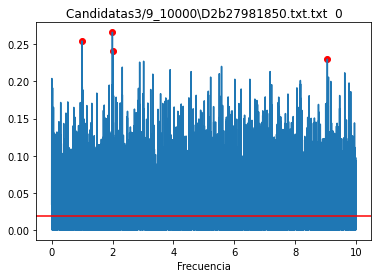

[0.24157930026972038] [0.2522610641499822]
[0.10884267110749206] [0.2587026799520827]
[0.12217824176944093] [0.26464399624292845]
[0.12268935372546481] [0.2711906705229083]


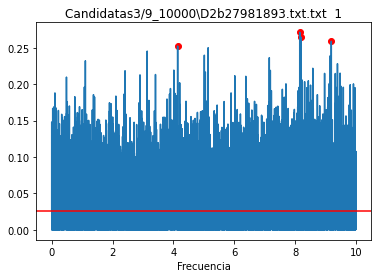

[0.16160719967274212] [0.2191525745453259]
[0.15409469732839098] [0.24432291066054343]
[0.18225206702565397] [0.2541936488434374]
[0.10980588057680038] [0.26458199769115953]


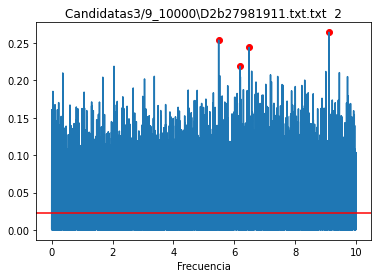

[0.2417135920832631] [0.17601503015034264]
[0.11919455547677314] [0.17817561949317479]
[0.3119821502744255] [0.18036330401371486]
[0.9970986233829006] [0.22749344430996293]


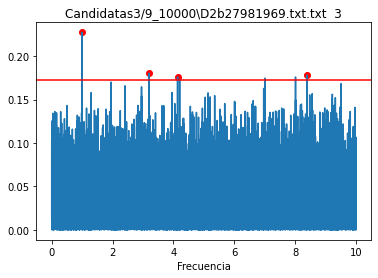

[0.35863514907857297] [0.4573501177601564]
[1.2683448254133793] [0.4617647893022709]
[0.3582625745133597] [0.5394688007071773]
[0.5591780590829419] [0.6645629646593452]


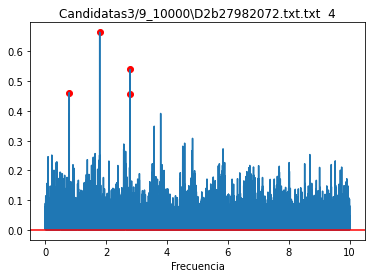

[0.1452479152884771] [0.324409635944942]
[0.1997902373330364] [0.3361718868142798]
[0.4995953462048267] [0.36829923712841794]
[0.3330524773621884] [0.3810554790685228]


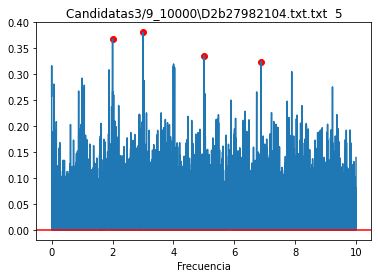

[0.33238832062049967] [0.17982876017924912]
[0.9970986233829006] [0.2122953442175152]
[0.49857418820715665] [0.22519778394827067]
[0.33269793049071583] [0.22865804970094092]


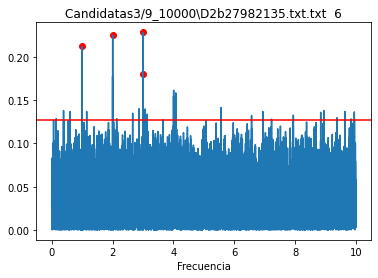

[0.49857418820715665] [0.1960366092225495]
[0.49924618813111504] [0.20336003679260042]
[0.9970986233829006] [0.2052535046225898]
[0.33269793049071583] [0.2495983880071878]


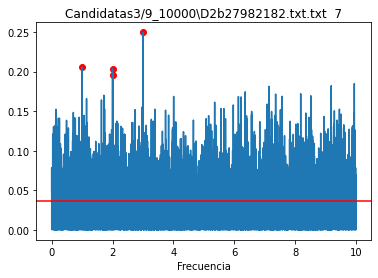

[0.2055641180033872] [0.21250280012117526]
[5.200673639591584] [0.2144462573284079]
[0.25875549436237427] [0.22060287579161422]
[0.1268570193290662] [0.22866819117042494]


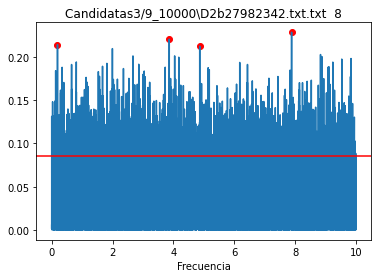

[0.9945206041021224] [0.2092240249976438]
[0.16098546343717454] [0.21242827148999008]
[0.10510004619161692] [0.21292208732843373]
[0.10738990833322687] [0.27889273573894957]


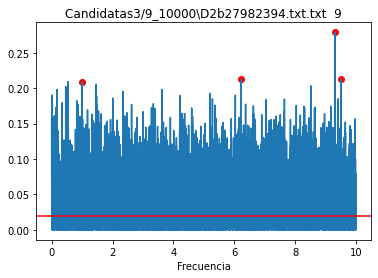

[0.10696607334784276] [0.24209276483194414]
[0.13454185851383932] [0.2538799951761405]
[0.1888173530199824] [0.25510880099811734]
[0.1197784296328838] [0.2776900950013018]


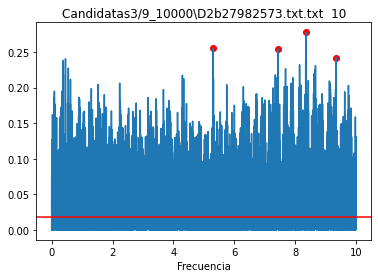

[0.1053935567666619] [0.23235724429975482]
[0.5727236040835075] [0.2388185890336603]
[0.17164801482064976] [0.24286880124812496]
[0.4541528396181176] [0.2647880439011677]


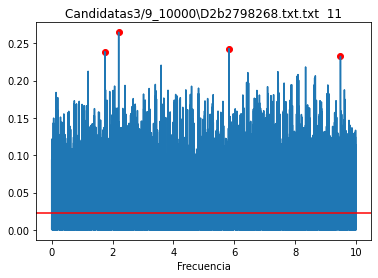

[0.1607215740513478] [0.24389280142587846]
[0.9944217157144228] [0.2649960739908352]
[0.49862390393391864] [0.35716186504527336]
[0.9972974862735838] [0.3653834100356119]


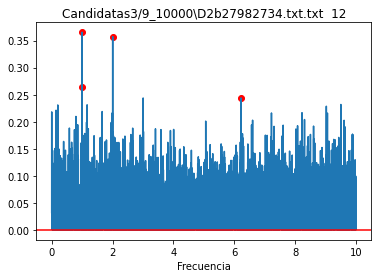

[0.10555373779645938] [0.24075673428510758]
[0.3341318295165641] [0.2550385823292296]
[0.18391444930798193] [0.2654185965069988]
[0.9970986233829006] [0.29094558830810147]


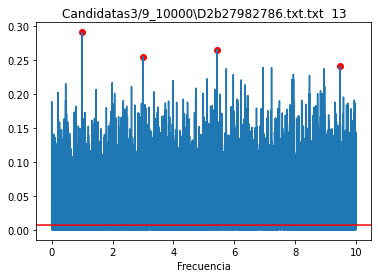

[0.12706493673547614] [0.21421581188573846]
[0.9844373662689992] [0.2164660040027479]
[0.25697363324707334] [0.22014170690378007]
[63.29647542711306] [0.2332303093013506]


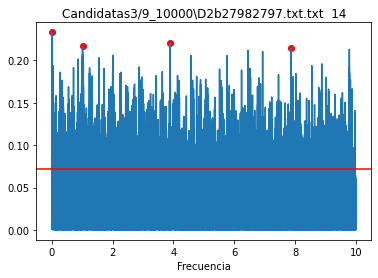

[0.15452326062520907] [0.2704876049846836]
[0.1553296567554295] [0.2710667730670078]
[0.4903844095625622] [0.27491703534919276]
[0.10781014178959694] [0.27787907905700293]


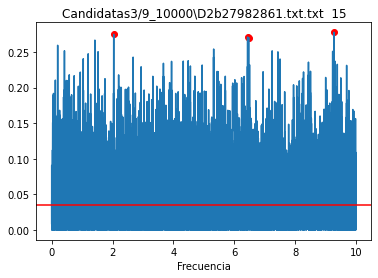

[0.1925434611713782] [0.1484667938322038]
[0.1200271234724777] [0.14950794099586465]
[0.10816461164450698] [0.1561443758051705]
[294.1363335539378] [0.16185464528259497]


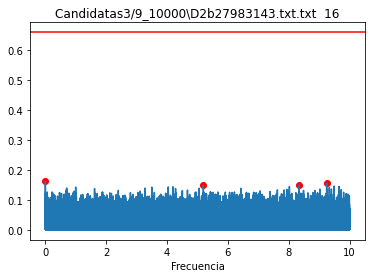

[0.33740089019661385] [0.1891137496197775]
[0.4991963482423558] [0.1914969769804025]
[0.9995901239668085] [0.19151358036806937]
[0.1036115744097185] [0.2163589386459764]


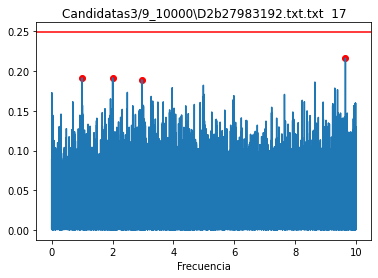

[0.22981593131773734] [0.14819927609054875]
[0.10383964444916961] [0.15448708912955644]
[0.12989025226438186] [0.15877831510370707]
[0.9898940115822321] [0.1654640074979102]


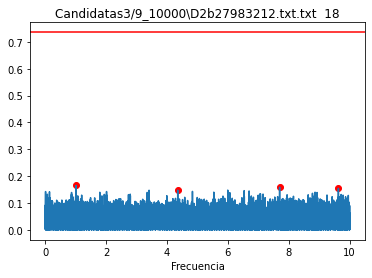

[0.9967011354283704] [0.2335153558130641]
[0.17877265612773086] [0.23840361984091782]
[0.131639287783944] [0.24793730963685143]
[0.15165746623655874] [0.2610440964631677]


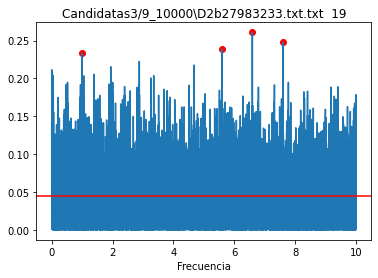

[0.11278786498804297] [0.2381391665423008]
[0.11202854218249185] [0.2469351542116941]
[0.11922297437768338] [0.25136933366244657]
[0.12620546895514706] [0.26171562221055955]


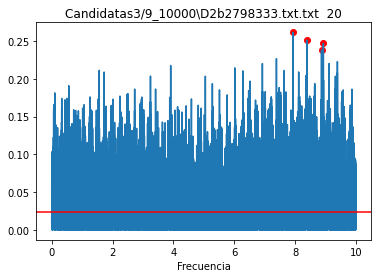

[0.25981087096760014] [0.13313333890399626]
[0.11501897626775814] [0.13340700512741022]
[0.10397567184510617] [0.13966813021522315]
[0.26356999401149805] [0.14316710078510853]


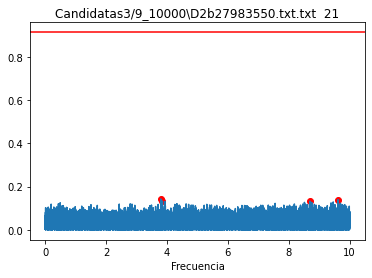

[0.13689174160989517] [0.2052389981015033]
[0.10977936324036984] [0.20577875432790624]
[0.12373982305105073] [0.20591106164567277]
[0.15169887378980007] [0.23221735678151617]


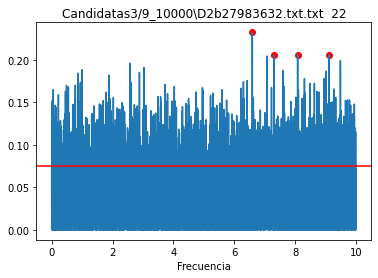

[0.11925709495190652] [0.2429554574003878]
[0.3418292983672921] [0.24494650261688755]
[0.12689404001615143] [0.2538599177096098]
[0.5193653730023586] [0.2585025808679402]


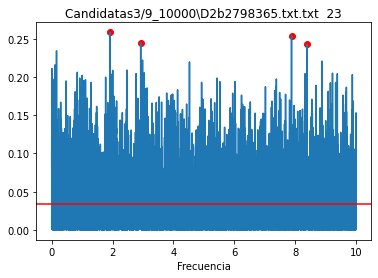

[0.10109680157507563] [0.14071676418701237]
[0.21692984891658953] [0.14135378081782132]
[0.13559990736589533] [0.14592649506262267]
[2.0114437408545025] [0.14703551525753614]


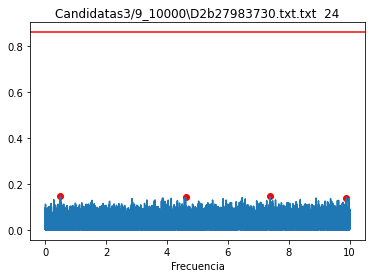

[0.4985493340613025] [0.22298665439647428]
[0.12473216151035595] [0.22378816565094983]
[0.49922126694279073] [0.22941648676809834]
[0.9969992216748045] [0.2857651466628114]


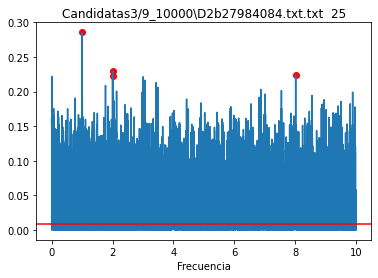

[303.0493126772856] [0.16728720942744488]
[0.9967011354283704] [0.16764541548117576]
[0.1200271234724777] [0.16870447631627458]
[0.12006603015713749] [0.17095644865403978]


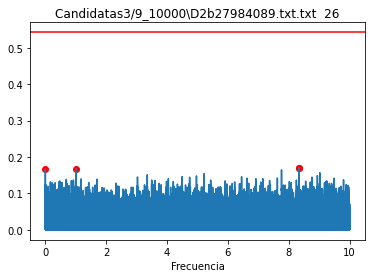

[0.15776280836711687] [0.17736602290289458]
[0.29377257661155715] [0.17922205755464518]
[0.187412625251968] [0.17964983275035223]
[0.1538339658141635] [0.18165660809876322]


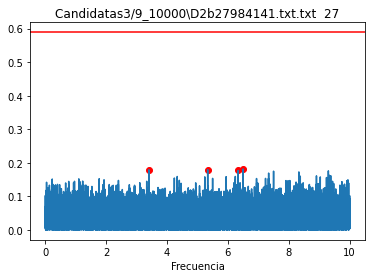

[0.17605668394581706] [0.13356901293154883]
[0.18351285253923913] [0.13577937813249802]
[0.9924480695362121] [0.13578970803534476]
[131.5892322086289] [0.14226620494964035]


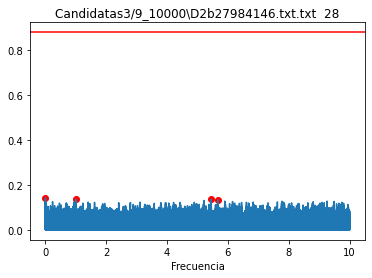

[1.0682438718749587] [0.13019563175328863]
[344.84792054624455] [0.16335134573473922]
[0.9970986233829006] [0.18961025237809664]
[1.0001899379686] [0.19203302833061534]


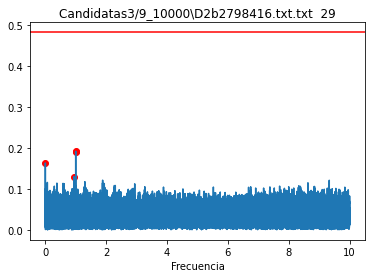

[0.1872126529670678] [0.25976374283213866]
[0.14333892248915836] [0.26495740333466394]
[1.016351542195237] [0.27415646481364375]
[0.11038277290407023] [0.2897975255595862]


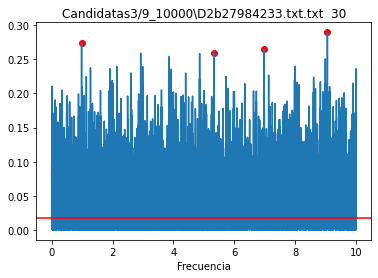

[0.11802143057163364] [0.18342130220273029]
[0.10837324713880632] [0.1849775766239524]
[0.30444139470271975] [0.1872785940695477]
[0.13389519586423274] [0.18776856401156503]


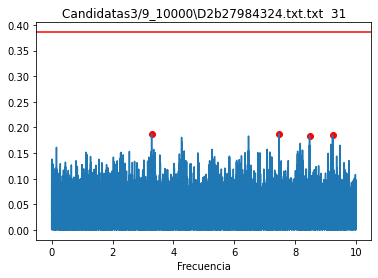

[0.9714326581478554] [0.26588154038768086]
[7.770701706043536] [0.2705336686749892]
[1.1475500926116613] [0.27127993433015984]
[0.9956096758457621] [0.2947703736523765]


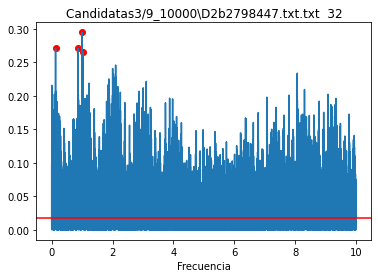

[0.10014519746724855] [0.23296262794059158]
[0.13841118213862677] [0.25228843503721676]
[0.10836972414223865] [0.2630903400114928]
[0.12158261987664973] [0.29332958771589085]


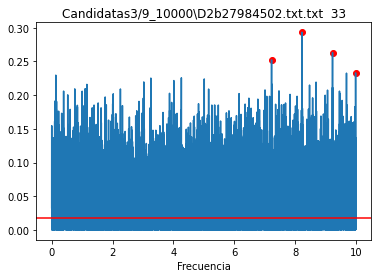

[1.6976571994508092] [0.46327526278964276]
[0.3854208317826253] [0.4855088419980309]
[0.38583718143212997] [0.5587041315871777]
[0.6282366684175799] [0.7229759580673812]


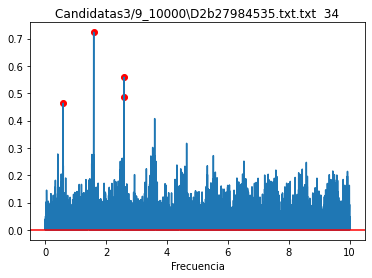

[0.9967011354283704] [0.19472420488519993]
[1.6016813978782154] [0.20158094650509925]
[0.863039291784256] [0.2110922366956991]
[0.10719422911266757] [0.22040939521617167]


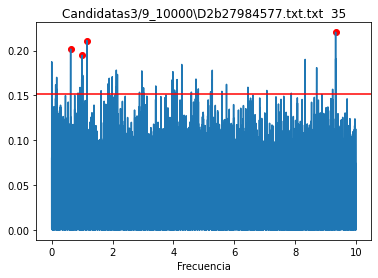

[0.14251371516542685] [0.14430384139081995]
[344.84792054624455] [0.17950880458359303]
[1.0001899379686] [0.1984529580294]
[0.9970986233829006] [0.2760916194232306]


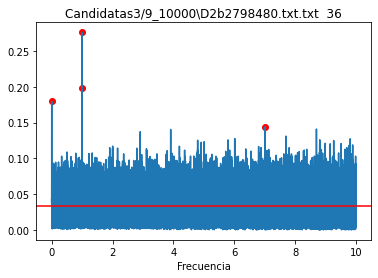

[0.10657281991969257] [0.22738226861196817]
[0.11575651634123939] [0.22859574725870116]
[0.28795312057888556] [0.23132168007491083]
[0.3002912508923807] [0.2347444415772951]


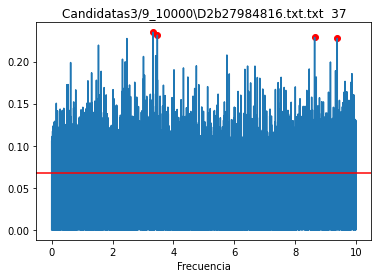

[0.23364404914747045] [0.15086480243161723]
[1.0904916703160334] [0.15377356101538867]
[0.1200271234724777] [0.16863561439658722]
[303.0493126772856] [0.16909652036115258]


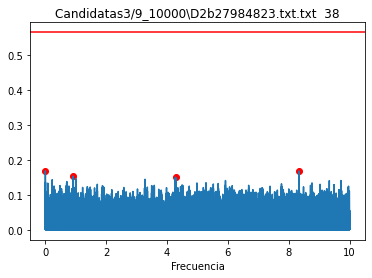

[0.4531034651221049] [0.18412396302217765]
[0.10987222999806756] [0.1845546968298505]
[0.31154480575653826] [0.19855966745889658]
[0.1099060386953533] [0.20247540449550216]


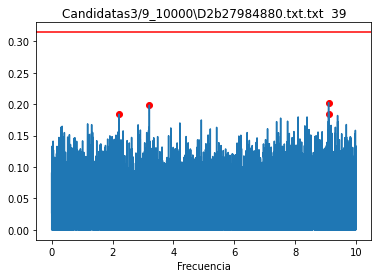

[0.33269793049071583] [0.31076119038012345]
[0.8638593169610316] [0.3120350327312757]
[0.49859904483123857] [0.3378938640493417]
[0.9970986233829006] [0.43075408744749677]


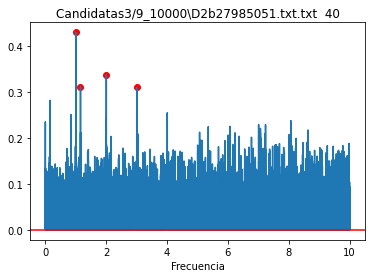

[0.8388608735915711] [0.6288478234732437]
[1.2377350217742664] [0.6423499178099469]
[0.8368953419855953] [0.6629396459944521]
[5.20608818535192] [0.8088379031877412]


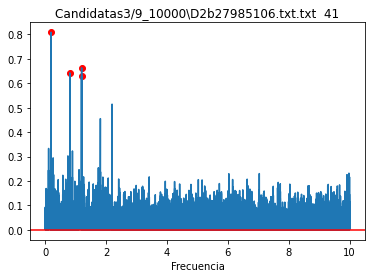

[0.473976287364345] [0.41345586133379264]
[0.321262441401988] [0.4216037065833335]
[0.4733257448991068] [0.4567865084591297]
[0.9009819170310072] [0.5470212939869655]


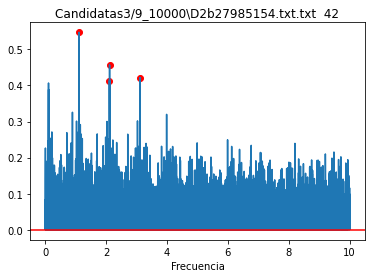

[0.2932299251180342] [0.12741888894595332]
[0.2008333817145788] [0.1285960144236028]
[0.18324385592965967] [0.13672017426454475]
[0.1671664483593112] [0.14937656622446924]


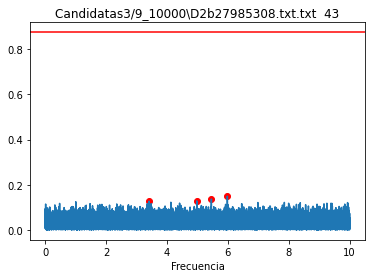

[0.8555821130899213] [0.2913442741851038]
[0.13438457362336453] [0.2914325493028483]
[0.15531518302575448] [0.29157365912897837]
[0.1561762125903609] [0.31499477618667177]


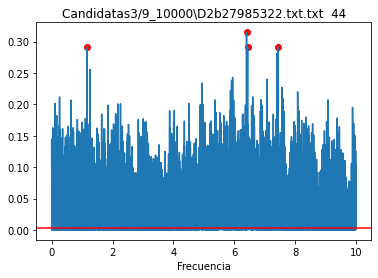

[0.33269793049071583] [0.31076119038012345]
[0.8638593169610316] [0.3120350327312757]
[0.49859904483123857] [0.3378938640493417]
[0.9970986233829006] [0.43075408744749677]


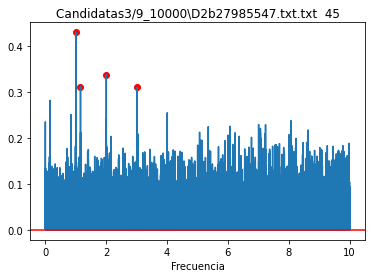

[0.9942239979240397] [0.2847402041921778]
[0.4985493340613025] [0.2982497751377712]
[322.6003135706405] [0.35106848858830403]
[0.9969992216748045] [0.39145557335852577]


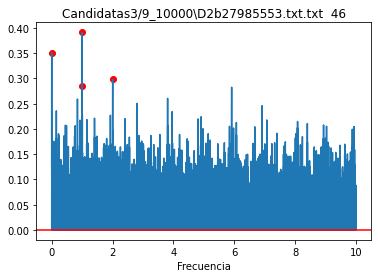

[0.11300068910995345] [0.21117995022837355]
[0.18294552236017933] [0.21692849094036695]
[0.2631538746749507] [0.22037008967472904]
[0.20821327245582766] [0.22371233886100447]


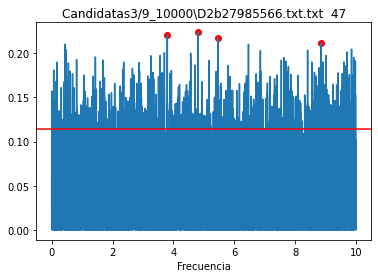

[0.10656487079203633] [0.2647176007467404]
[0.10594734884948197] [0.2662280391434709]
[0.11850109583917706] [0.2870749009466469]
[0.1193154294684305] [0.3149060791901247]


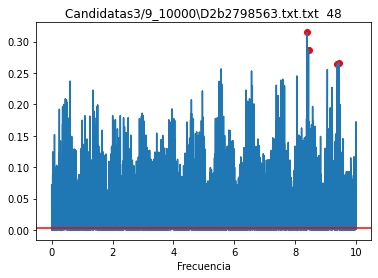

[0.27384720272513335] [0.260918704380677]
[1.131067526797831] [0.28816823303228367]
[0.26863919222653776] [0.2982697796208014]
[0.5299893806555832] [0.3111981695075694]


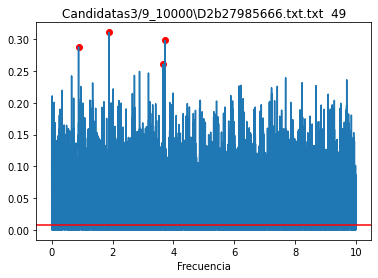

[0.10675939658524435] [0.21033011884828814]
[0.12158261987664973] [0.2116068047351033]
[0.4921218210341043] [0.22121139112125127]
[0.13240963816799162] [0.23030978140857195]


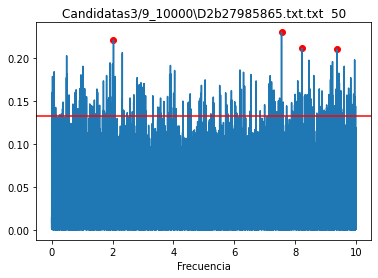

[0.9969992216748045] [0.21537316262358908]
[0.13271889973392315] [0.21693964054673648]
[0.14280063913921198] [0.2350870103018019]
[0.9941251685096293] [0.24702543004861913]


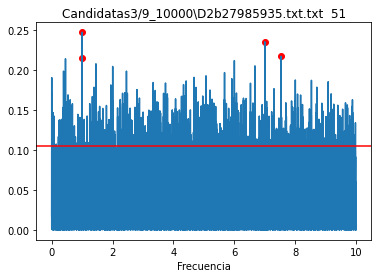

[0.11394050547950157] [0.1547996108167051]
[0.21023986000912784] [0.1570515257864172]
[0.13696110609054613] [0.1575277606694944]
[0.10642312147338716] [0.1596685519030752]


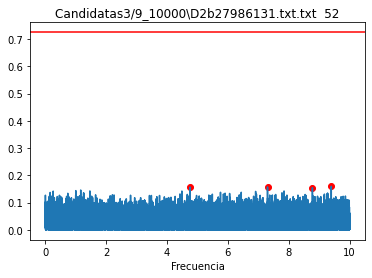

[0.11208755479602028] [0.23238177284892414]
[0.10142386287428017] [0.2379431562660319]
[0.13491757235748647] [0.24710292339321677]
[0.14295168612549478] [0.25050170575825886]


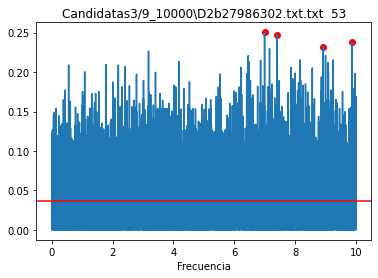

[0.29839180753757955] [0.17586759590415874]
[0.9219967972830179] [0.1771027612490829]
[0.1403713887609426] [0.17724114107440223]
[0.12469639133401943] [0.18622960856066106]


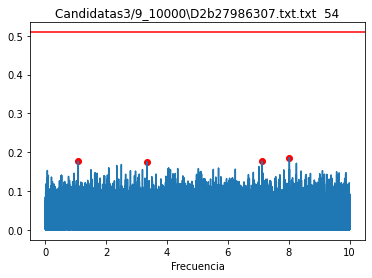

[0.29839180753757955] [0.15590627791612102]
[0.2981516209535732] [0.15603878225687912]
[0.10515087788207073] [0.15794997478782985]
[0.9992904866664286] [0.15855064954252573]


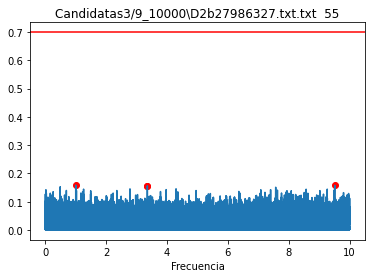

[0.42174755241421347] [0.6223492131102619]
[2.7347272705792474] [0.6451130510694867]
[0.4222283082819184] [0.6982599760359927]
[0.7307927973861678] [0.817330067921526]


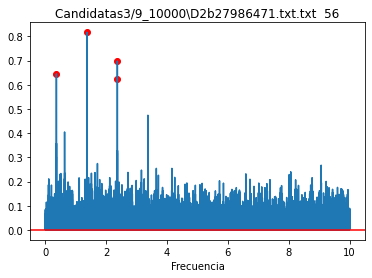

[0.12456127212809533] [0.15981991035978463]
[0.18481169242084936] [0.16878176469747316]
[0.11073109149264317] [0.1707117682477482]
[0.2914524633582663] [0.17711868006751047]


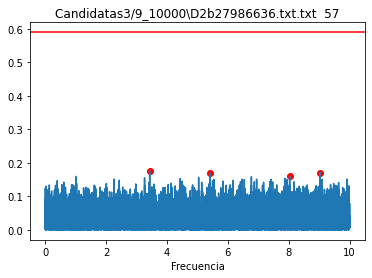

[0.12369390959621716] [0.2158367305774498]
[0.22974202024351617] [0.21724855860610653]
[0.6453442285049436] [0.22844075700301827]
[0.9969992216748045] [0.24706777024716564]


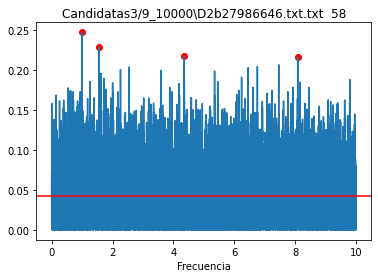

[0.24714327750600024] [0.23706891194115726]
[0.16086893490561832] [0.24281242327350983]
[0.19816711735670353] [0.24976130956444823]
[0.12371533163430648] [0.26286785026625176]


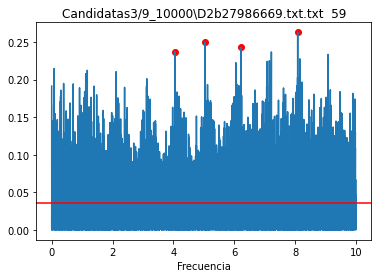

[9.311817233273132] [0.27674333618800256]
[0.17052995833503887] [0.281467073766228]
[0.18711807812572992] [0.2945745184114192]
[0.14895147532005698] [0.30858868356747793]


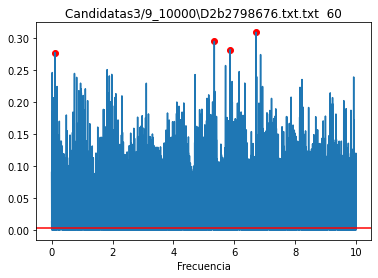

[0.20099483307063445] [0.14497160346788468]
[0.13007608731129366] [0.1506428532877508]
[0.25172795347054255] [0.15330511891741835]
[0.6424835867734771] [0.15987426746387381]


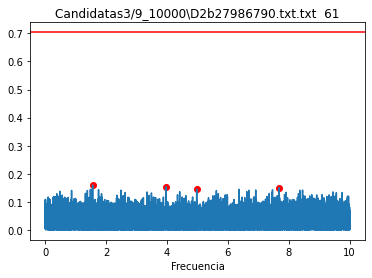

[0.4470075397873321] [0.19031611922149505]
[0.11578734078693542] [0.19071490618021564]
[0.9104141347796391] [0.20916561391759486]
[0.5774858280528801] [0.22413731368616813]


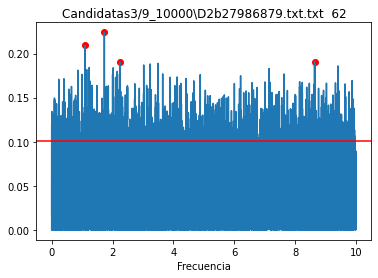

[1.0028980332240776] [0.444838529395364]
[588.2570944515036] [0.45981097824212686]
[370.3913594239616] [0.46213766215826635]
[0.9988912495921861] [0.48302863522387285]


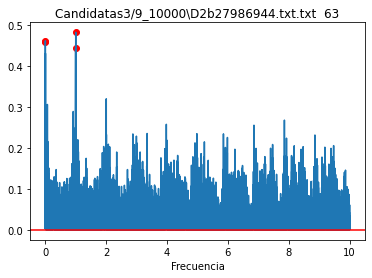

[0.1246202536770826] [0.17553382228109357]
[0.11841270197526477] [0.18585393302140543]
[0.49922126694279073] [0.19266552495247852]
[0.9969992216748045] [0.19746397027314216]


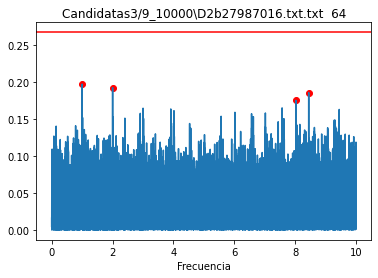

[0.3083937158847605] [0.47263263787463033]
[0.44591134691674034] [0.5102986612937839]
[0.446468736077989] [0.5374151446783809]
[0.8065241422632806] [0.6235091814154656]


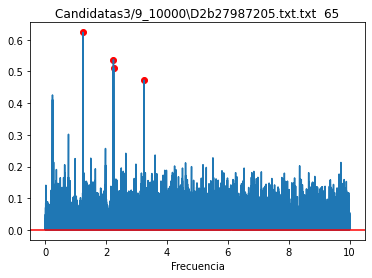

[2.0066007792712055] [0.1393182130813975]
[0.17732092075184772] [0.14428050093065872]
[0.10021946086584294] [0.14848517547939694]
[0.2621261723605444] [0.15453942245351204]


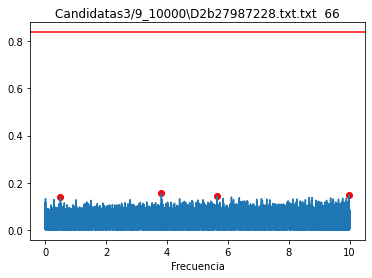

[0.1061937223329202] [0.23784685236316866]
[0.26820692578305694] [0.23841787830896485]
[0.35038012033196775] [0.24050369749915912]
[0.39180802105177337] [0.24254641006871666]


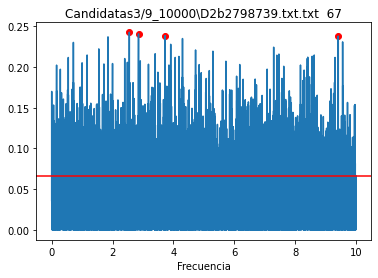

[0.1575937590318379] [0.1971463036512604]
[1.0996040791936619] [0.20181987319962558]
[0.31027859924082696] [0.20298691892998816]
[0.12072258010849345] [0.21954071898771657]


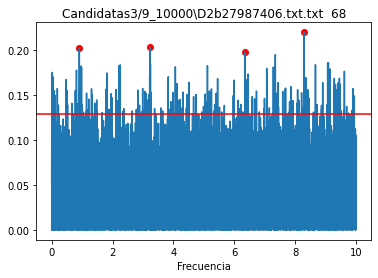

[0.2303134256662641] [0.2010319924412612]
[0.4991714320294376] [0.2191094974798326]
[0.9993903458047102] [0.2295319048910733]
[0.4990966983120595] [0.22970927207484185]


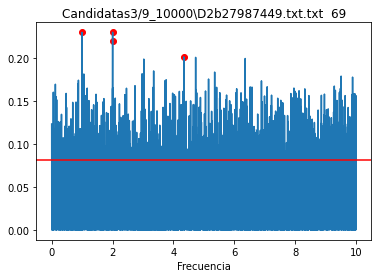

[0.14205823809863352] [0.20651852215631694]
[0.29446455922516834] [0.21425228593527385]
[0.4984996332027944] [0.23275907387591785]
[0.187412625251968] [0.2330328553112214]


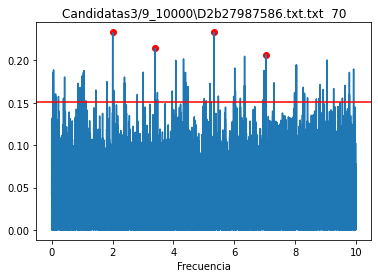

[0.1108255761331561] [0.22728854662003287]
[0.11004632523418395] [0.22927014574824683]
[0.110783835769918] [0.23103225469456015]
[0.20919321232698726] [0.2462080120594864]


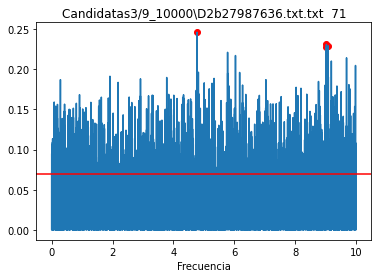

[0.22594776301648536] [0.2142264204362681]
[0.112305308069804] [0.21758453609424339]
[0.5108755430207923] [0.22138145933411274]
[0.11217430305694613] [0.22186757598576515]


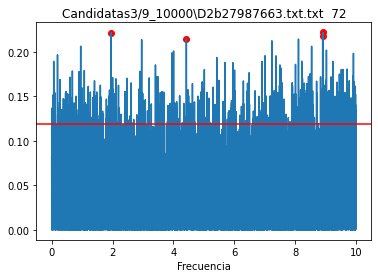

[68.97129661816557] [0.21543279909503965]
[0.16477847431653636] [0.2291037459259163]
[0.16484909327360803] [0.2716895816060505]
[0.19738877970120655] [0.2832539356192951]


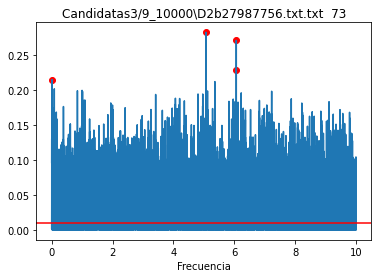

[0.4420873349876495] [0.18613634921714645]
[0.42911266213717414] [0.19017463979684837]
[0.12135100021576908] [0.19343757114359067]
[0.30655038665050455] [0.20163857755800021]


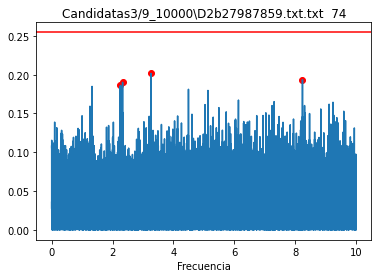

[0.5001700244966721] [0.2035219079781439]
[0.5081499737121227] [0.20629649986868434]
[0.4995204855099947] [0.21437185265566125]
[1.0005902140457974] [0.2343003757556352]


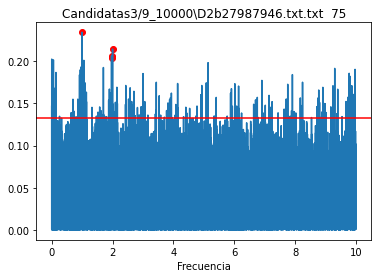

[0.10553591586396778] [0.2471409436969757]
[0.49924618813111504] [0.25210394163269995]
[0.9970986233829006] [0.2705760378458297]
[0.33269793049071583] [0.288496043260521]


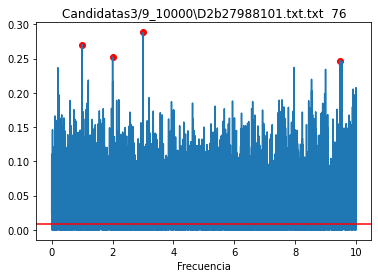

[0.13959548818235806] [0.23576796849129864]
[0.10082568806590188] [0.23592090328150533]
[0.13294295891566021] [0.24912127794356986]
[0.11216549638915635] [0.25464785801600337]


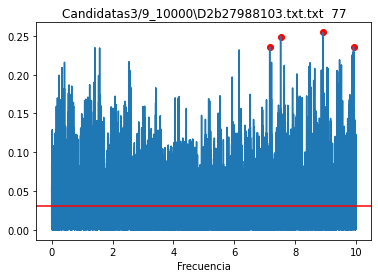

[0.9940263587412592] [0.17336310865790985]
[0.9967011354283704] [0.17785111082215124]
[303.0493126772856] [0.1967469544274479]
[0.12002568296838907] [0.20409038910951272]


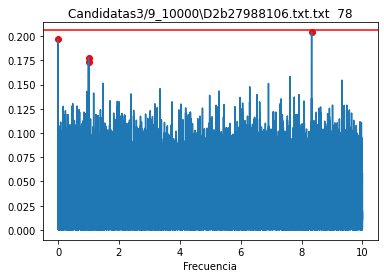

[0.2853323775516171] [0.17628527428217827]
[0.33170480236964583] [0.17632539947730325]
[0.1685298766188693] [0.1944328504640026]
[0.11009599496810471] [0.19728077059334617]


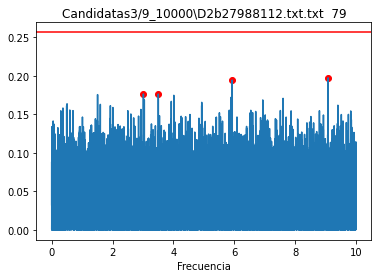

[0.14581334595132991] [0.21307167672171431]
[0.18414133277356753] [0.21642966974405686]
[0.17078331146858122] [0.23819726832092591]
[0.12719098520298702] [0.24719975277525158]


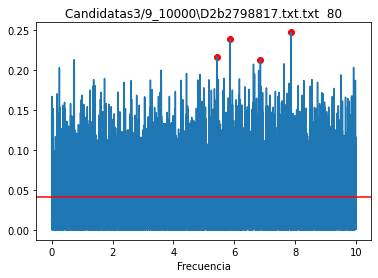

[0.49857418820715665] [0.25871769267629663]
[3.856882614140954] [0.26730348991667513]
[0.5006958866194872] [0.27839102451618225]
[1.0056208330678469] [0.32595090654143494]


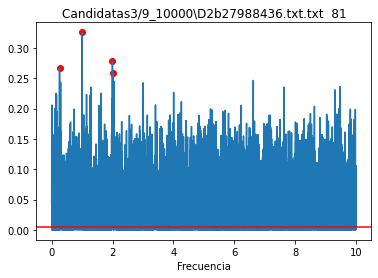

[0.12679590201943955] [0.25677940653912834]
[0.14520784573503215] [0.26249844045375514]
[0.1124935320775089] [0.2733156140189393]
[0.12675251233723692] [0.2778181613973432]


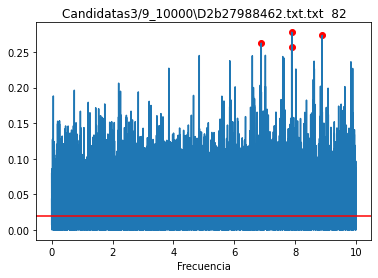

[0.6682859664879038] [0.20721975012560429]
[0.14436729451259406] [0.21904677551787635]
[0.1396715216442336] [0.23618390795718858]
[0.1261131634720344] [0.25251432212857067]


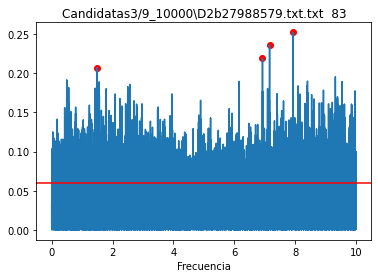

[0.1939813002445568] [0.145534694746674]
[0.3169656378268064] [0.1456402817028874]
[0.1236144069359353] [0.14638174676921703]
[0.24067237506334405] [0.1604494623622174]


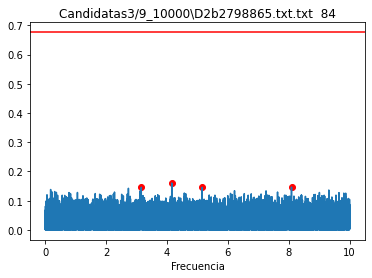

[0.10056815895869642] [0.2299155258409019]
[6.204028849767133] [0.23634140967963718]
[0.11148529629748512] [0.2377961888670891]
[0.11850249998040245] [0.23871024679646483]


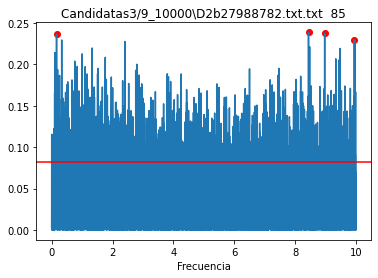

[17.12480252764613] [0.3094107774143241]
[0.9423253784821769] [0.33361916793487256]
[0.11077401907691914] [0.3757041447616128]
[0.48515085152467097] [0.3928645648434156]


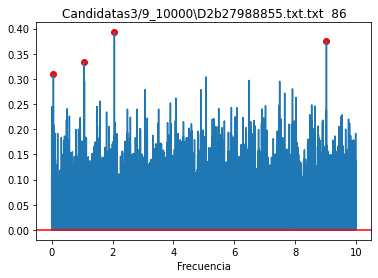

[0.10208124934292832] [0.14971235939927113]
[0.1014866455457652] [0.15300833748649798]
[0.10205416545727444] [0.16550500061543938]
[0.12002568296838907] [0.16997200905763976]


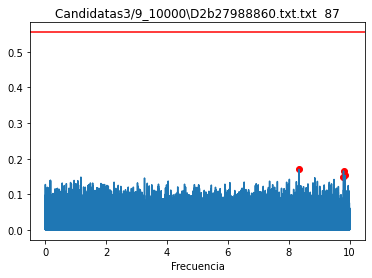

[0.31063518591114686] [0.24148782159325066]
[0.10732882585751662] [0.2556264530597886]
[0.47828310184175804] [0.25617828799044773]
[0.13658513223078197] [0.25914662024257945]


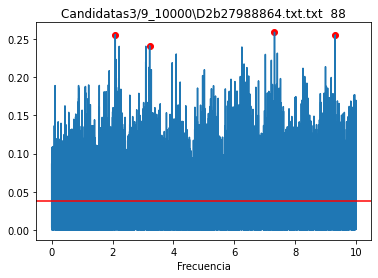

[0.12260362113563285] [0.2121370444828135]
[0.10284970893513859] [0.2126336223850332]
[0.22934161679503065] [0.21386802302918134]
[0.2459701386805808] [0.23679112613122663]


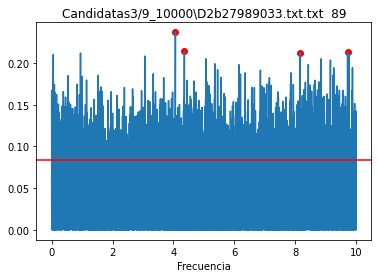

[6.803329228843764] [0.17121934916573014]
[0.11317075917330692] [0.171226379215758]
[1.1721635062067908] [0.17339141501554034]
[1.3890137277460586] [0.17510367506495983]


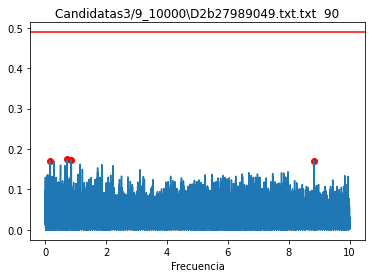

[0.10660690104628663] [0.17490317587261497]
[0.12615611646261246] [0.18249954691538314]
[0.10657622705173601] [0.1868964010975442]
[0.14436937854667137] [0.20261830195009828]


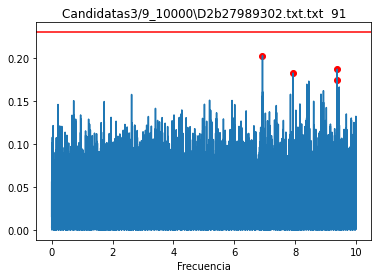

[0.37032140104741196] [0.4239877393151514]
[1.4278838956003672] [0.42503603116138783]
[0.36993784704563293] [0.48929619891858384]
[0.5881152343812028] [0.6757163563038164]


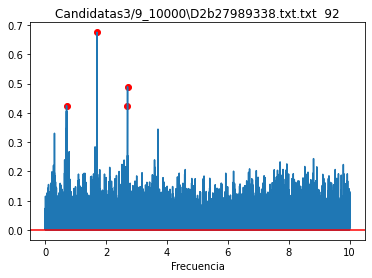

[0.2516772746678612] [0.29197520818436273]
[0.33662862388545356] [0.3333032226981667]
[0.20458850532620607] [0.3336187352164831]
[0.25721155955186065] [0.3386633016097779]


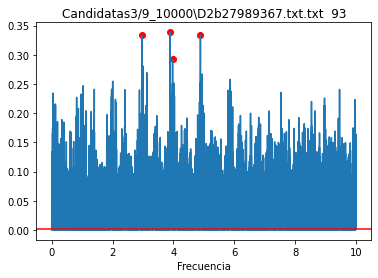

[0.9970986233829006] [0.19003028408886904]
[0.11171443879108992] [0.19544727858124444]
[0.12829561748937035] [0.2000166937317661]
[0.11323482776367147] [0.2146039380772139]


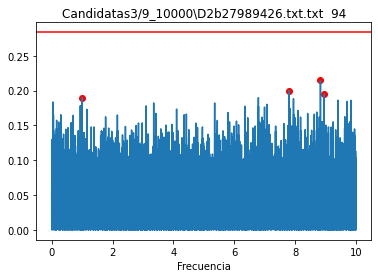

[0.49231562700012915] [0.12072855251032075]
[0.49132398171324954] [0.121147051106586]
[0.9658971625086553] [0.1230854704717829]
[0.329899382915054] [0.1316290824954998]


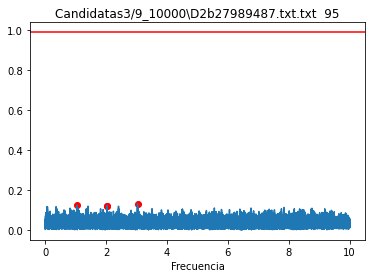

[0.24639434004858252] [0.22711083249048308]
[0.16072932315480284] [0.22763930822318476]
[0.5399762218012958] [0.23256143339306118]
[0.13847250827812857] [0.24628735036217536]


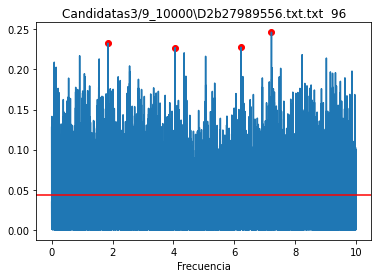

[0.15033973654865618] [0.2480693332518756]
[0.14246702130795547] [0.25277194002331094]
[0.14241427377852778] [0.26932467591254866]
[0.12465908779952385] [0.34901497582535396]


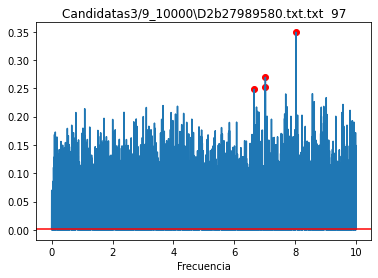

[0.16231011334580772] [0.2233159800995466]
[0.11152134872519988] [0.2242547961089761]
[0.13964226820517733] [0.22838853761137703]
[0.10030389344399002] [0.23707338680594214]


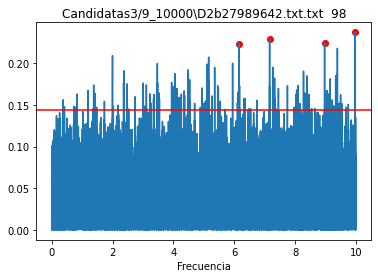

[0.35935680081047555] [0.19553259293858719]
[0.3303352532676314] [0.21079779917747266]
[0.3300409145581965] [0.22744157289580674]
[0.24813665806529556] [0.22930321684471144]


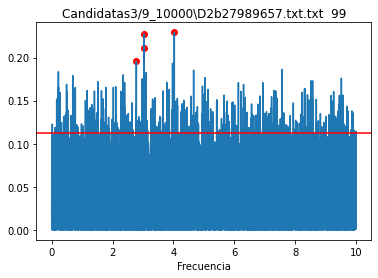

[0.10721606373962664] [0.23046740965755333]
[0.1846717740520318] [0.2306652856810042]
[0.2930580737921338] [0.2459478106004738]
[0.2266390166114507] [0.260196782004643]


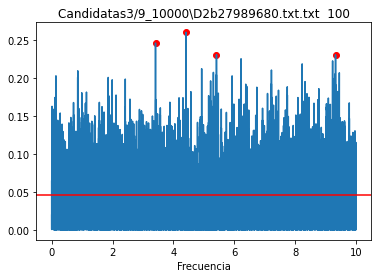

[0.30158619518573865] [0.24657779008609326]
[0.1079637705418418] [0.25216979711277204]
[0.14537882252522058] [0.25645154145697896]
[1.3456537780946556] [0.2602475206846575]


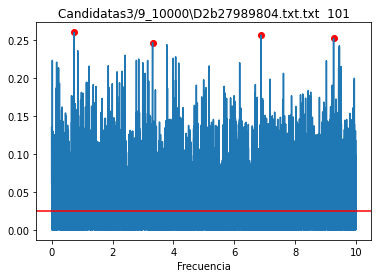

[0.24692970217402144] [0.2658729866720155]
[0.10618019274681775] [0.2712528094184631]
[0.5428780589170494] [0.28029623294938955]
[0.10205312405636911] [0.3023592127828947]


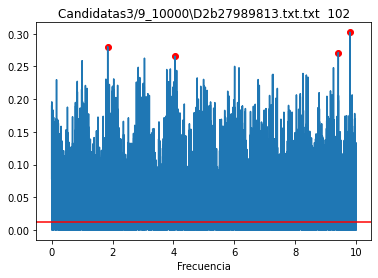

[0.10054086115061854] [0.17805962271242995]
[0.10738990833322687] [0.18015973039708252]
[0.41526801960845433] [0.18071037328854922]
[0.33269793049071583] [0.18579631895314164]


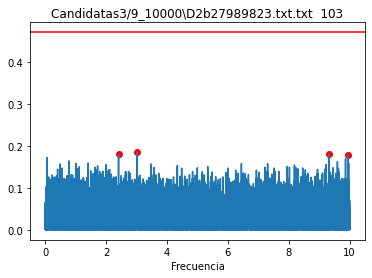

[6.456355247713458] [0.25163229177179225]
[0.49859904483123857] [0.28143055004682893]
[0.8638593169610316] [0.2977470866127193]
[0.9970986233829006] [0.3659979085219539]


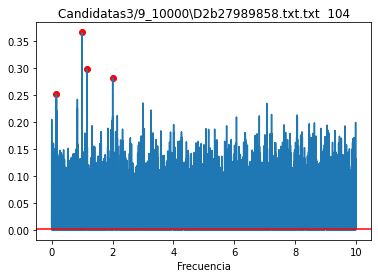

[1.0874088410615599] [0.16914306895831738]
[0.5209073191908707] [0.17180830674902572]
[1.090610589788583] [0.17218972792117967]
[0.21157417968590822] [0.17490328616674394]


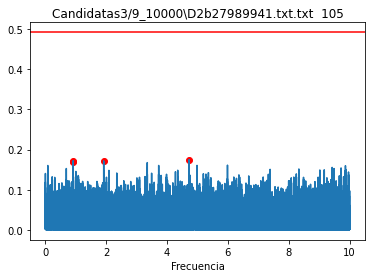

[0.41432180450253064] [0.3898343475623151]
[2.434493159383162] [0.4130942332251853]
[2.4512004616931264] [0.423219297983995]
[0.708831203628685] [0.5621278047758932]


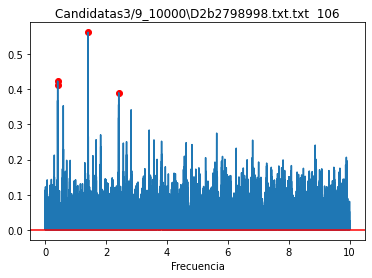

[0.12373982305105073] [0.19693547361124097]
[0.13845333802262863] [0.20115310005370918]
[0.14121376375515599] [0.20592047975296546]
[7.037926639860344] [0.21196340255219728]


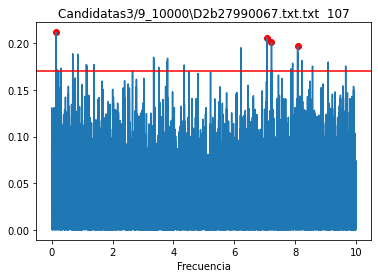

[0.2861324053691944] [0.174859439477943]
[1.0675596850031164] [0.17788672337952224]
[0.1259575054677755] [0.17962227162462904]
[0.34843912537044197] [0.18258443031873242]


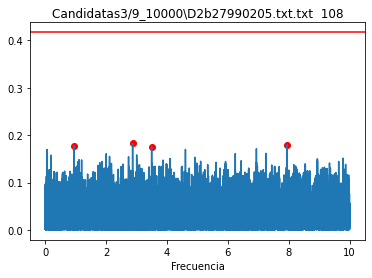

[0.27723290570700315] [0.15238058056741055]
[0.10380623192973001] [0.1526314262910838]
[0.1042020921503057] [0.15266465146551378]
[0.10109680157507563] [0.154348330853014]


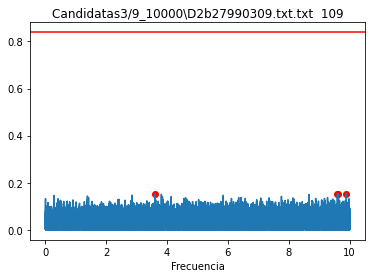

[0.1358965644049606] [0.1729652394528851]
[0.15726910959809792] [0.17558167713258596]
[0.25172795347054255] [0.19279675515669534]
[0.33269793049071583] [0.20526189703202838]


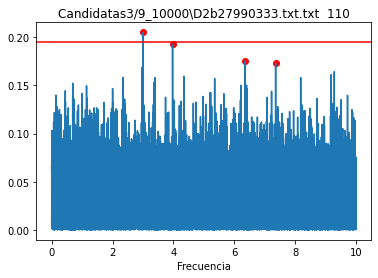

[0.13050893869945462] [0.6132092310643915]
[0.17660697766205452] [0.6146777318845635]
[0.17669434507010928] [0.6439797411088272]
[0.15009830486585443] [0.8421495506477507]


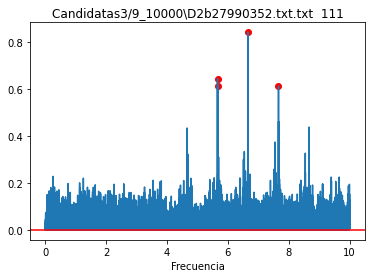

[0.17058813387344055] [0.6309979283276992]
[0.25911752142138844] [0.6517071000186107]
[0.2593056382651573] [0.6691708953532252]
[0.20578830208611476] [0.8846812227941848]


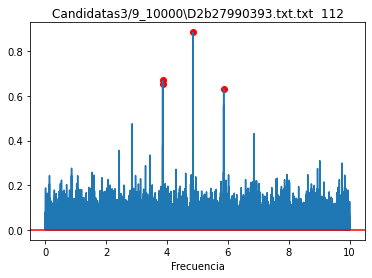

[0.10659781061470894] [0.2631604305511708]
[0.19815141193269192] [0.2745557786130302]
[0.10656487079203633] [0.3084106407760247]
[0.1193154294684305] [0.3150067815749348]


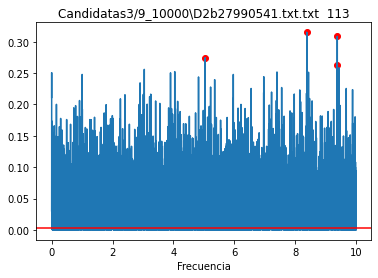

[0.2426813848962366] [0.17472141287595733]
[0.10642765161079223] [0.1801828185682876]
[303.0493126772856] [0.1808575739815753]
[0.11910370596899945] [0.1968955365960972]


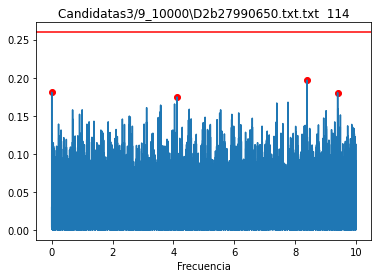

[16, 17, 18, 21, 24, 26, 27, 28, 29, 31, 38, 39, 43, 52, 54, 55, 57, 61, 64, 66, 74, 78, 79, 84, 87, 90, 91, 94, 95, 103, 105, 108, 109, 110, 114]


In [330]:
periodos=[]
poderes=[]
pre=[]
lombs=[]
for i in range(len(Tiempos)):
    frequency=np.linspace(1/(1000),1/(0.1), 100000) 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    power= LombScargle(t, y).power(frequency)
    fap=LombScargle(Tiempos[i], Intensidad[i], Error[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[i][1])
    powerpeaks=lombs[i][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    pod=[]
    for j in range(4):
        indice1=np.where(lombs[i][1]==pp[j])[0]
        plt.scatter(lombs[i][0][indice1],lombs[i][1][indice1],c="r")
        Periodo1=1/lombs[i][0][indice1]
        poder1= lombs[i][1][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        poder1= sorted(poder1, reverse=True)
        print(Periodo1, poder1)
        per.append(Periodo1)
        pod.append(poder1)

    periodos.append(per)
    poderes.append(pod)
    plt.plot(lombs[i][0],lombs[i][1])
    plt.axhline(lombs[i][2], c="r")
    plt.xlabel("Frecuencia")
    plt.title(archivos[i]+ "  "+ str(i))
    plt.show()

eliminar=[]
for i in range(len(Tiempos)):
    if poderes[i][0][0]<lombs[i][2]:
        eliminar.append(i)

mask = np.ones(len(Tiempos), dtype=bool)
mask[eliminar] = False
Tiempos = [Tiempos[i] for i in range(len(Tiempos)) if mask[i]]

mask = np.ones(len(Intensidad), dtype=bool)
mask[eliminar] = False
Intensidad = [Intensidad[i] for i in range(len(Intensidad)) if mask[i]]

mask = np.ones(len(archivos), dtype=bool)
mask[eliminar] = False
archivos = [archivos[i] for i in range(len(archivos)) if mask[i]]

print(eliminar)

In [331]:
len(archivos)

80

In [ ]:
for i in range(len(Tiempos)):
    for j in range(4):
        for g in range(5):
            peri=periodos[i][j][0]
            T,I=Fases(Intensidad[i],peri*multiplos[g],Tiempos[i])  

            plt.scatter(T,I,c=colores[j], label=peri*multiplos[g],marker=".")
            plt.scatter(T-1,I,c=colores[j],marker=".")
            plt.scatter(T+1,I,c=colores[j],marker=".")
            plt.title(archivos[i] + "  "+ str(i))
            plt.gca().invert_yaxis()
            plt.xlabel('Phase')
            plt.ylabel('Magnitud')
            plt.legend()
            plt.show()

[0.17058813387344055] [0.6309979283276992]
[0.25911752142138844] [0.6517071000186107]
[0.2593056382651573] [0.6691708953532252]
[0.20578830208611476] [0.8846812227941848]


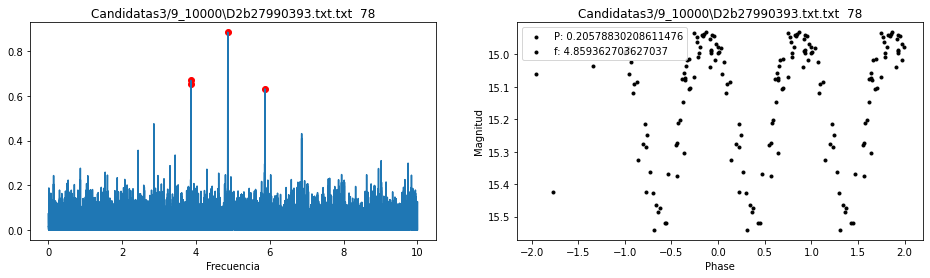

In [64]:
#[4, 24, 29, 30, 40, 46, 65, 75, 77, 78]
estrella=78
frecuencia_menor=1/1000
frecuencia_mayor=1/0.1
periodo=3
multiplo=1
can=evaluar_estrella(estrella,frecuencia_menor,frecuencia_mayor,periodo,multiplo)
#candidatas.append(can)

In [818]:
candidatas_9=candidatas
candidatas_9

[('Candidatas3/9_10000\\D2b27982072.txt.txt', 0.5591615624024953),
 ('Candidatas3/9_10000\\D2b27984535.txt.txt', 0.6282192632799027),
 ('Candidatas3/9_10000\\D2b27985106.txt.txt', 10.41198556467886),
 ('Candidatas3/9_10000\\D2b27985154.txt.txt', 1.802026895069853),
 ('Candidatas3/9_10000\\D2b27986471.txt.txt', 0.7307923647950266),
 ('Candidatas3/9_10000\\D2b27987205.txt.txt', 1.613095238095238),
 ('Candidatas3/9_10000\\D2b27989338.txt.txt', 0.5881071719592872),
 ('Candidatas3/9_10000\\D2b2798998.txt.txt', 0.7088407904413736),
 ('Candidatas3/9_10000\\D2b27990352.txt.txt', 0.1500983904788637),
 ('Candidatas3/9_10000\\D2b27990393.txt.txt', 0.20579101713227352)]

In [819]:
len(candidatas_3),len(candidatas_6),len(candidatas_9)

(7, 13, 10)

In [824]:
type(candidatas_9[0][0]), type(archivos[0])

(str, str)

In [332]:
list_of_strings=archivos
list_of_tuples = [('Candidatas3/9_10000\\D2b27982072.txt.txt', 0.5591615624024953),
 ('Candidatas3/9_10000\\D2b27984535.txt.txt', 0.6282192632799027),
 ('Candidatas3/9_10000\\D2b27985106.txt.txt', 10.41198556467886),
 ('Candidatas3/9_10000\\D2b27985154.txt.txt', 1.802026895069853),
 ('Candidatas3/9_10000\\D2b27986471.txt.txt', 0.7307923647950266),
 ('Candidatas3/9_10000\\D2b27987205.txt.txt', 1.613095238095238),
 ('Candidatas3/9_10000\\D2b27989338.txt.txt', 0.5881071719592872),
 ('Candidatas3/9_10000\\D2b2798998.txt.txt', 0.7088407904413736),
 ('Candidatas3/9_10000\\D2b27990352.txt.txt', 0.1500983904788637),
 ('Candidatas3/9_10000\\D2b27990393.txt.txt', 0.20579101713227352)]

result = find_matching_indices(list_of_strings, list_of_tuples)
print("Indices of matching strings:", result)


Indices of matching strings: [4, 24, 29, 30, 40, 46, 65, 75, 77, 78]


In [12]:
def evaluar_candidata(i,f_men,f_max,p):
    fig,ax = plt.subplots(ncols=2, figsize=(16,4))

    periodos=[]
    poderes=[]
    pre=[]
    lombs=[]
    frequency=np.linspace(f_men,f_max, 100000) 
    t=list(Tiempos[i])
    y=list(Intensidad[i])
    ls = LombScargle(t, y)
    power= LombScargle(t, y).power(frequency)
    fap=LombScargle(Tiempos[i], Intensidad[i]).false_alarm_probability(power.max())
    lombs.append([frequency,power,fap])

    peaks, _ = find_peaks(lombs[0][1])
    powerpeaks=lombs[0][1][peaks]
    pp=np.sort(powerpeaks)[-4:]
    per=[]
    pod=[]
    for j in range(4):
        indice1=np.where(lombs[0][1]==pp[j])[0]
        plt.sca(ax[0])
        plt.scatter(lombs[0][0][indice1],lombs[0][1][indice1],c="r")
        Periodo1=1/lombs[0][0][indice1]
        poder1= lombs[0][1][indice1]
        Periodo1= sorted(Periodo1, reverse=True)
        poder1= sorted(poder1, reverse=True)
        print(Periodo1, poder1)
        per.append(Periodo1)
        pod.append(poder1)

    periodos.append(per)
    poderes.append(pod)
    plt.plot(frequency,power)
    #plt.axhline(lombs[0][2], c="r")
    plt.xlabel("Frecuencia")
    plt.title(archivos[i]+ "  "+ str(i))

    #peri=periodos[0][p][0]
    T,I=Fases(Intensidad[i],p,Tiempos[i])  
    plt.sca(ax[1])
    plt.scatter(T,I,c=colores[j], label="P: "+str(p),marker=".")
    plt.scatter(T-1,I,c=colores[j],marker=".",label="f: "+str(1/(p)))
    plt.scatter(T+1,I,c=colores[j],marker=".")
    plt.title(archivos[i] + "  "+ str(i))
    plt.gca().invert_yaxis()
    plt.xlabel('Phase')
    plt.ylabel('Magnitud')
    plt.legend()
    plt.show()



[0.17058813387344055] [0.6309979283276992]
[0.25911752142138844] [0.6517071000186107]
[0.2593056382651573] [0.6691708953532252]
[0.20578830208611476] [0.8846812227941848]


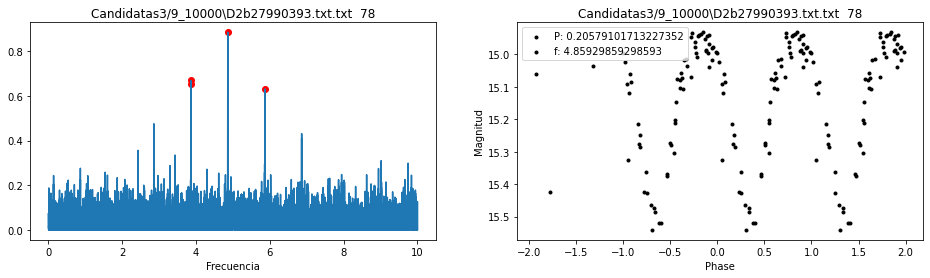

In [22]:
evaluar_candidata(78,1/1000,1/0.1,0.20579101713227352)

In [333]:
len(result),len(list_of_tuples)

(10, 10)

In [334]:
for i in range(len(list_of_tuples)):
    dat=np.loadtxt(archivos[result[i]])
    export_csv(dat, list_of_tuples[i][0])